# Use the v3.1 recalibrated SDSS Stripe82 catalog 
# and Gaia DR2 catalog to produce v3.2 catalog

### 1) use Gaia's BP-RP color to generate Gaia's u-r, g-r, r-i and r-z colors and  compare them to SDSS colors

### 2) derive u-r, g-r, r-i, r-z corrections and store to ZP*dat files

### 3) read ZP*dat files and apply u-r, g-r, r-i, r-z corrections, produce v3.1 version 
 

In [1]:
%matplotlib inline
from astropy.table import Table
from astropy.coordinates import SkyCoord
from astropy import units as u
from astropy.table import hstack
import matplotlib.pyplot as plt 
import numpy as np
from astroML.plotting import hist
# for astroML installation see https://www.astroml.org/user_guide/installation.html

In [2]:
## automatically reload any modules read below that might have changed (e.g. plots)
%load_ext autoreload
%autoreload 2
# importing ZI tools: 
import ZItools as zit
# importing Karun's tools: 
import KTtools as ktt

<a id='dataTools'></a>

### Helper Tools

In [3]:
# both new and old files use identical data structure
colnamesSDSS = ['calib_fla', 'ra', 'dec', 'raRMS', 'decRMS', 'nEpochs', 'AR_val', 
                'u_Nobs', 'u_mMed', 'u_mMean', 'u_mErr', 'u_rms_scatt', 'u_chi2',
                'g_Nobs', 'g_mMed', 'g_mMean', 'g_mErr', 'g_rms_scatt', 'g_chi2',
                'r_Nobs', 'r_mMed', 'r_mMean', 'r_mErr', 'r_rms_scatt', 'r_chi2',
                'i_Nobs', 'i_mMed', 'i_mMean', 'i_mErr', 'i_rms_scatt', 'i_chi2',
                'z_Nobs', 'z_mMed', 'z_mMean', 'z_mErr', 'z_rms_scatt', 'z_chi2']

### code for generating new quantities, such as dra, ddec, colors, differences in mags, etc
def derivedColumns(matches):
    matches['dra'] = (matches['ra']-matches['raG'])*3600
    matches['ddec'] = (matches['dec']-matches['decG'])*3600
    ra = matches['ra'] 
    matches['raW'] = np.where(ra > 180, ra-360, ra) 
    matches['gr'] = matches['g_mMed_new'] - matches['r_mMed_new']
    matches['ri'] = matches['r_mMed_new'] - matches['i_mMed_new']
    matches['gi'] = matches['g_mMed_new'] - matches['i_mMed_new']
    matches['iz'] = matches['i_mMed_new'] - matches['z_mMed_new']
    matches['ur'] = matches['u_mMed_new'] - matches['r_mMed_new']    
    matches['rz'] = matches['r_mMed_new'] - matches['z_mMed_new']    
    # Gaia 
    matches['draGold'] = -3600*(matches['ra_old'] - matches['raG']) 
    matches['draGnew'] = -3600*(matches['ra_new'] - matches['raG']) 
    matches['ddecGold'] = -3600*(matches['dec_old'] - matches['decG']) 
    matches['ddecGnew'] = -3600*(matches['dec_new'] - matches['decG']) 
    # photometric
    matches['gGr_old'] = matches['r_mMed_old'] - matches['Gmag']
    matches['gGr_new'] = matches['r_mMed_new'] - matches['Gmag']
    return

In [4]:
def doOneColorGaiaBR(d, kw):
    print('=========== WORKING ON:', kw['Ystr'], '===================')
    xVec = d[kw['Xstr']]
    yVec = d[kw['Ystr']]
    # 
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 52, 0)
    fig,ax = plt.subplots(1,1,figsize=(8,6))
    ax.scatter(xVec, yVec, s=0.01, c='blue')
    ax.scatter(xBin, medianBin, s=5.2, c='yellow')
    ax.set_xlim(0.4,3.2)
    ax.set_ylim(-0.5,4.5)
    ax.set_xlabel(kw['Xstr'])
    ax.set_ylabel(kw['Ystr'])
    d['colorfit'] = np.interp(xVec, xBin, medianBin)
    d['colorresid'] = d[kw['Ystr']] - d['colorfit'] 
    goodC = d[np.abs(d['colorresid'])<0.3]
    
    ### plots 
    # RA
    print(' stats for RA binning medians:')
    plotNameRoot = kw['plotNameRoot'] + kw['Ystr']
    plotName = plotNameRoot + '_RA.png'
    Ylabel =kw['Ystr'] + ' residuals'
    kwOC = {"Xstr":'raW', "Xmin":-52, "Xmax":60.5, "Xlabel":'R.A. (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-51.5, "XmaxBin":58, "nBin":56, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_RA_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)  
    print('made plot', plotName)

    # Dec
    print('-----------')
    print(' stats for Dec binning medians:')
    plotName = plotNameRoot + '_Dec.png'
    kwOC = {"Xstr":'dec', "Xmin":-1.3, "Xmax":1.3, "Xlabel":'Declination (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-1.26, "XmaxBin":1.26, "nBin":52, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_Dec_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)

    # r SDSS
    print('-----------')
    print(' stats for SDSS r binning medians:')
    plotName = plotNameRoot + '_rmag.png'    
    kwOC = {"Xstr":'r_mMed_new', "Xmin":14.3, "Xmax":22.2, "Xlabel":'SDSS r (mag)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":14.5, "XmaxBin":21.5, "nBin":55, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_rmag_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)
    print('------------------------------------------------------------------')
    
    # Gaia G
    print('-----------')
    print(' stats for SDSS r binning medians:')
    plotName = plotNameRoot + '_Gmag.png'    
    kwOC = {"Xstr":'Gmag', "Xmin":14.3, "Xmax":22.2, "Xlabel":'Gaia G (mag)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":14.5, "XmaxBin":21.5, "nBin":55, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_Gmag_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)
    print('------------------------------------------------------------------')
    

<a id='dataReading'></a>

### Define paths and catalogs 

In [5]:
ZIdataDir = "/Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data"
# the original SDSS catalog from 2007
sdssOldCat = ZIdataDir + "/" + "stripe82calibStars_v2.6.dat"
# Karun's new catalog from 2020, after Gmag-based gray corrections 
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v3.1_noheader_final.dat"
# Gaia DR2 with BP and RP data
GaiaDR2CatBR = ZIdataDir + "/" + "Stripe82_GaiaDR2_BPRP.dat" 

In [6]:
%%time
# old
sdssOld = Table.read(sdssOldCat, format='ascii', names=colnamesSDSS) 
np.size(sdssOld)

CPU times: user 22.7 s, sys: 4 s, total: 26.7 s
Wall time: 26 s


1006849

In [7]:
%%time
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

CPU times: user 47.3 s, sys: 7.08 s, total: 54.3 s
Wall time: 53.7 s


991472

In [8]:
sdssOld_coords = SkyCoord(ra = sdssOld['ra']*u.degree, dec= sdssOld['dec']*u.degree) 
sdssNew_coords = SkyCoord(ra = sdssNew['ra']*u.degree, dec= sdssNew['dec']*u.degree) 
# this is matching sdssNew to sdssOld, so that indices are into sdssNew catalog
# makes sense in this case since the sdssOld catalog is (a little bit) bigger 
# than sdssNew (1006849 vs 1005470)
idx, d2d, d3d = sdssNew_coords.match_to_catalog_sky(sdssOld_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
new_old = hstack([sdssNew, sdssOld[idx]], table_names = ['new', 'old'])
new_old['sep_2d_arcsec'] = d2d.arcsec
# good matches between the old and new catalogs
MAX_DISTANCE_ARCSEC = 0.5
sdss = new_old[(new_old['sep_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]
print(np.size(sdss))

991472


In [9]:
colnamesGaia = ['ra', 'dec', 'nObs', 'Gmag', 'flux', 'fluxErr', 'pmra', 'pmdec']
colnamesGaia = colnamesGaia + ['BPmag', 'BPeI', 'RPmag', 'RPeI', 'BRef']
gaia = Table.read(GaiaDR2CatBR, format='ascii', names=colnamesGaia)
gaia['raG'] = gaia['ra']
gaia['decG'] = gaia['dec']    
gaia['BR'] = gaia['BPmag'] - gaia['RPmag'] 

In [10]:
sdss_coords = SkyCoord(ra = sdss['ra_old']*u.degree, dec= sdss['dec_old']*u.degree) 
gaia_coords = SkyCoord(ra = gaia['raG']*u.degree, dec= gaia['decG']*u.degree) 

# this is matching gaia to sdss, so that indices are into sdss catalog
# makes sense in this case since the sdss catalog is bigger than gaia
idxG, d2dG, d3dG = gaia_coords.match_to_catalog_sky(sdss_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
gaia_sdss = hstack([gaia, sdss[idxG]], table_names = ['gaia', 'sdss'])
gaia_sdss['sepSG_2d_arcsec'] = d2dG.arcsec
derivedColumns(gaia_sdss)

In [11]:
derivedColumns(gaia_sdss)

In [12]:
MAX_DISTANCE_ARCSEC = 0.5
matches = gaia_sdss[(gaia_sdss['sepSG_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]

In [13]:
matchesBlue = matches[(matches['gi']>0.4)&(matches['gi']<2.0)&(matches['Gmag']<20.0)]
print(np.size(matches), np.size(matchesBlue))

885408 392249


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.014740221405029397 std.dev: 0.014662044904696846
saved plot as: colorResidGaiaColors_ur_RA.png


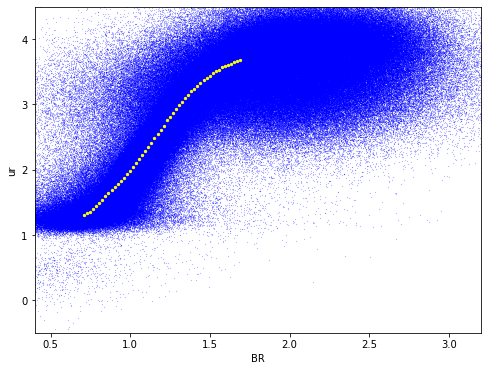

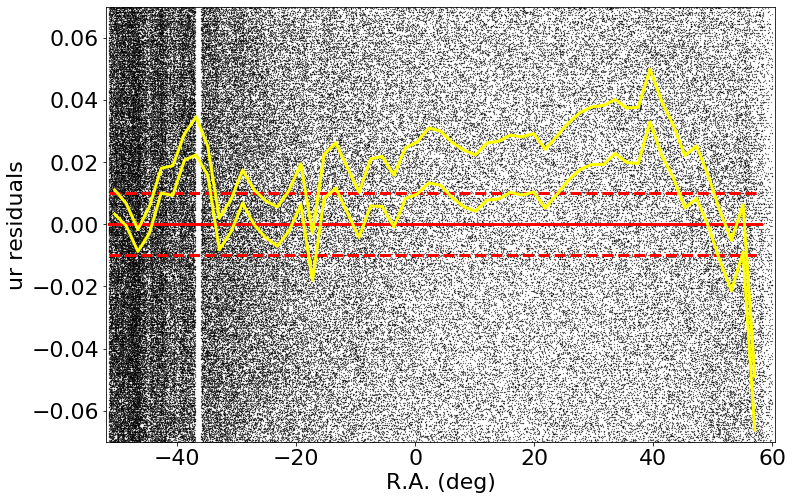

medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.014673167419433142 std.dev: 0.014703327457826347
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


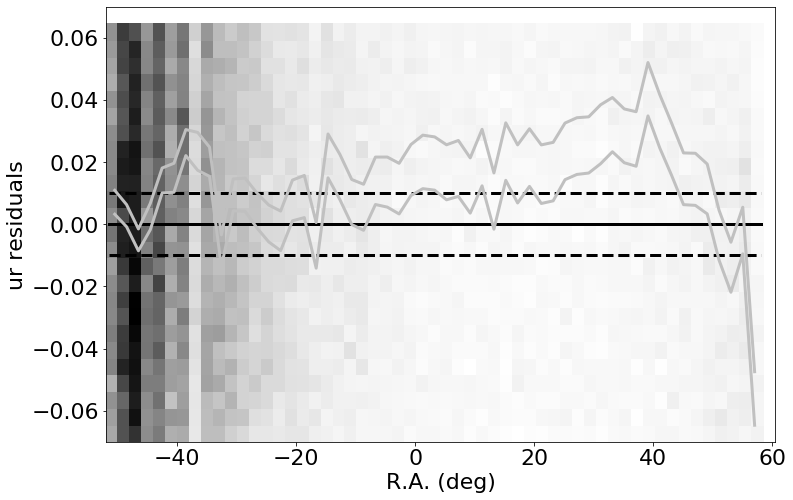

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.010742392349244123 std.dev: 0.011760074007902955
saved plot as: colorResidGaiaColors_ur_Dec.png


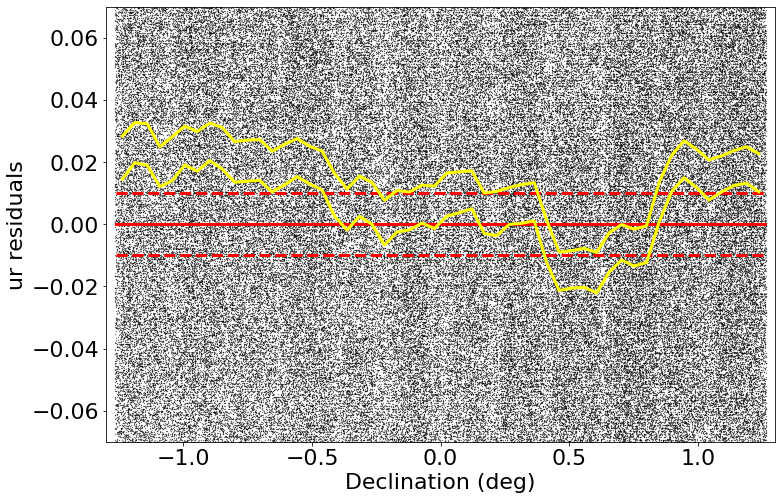

medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.010981359863282303 std.dev: 0.011849407881996284
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


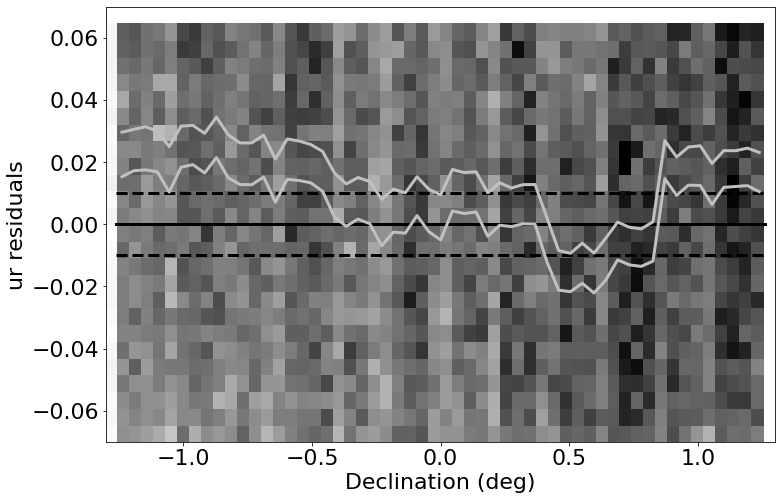

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.0006497711181654431 std.dev: 0.05687945617938841
saved plot as: colorResidGaiaColors_ur_rmag.png


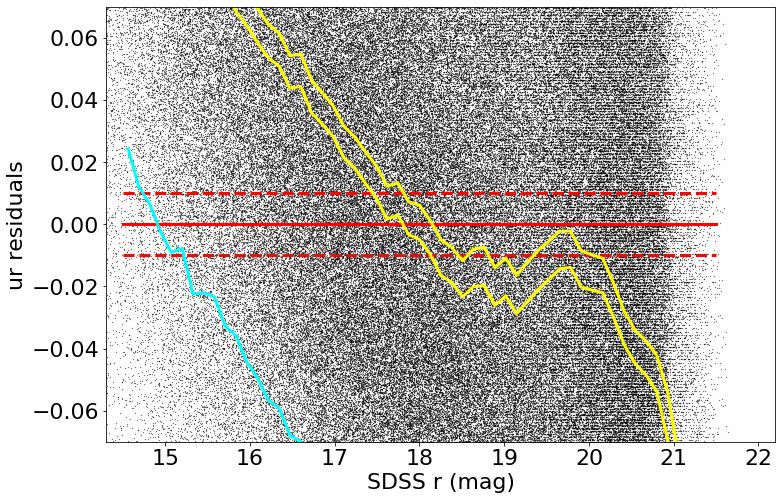

medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.0006497711181654431 std.dev: 0.05687945617938841
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


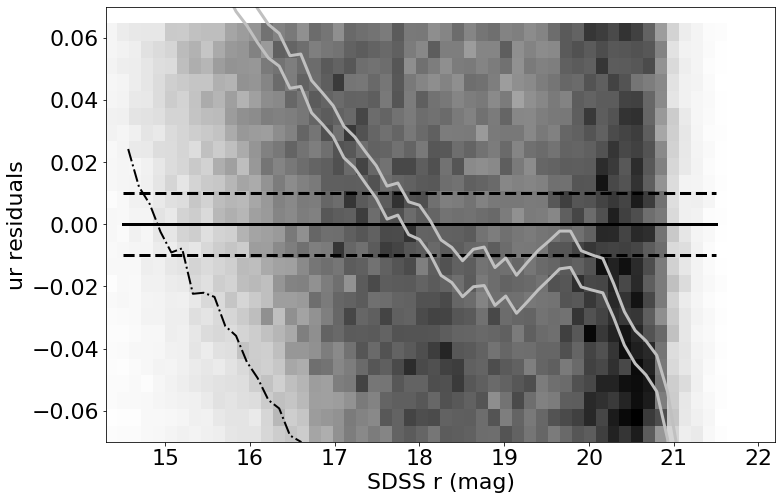

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.011310268020629899 std.dev: 0.05106223761763868
saved plot as: colorResidGaiaColors_ur_Gmag.png


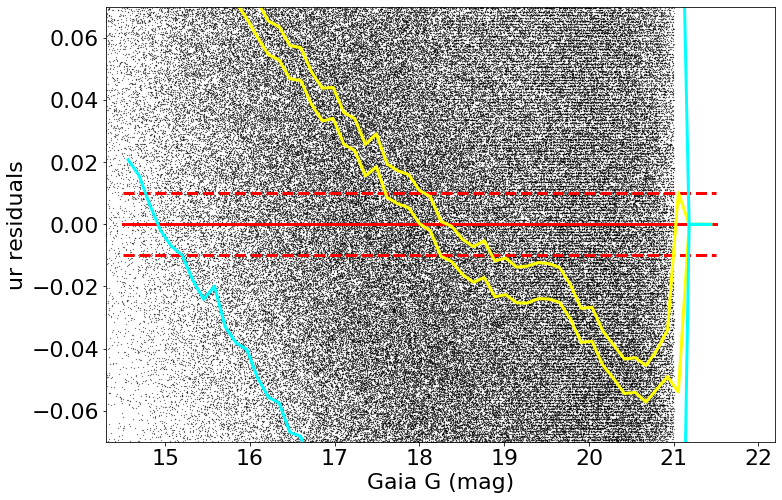

medianAll: 0.010000000000001563 std.dev.All: 0.16931850000000026
N= 521403 min= -0.29999820404052624 max= 0.29999999999999716
median: 0.011310268020629899 std.dev: 0.05106223761763868
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


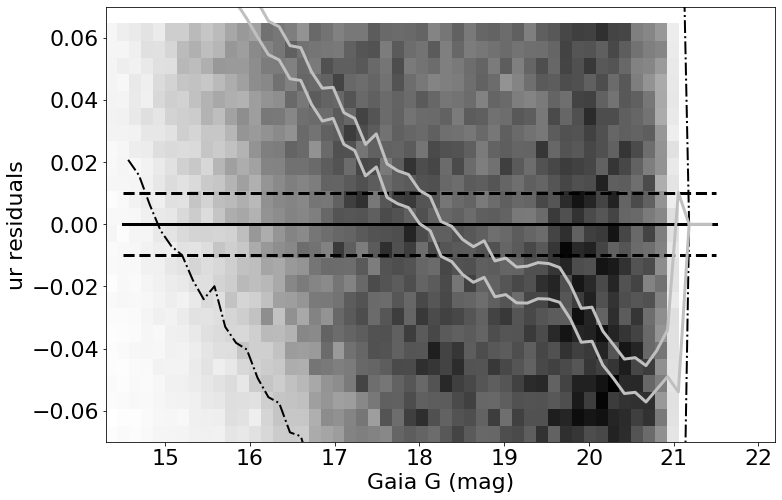

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.024499999999999744 std.dev: 0.007858259177901821
saved plot as: colorResidGaiaColors_gr_RA.png


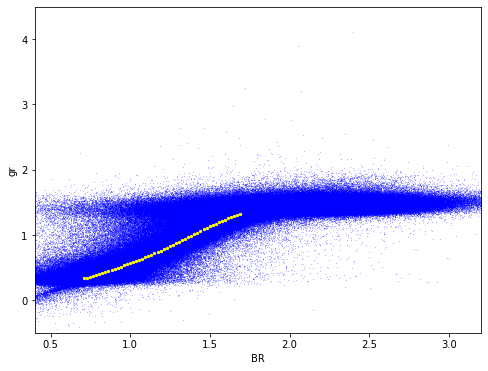

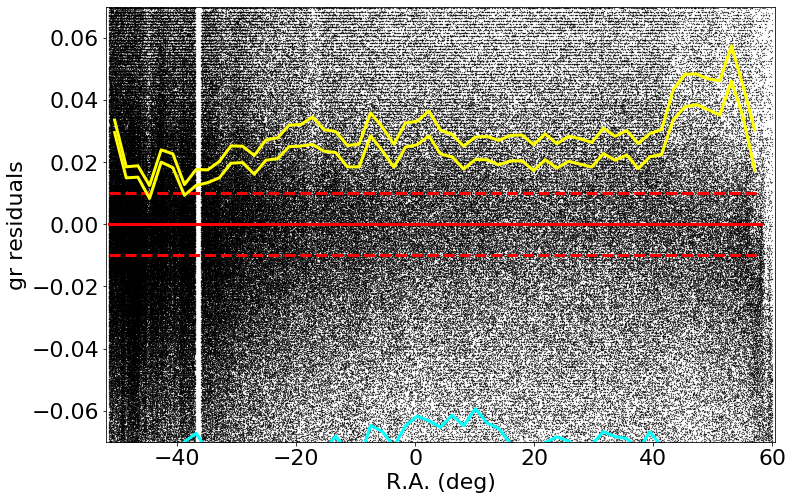

medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.024561024475099613 std.dev: 0.007823142734211303
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


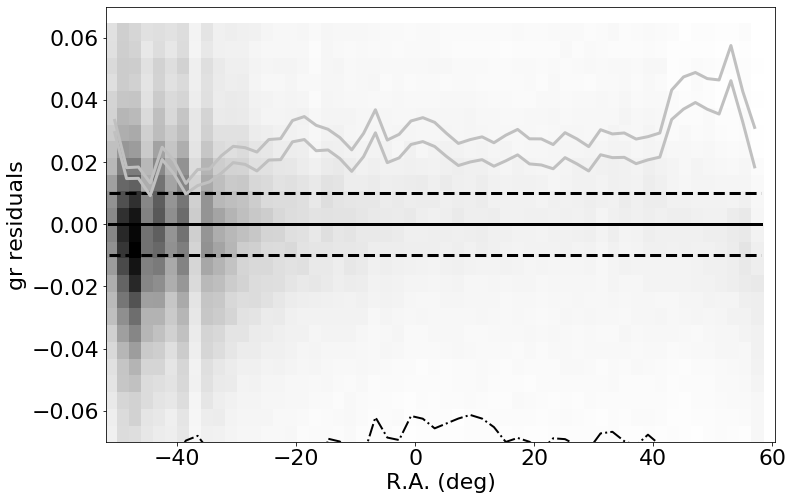

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.022011171722413514 std.dev: 0.003782298055745536
saved plot as: colorResidGaiaColors_gr_Dec.png


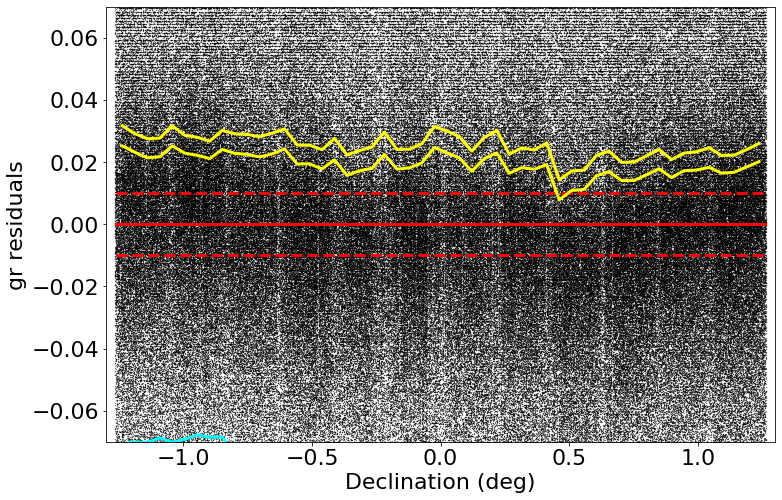

medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.02261875915527456 std.dev: 0.003887265358665626
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


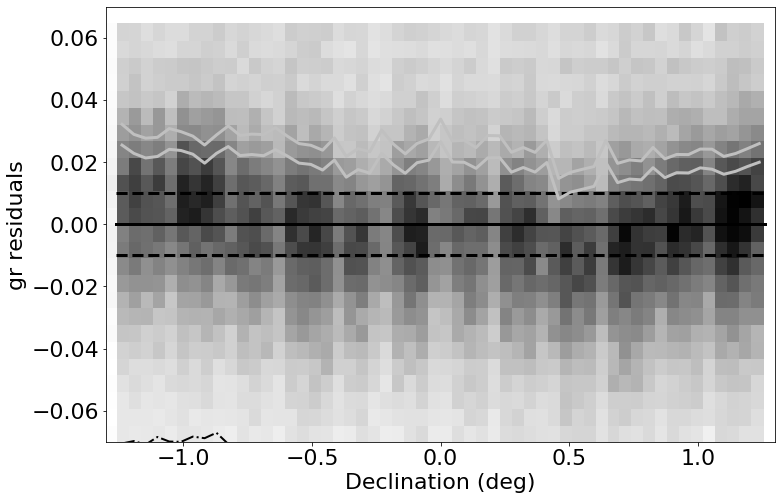

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.004913427734374642 std.dev: 0.04636946462326891
saved plot as: colorResidGaiaColors_gr_rmag.png


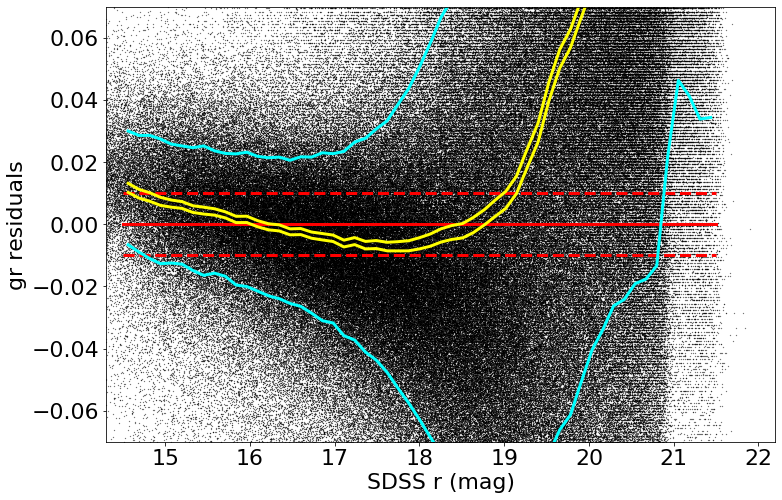

medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.004913427734374642 std.dev: 0.04636946462326891
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


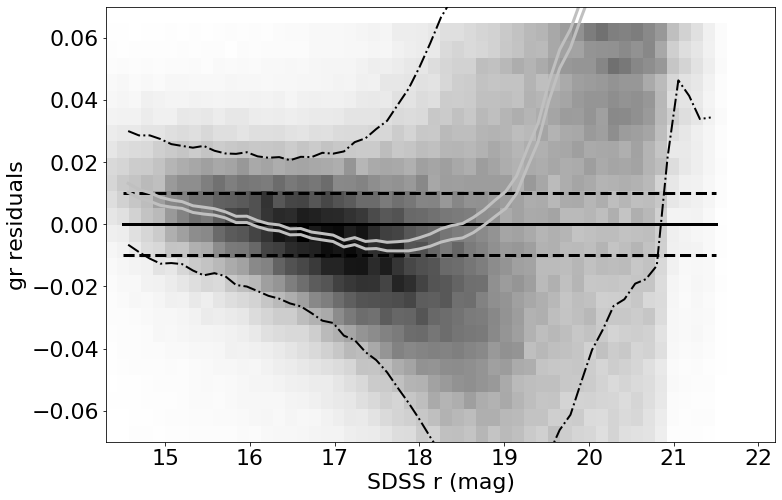

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.005462400245666993 std.dev: 0.035514591883162375
saved plot as: colorResidGaiaColors_gr_Gmag.png


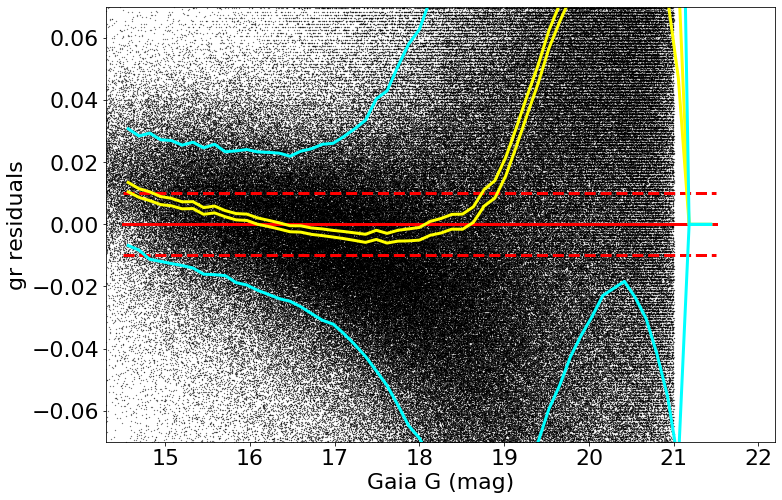

medianAll: 0.022386987304687578 std.dev.All: 0.10093871788329994
N= 769441 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.005462400245666993 std.dev: 0.035514591883162375
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


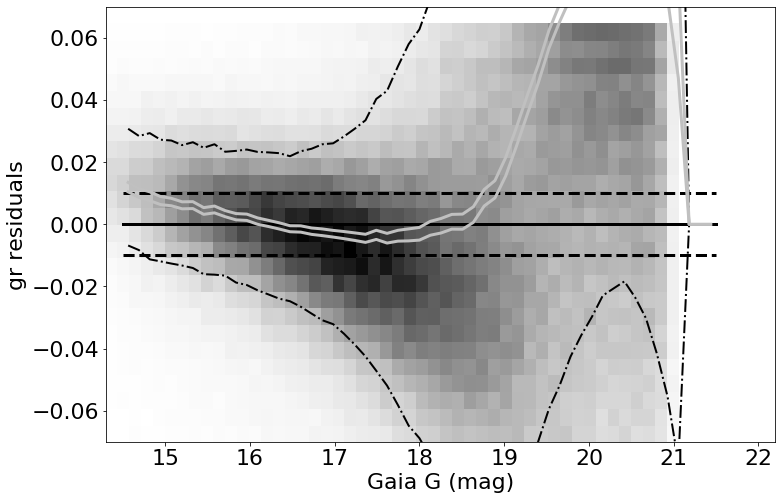

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0008444992065438778 std.dev: 0.00510627832567063
saved plot as: colorResidGaiaColors_ri_RA.png


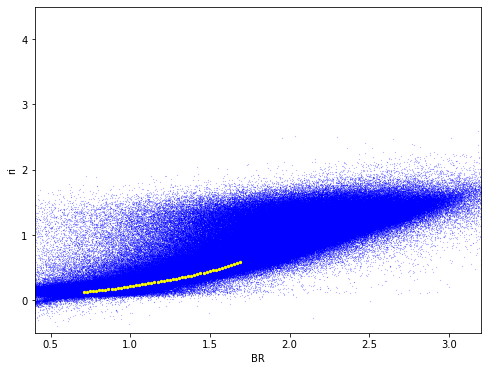

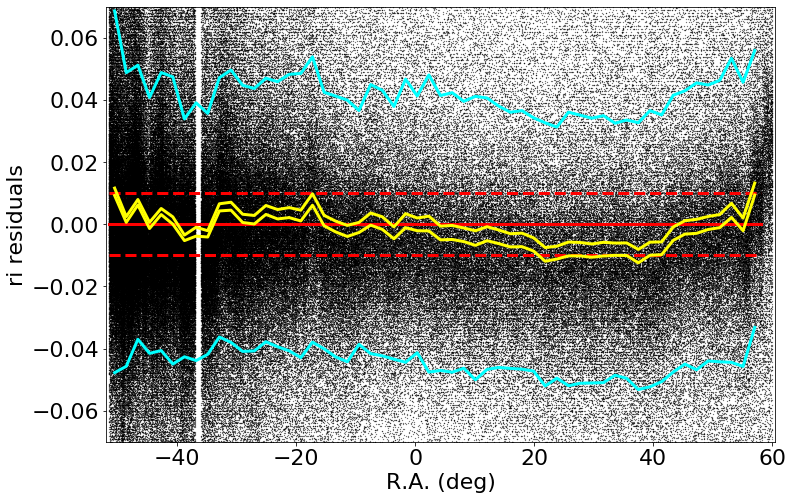

medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0013293853759767937 std.dev: 0.005087805357128967
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


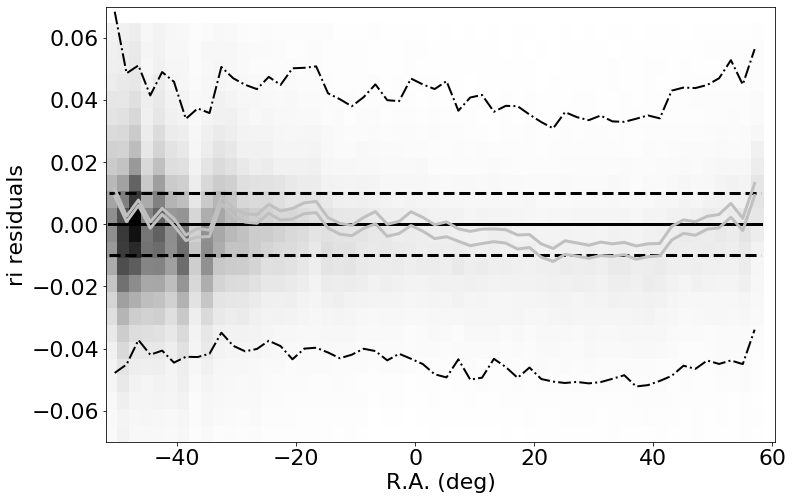

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0022103824615472625 std.dev: 0.0033362222105490784
saved plot as: colorResidGaiaColors_ri_Dec.png


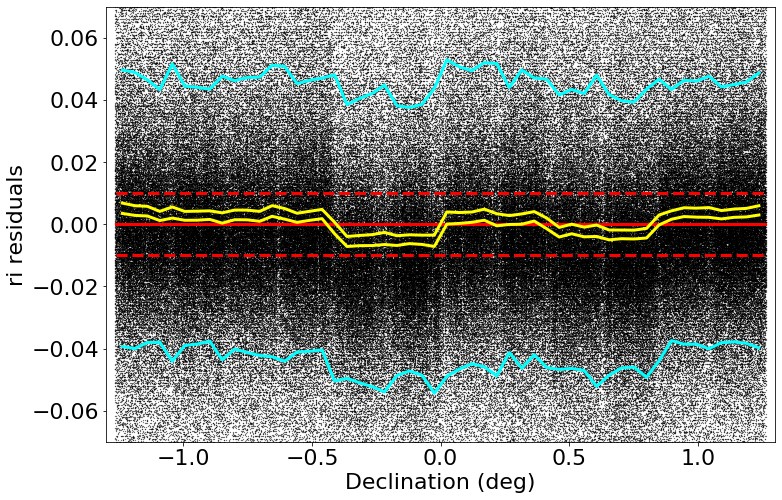

medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0023886665344245717 std.dev: 0.0033280245485610275
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


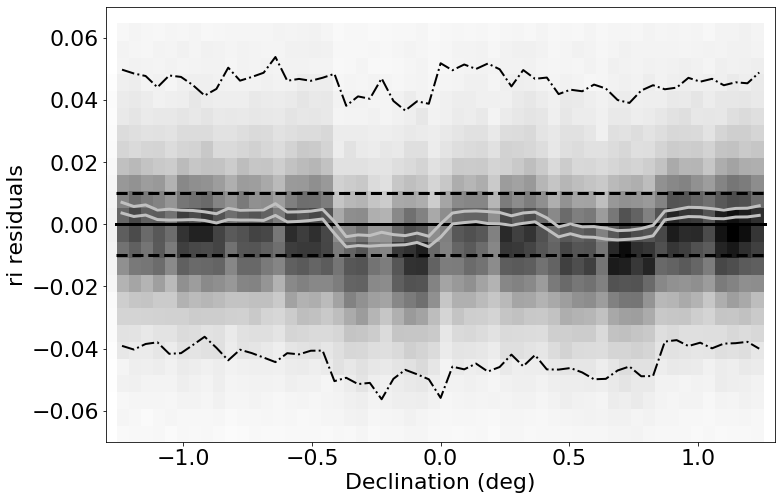

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.003019290161132948 std.dev: 0.05133550435318157
saved plot as: colorResidGaiaColors_ri_rmag.png


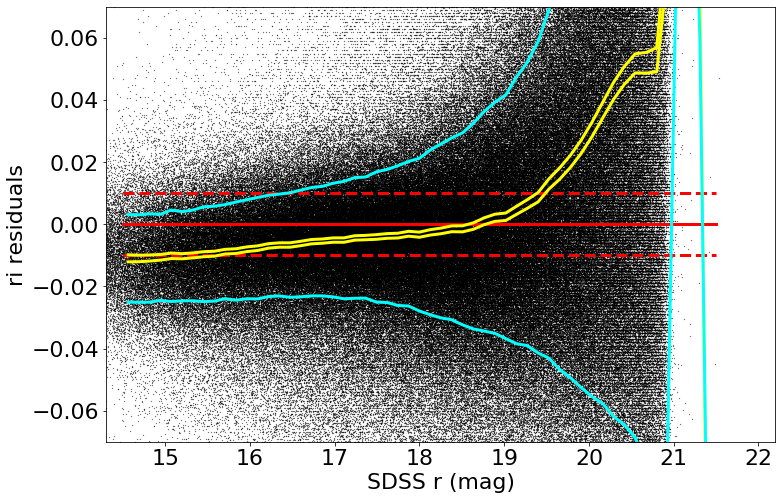

medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.003019290161132948 std.dev: 0.05133550435318157
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


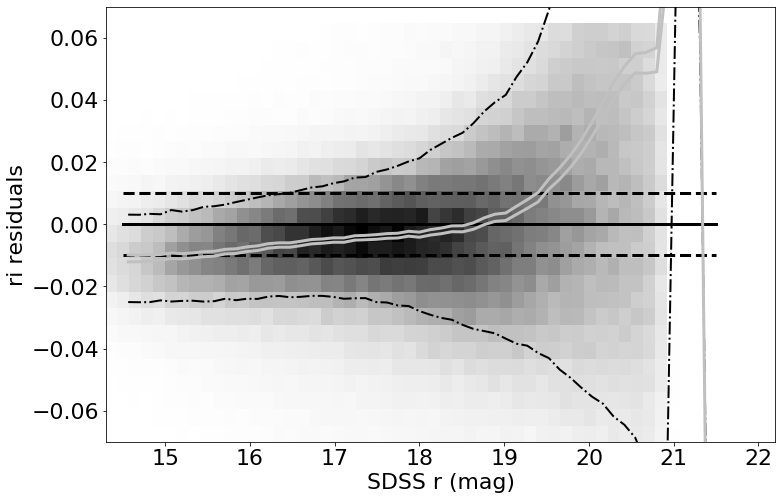

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.003183296203614225 std.dev: 0.018658901928284424
saved plot as: colorResidGaiaColors_ri_Gmag.png


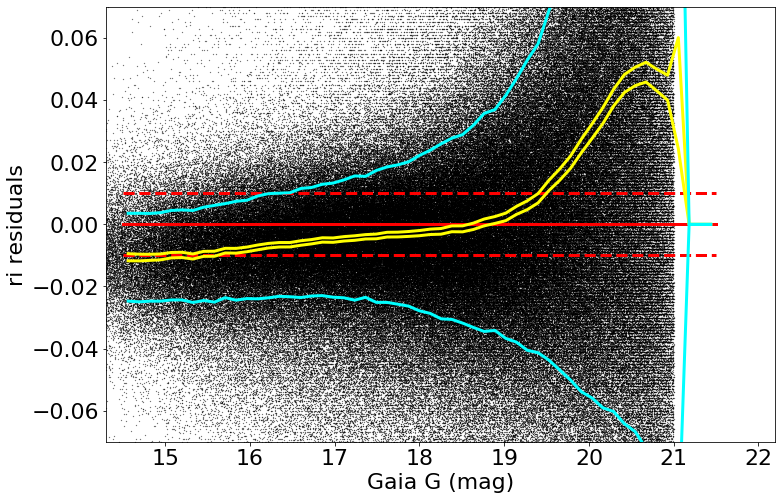

medianAll: 0.0010122894287109552 std.dev.All: 0.04500943291168246
N= 597021 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.003183296203614225 std.dev: 0.018658901928284424
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


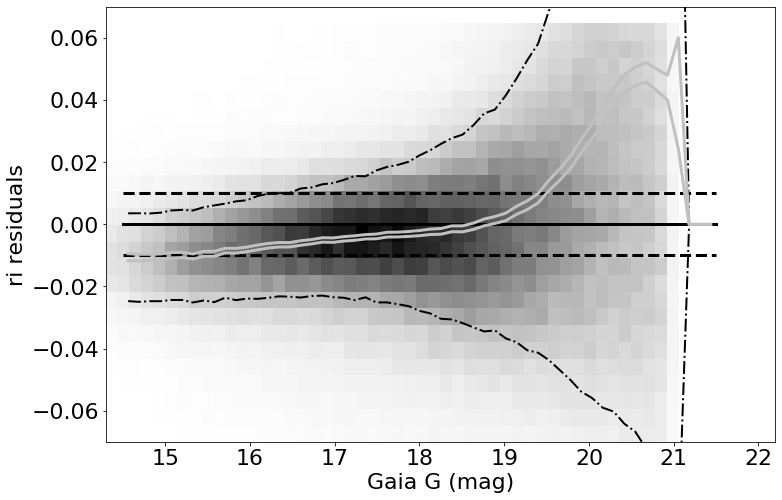

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.005293830871583138 std.dev: 0.009090216388028404
saved plot as: colorResidGaiaColors_rz_RA.png


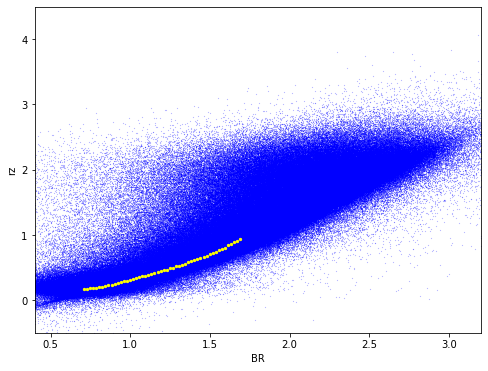

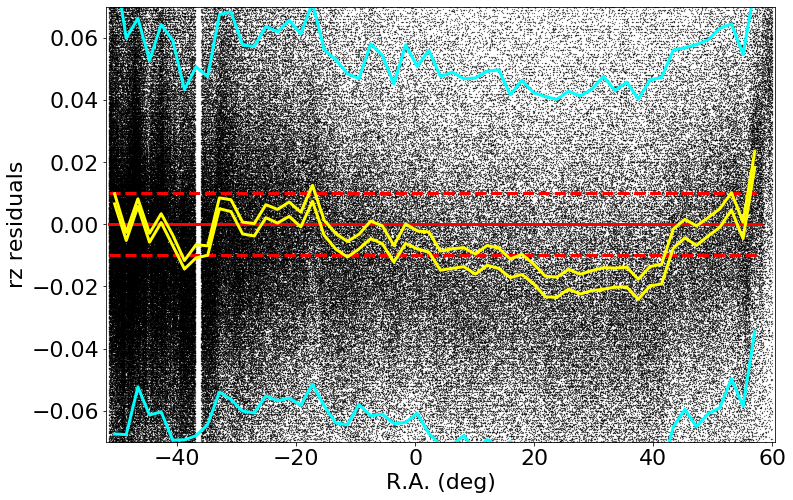

medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.006260682678220469 std.dev: 0.009104348022102245
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


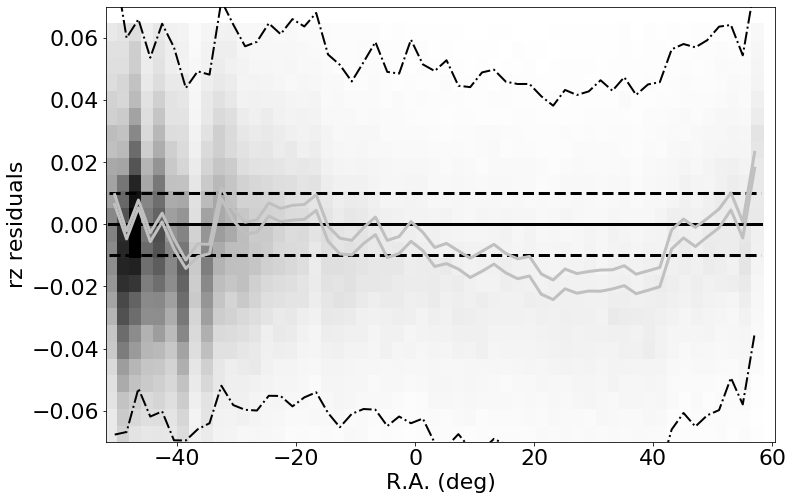

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.0030120506286599527 std.dev: 0.0032449138176796847
saved plot as: colorResidGaiaColors_rz_Dec.png


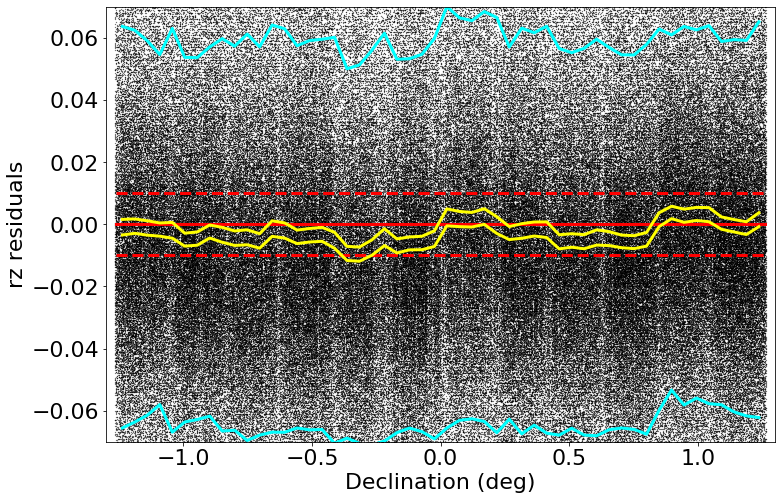

medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.0031640197753896038 std.dev: 0.003200762458539755
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


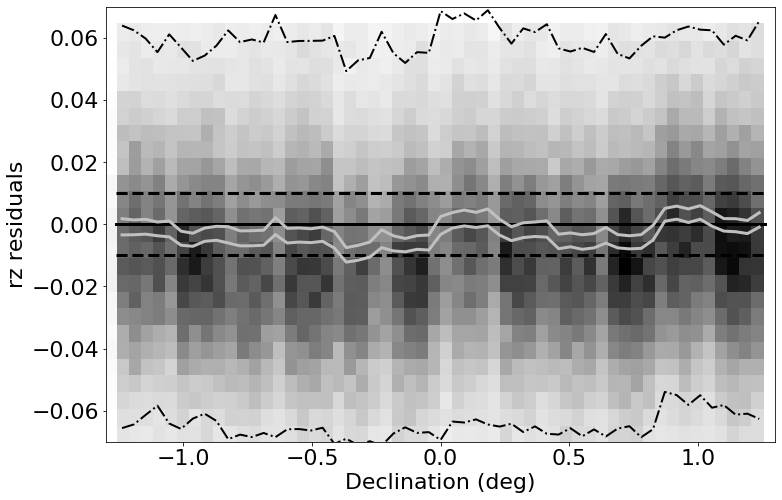

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.007102630615234501 std.dev: 0.05816962863253855
saved plot as: colorResidGaiaColors_rz_rmag.png


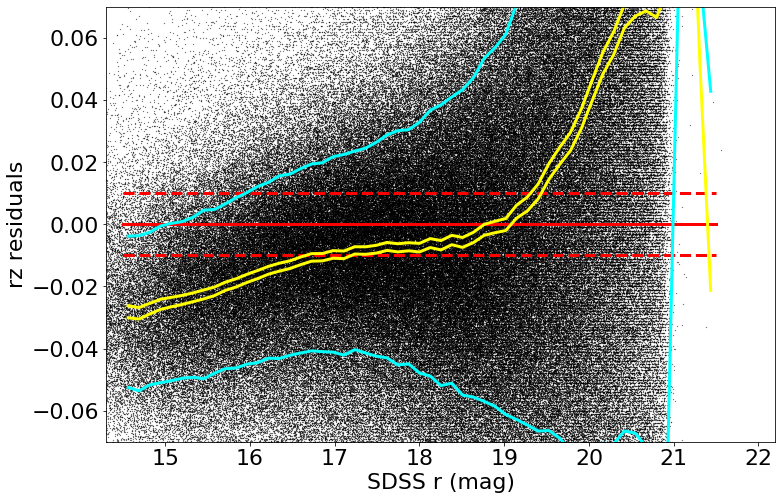

medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.007102630615234501 std.dev: 0.05816962863253855
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


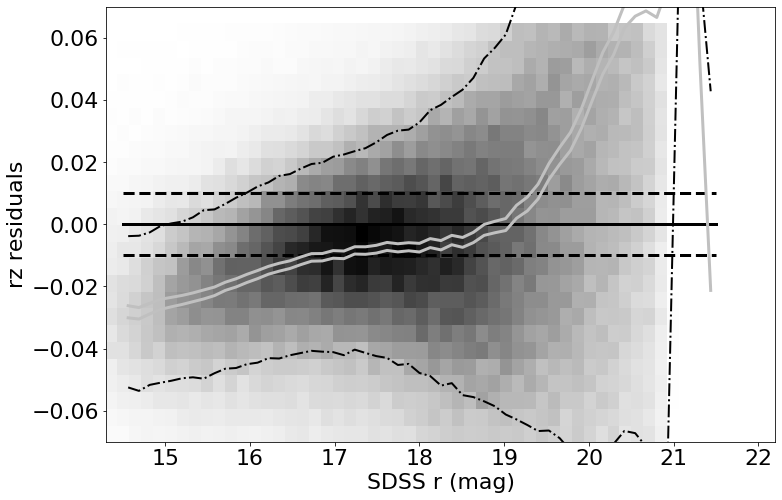

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.006883795166015588 std.dev: 0.028957412180230704
saved plot as: colorResidGaiaColors_rz_Gmag.png


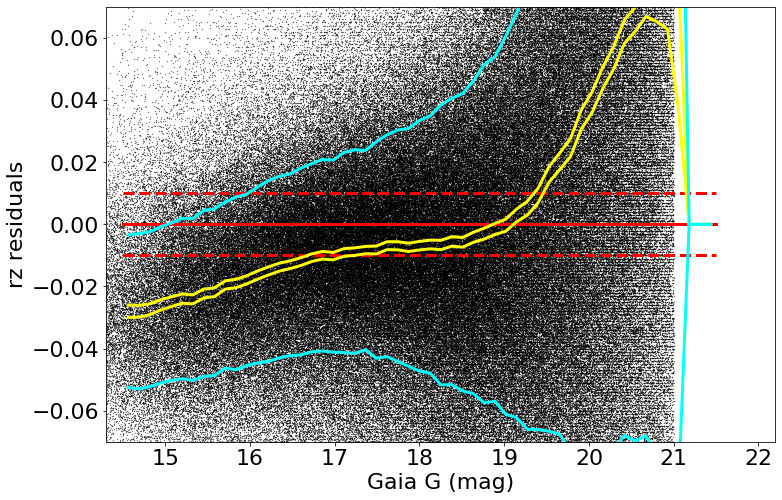

medianAll: -0.0024699951171881507 std.dev.All: 0.06222232380523567
N= 548881 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.006883795166015588 std.dev: 0.028957412180230704
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


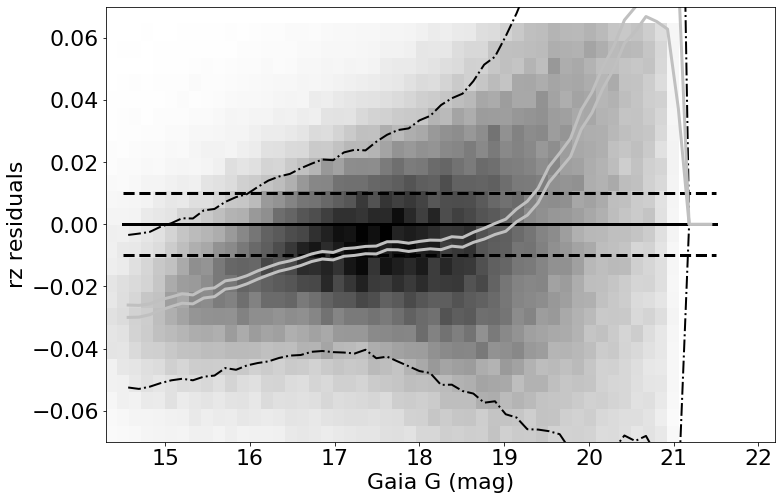

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [14]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColors_', "symbSize":0.05}
for color in ('ur', 'gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matches, keywords)

In [15]:
matchesB = matches[(matches['Gmag']>16)&(matches['Gmag']<19)]
matchesBu = matchesB[(matchesB['u_mMed_new']<20)]
print(np.size(matches), np.size(matchesB), np.size(matchesBu))

885408 304946 115238


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: 0.008018623352047949 std.dev: 0.02817319247247887
saved plot as: colorResidGaiaColorsB_ur_RA.png


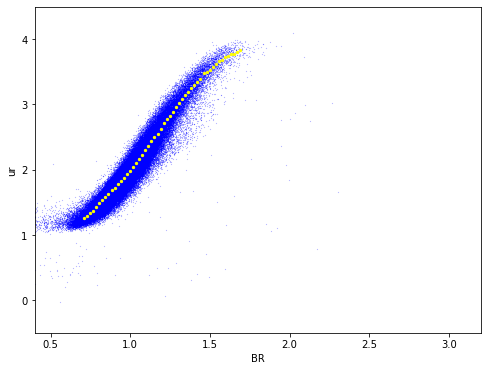

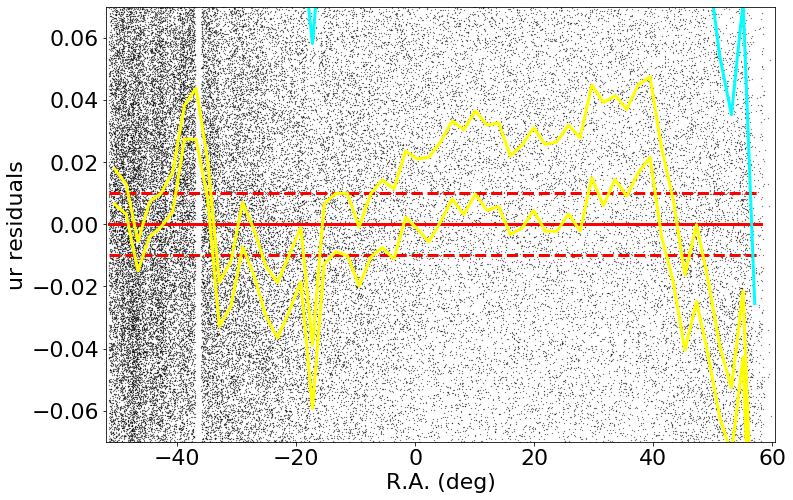

medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: 0.007368290710448422 std.dev: 0.02816776094814189
saved plot as: colorResidGaiaColorsB_ur_RA_Hess.png


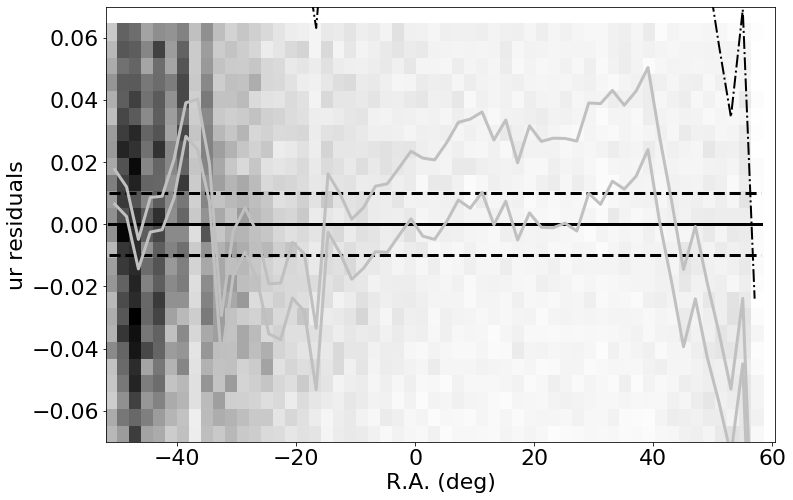

made plot colorResidGaiaColorsB_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: 0.003014693069457175 std.dev: 0.01623471967285046
saved plot as: colorResidGaiaColorsB_ur_Dec.png


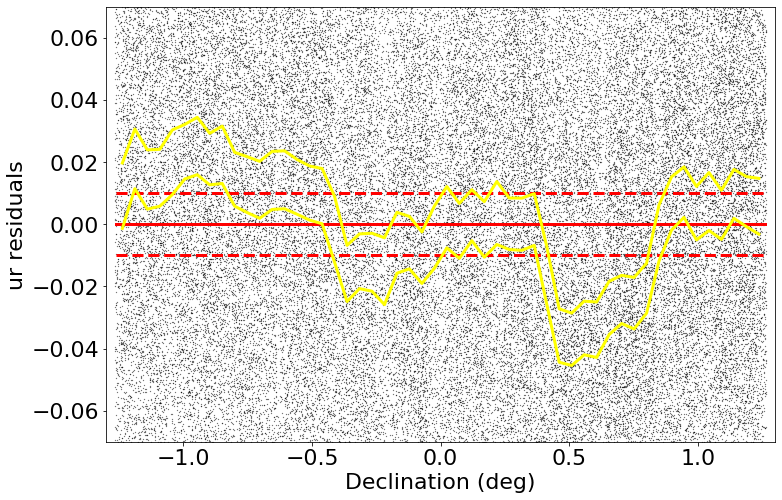

medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: 0.002666256713866222 std.dev: 0.016461485040770645
saved plot as: colorResidGaiaColorsB_ur_Dec_Hess.png


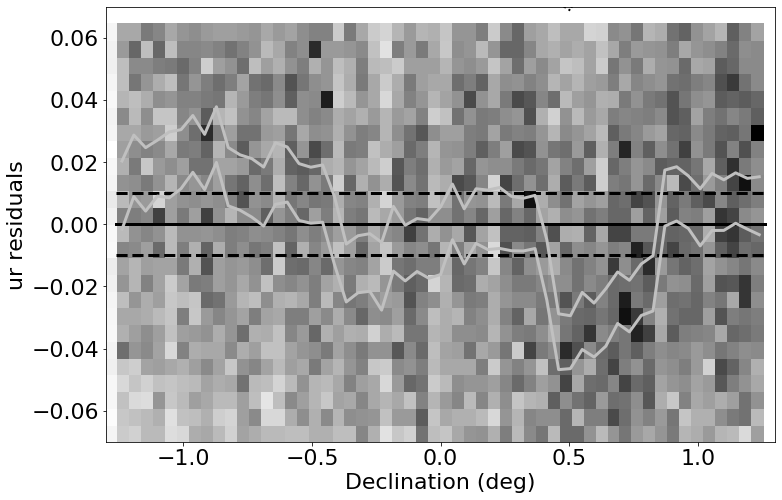

made plot colorResidGaiaColorsB_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: -0.006695803070068562 std.dev: 0.055404407746039164
saved plot as: colorResidGaiaColorsB_ur_rmag.png


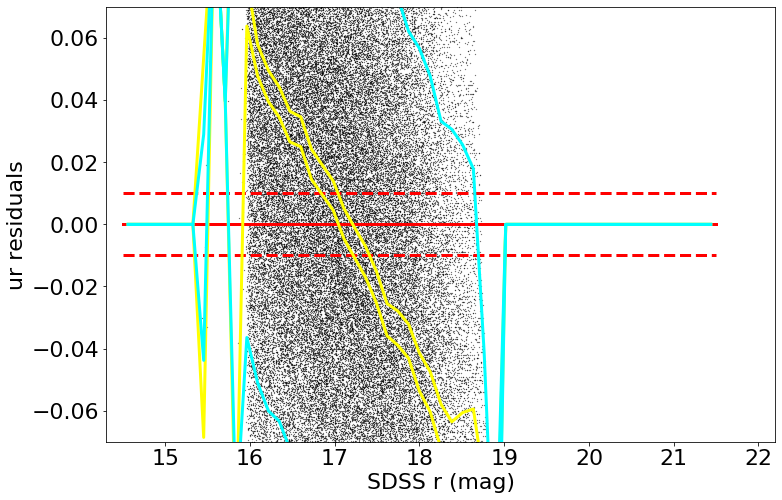

medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: -0.006695803070068562 std.dev: 0.055404407746039164
saved plot as: colorResidGaiaColorsB_ur_rmag_Hess.png


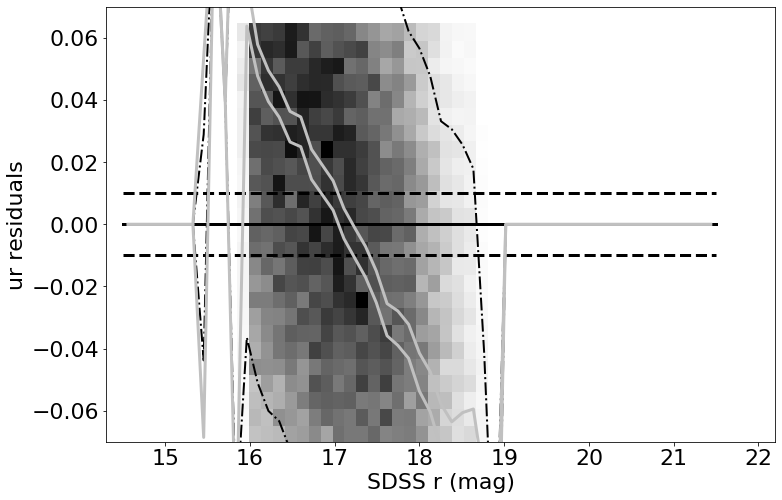

made plot colorResidGaiaColorsB_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: -0.01365451812744134 std.dev: 0.05063315189418679
saved plot as: colorResidGaiaColorsB_ur_Gmag.png


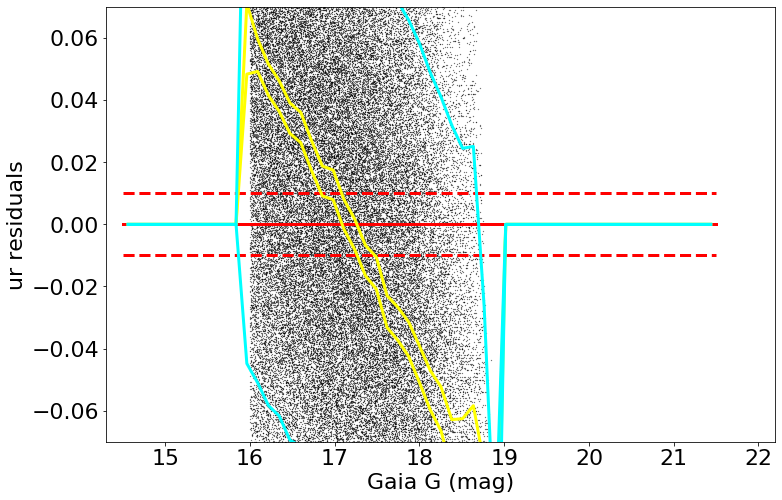

medianAll: -0.0005016914367662606 std.dev.All: 0.10952054002761871
N= 108500 min= -0.29996485900878955 max= 0.2999954833984342
median: -0.01365451812744134 std.dev: 0.05063315189418679
saved plot as: colorResidGaiaColorsB_ur_Gmag_Hess.png


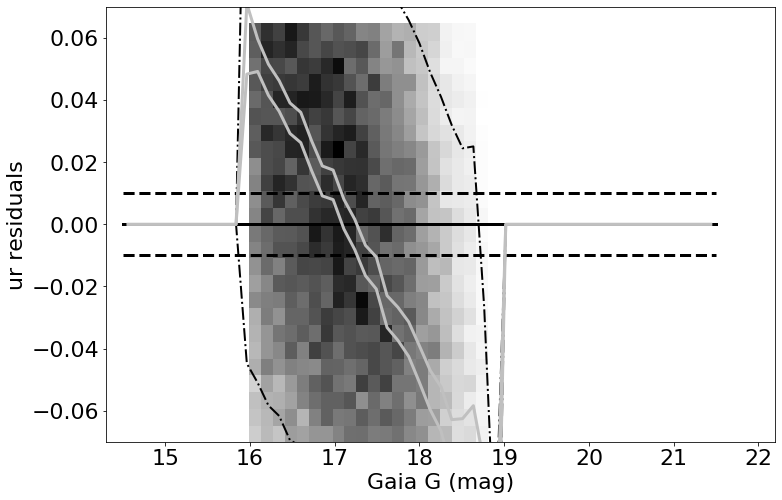

made plot colorResidGaiaColorsB_ur_Gmag_Hess.png
------------------------------------------------------------------


In [16]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsB_', "symbSize":0.05}
color = 'ur' 
keywords["Ystr"] = color 
doOneColorGaiaBR(matchesBu, keywords)

=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.018131309890746516 std.dev: 0.00758359951269376
saved plot as: colorResidGaiaColorsB_gr_RA.png


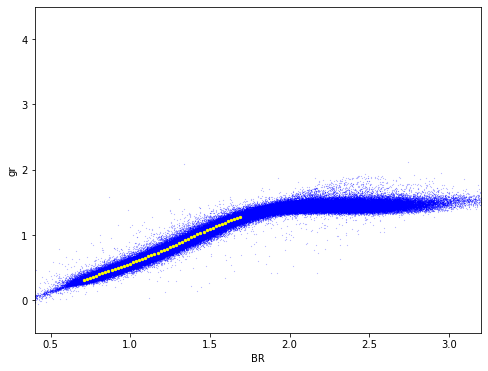

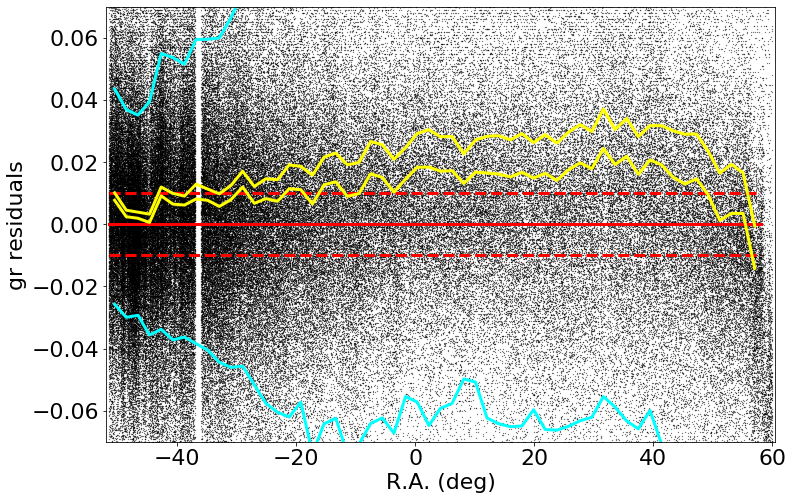

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.017911374664307422 std.dev: 0.007531600308106512
saved plot as: colorResidGaiaColorsB_gr_RA_Hess.png


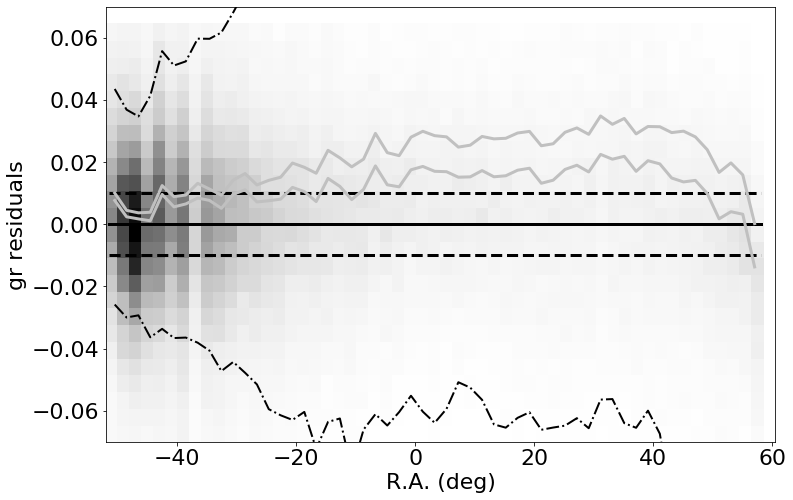

made plot colorResidGaiaColorsB_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.01116805038452015 std.dev: 0.004142012305766747
saved plot as: colorResidGaiaColorsB_gr_Dec.png


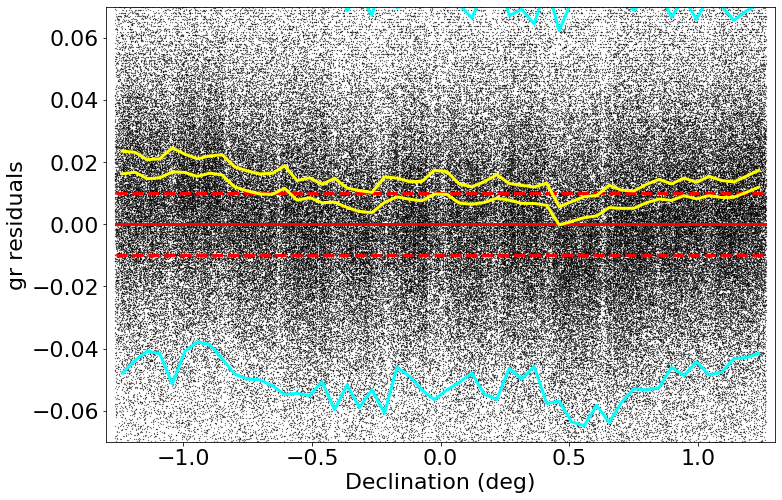

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.011083326721193026 std.dev: 0.004167268649649081
saved plot as: colorResidGaiaColorsB_gr_Dec_Hess.png


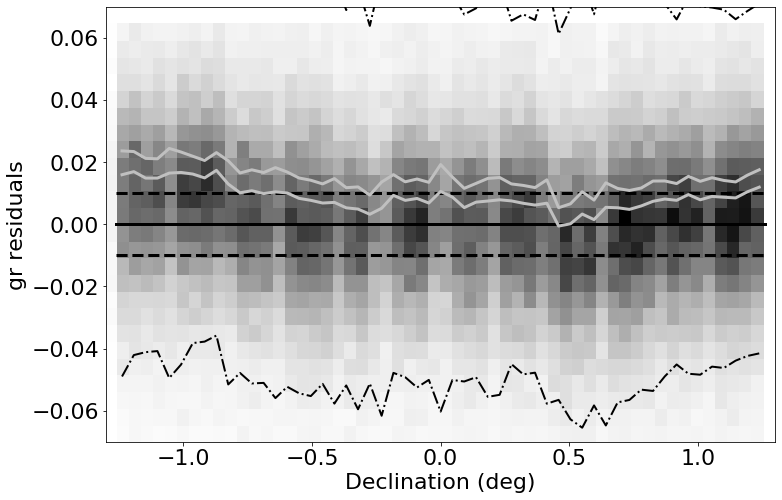

made plot colorResidGaiaColorsB_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.009654394149779227 std.dev: 0.09726294822145566
saved plot as: colorResidGaiaColorsB_gr_rmag.png


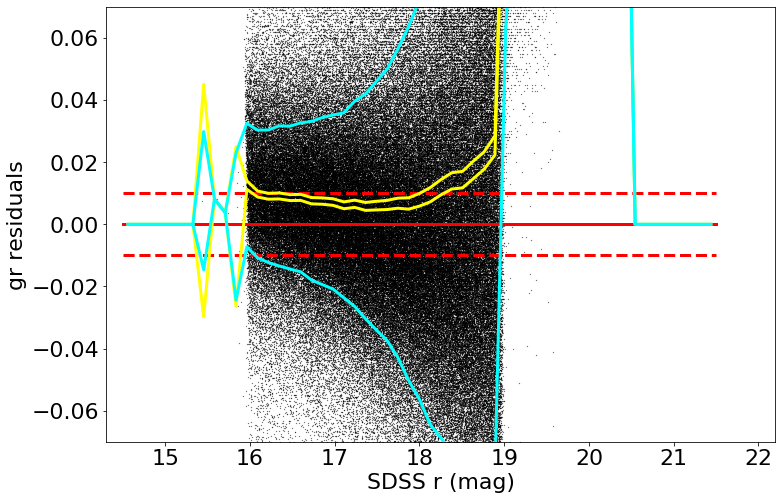

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.009654394149779227 std.dev: 0.09726294822145566
saved plot as: colorResidGaiaColorsB_gr_rmag_Hess.png


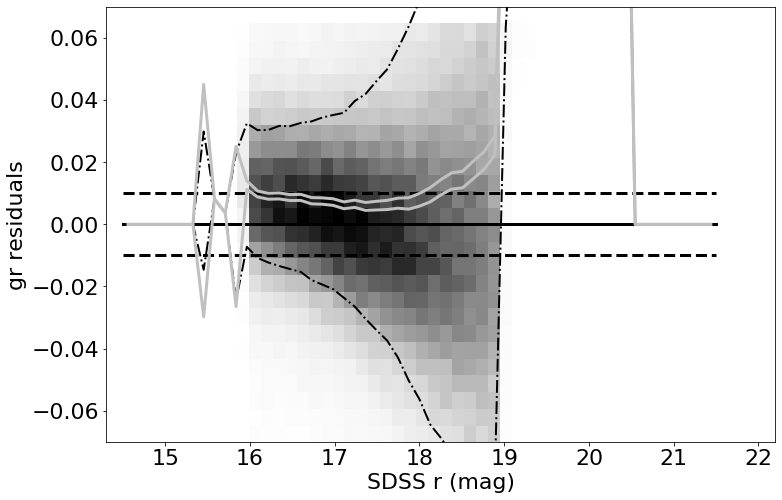

made plot colorResidGaiaColorsB_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.010535808563231525 std.dev: 0.007269255571821778
saved plot as: colorResidGaiaColorsB_gr_Gmag.png


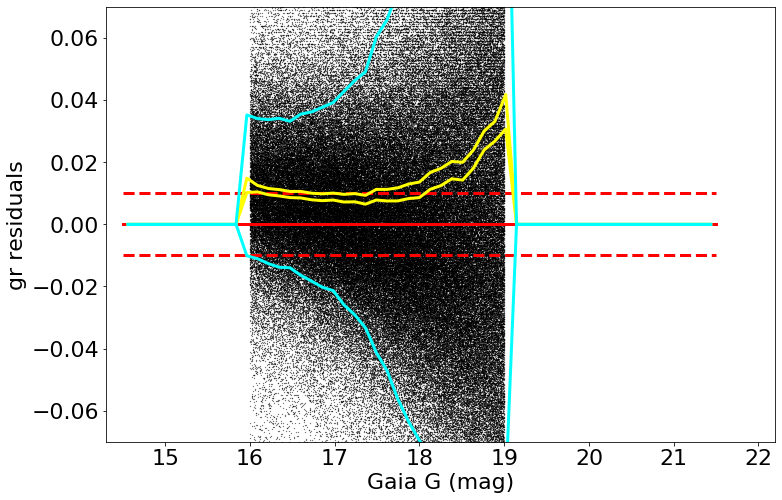

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.010535808563231525 std.dev: 0.007269255571821778
saved plot as: colorResidGaiaColorsB_gr_Gmag_Hess.png


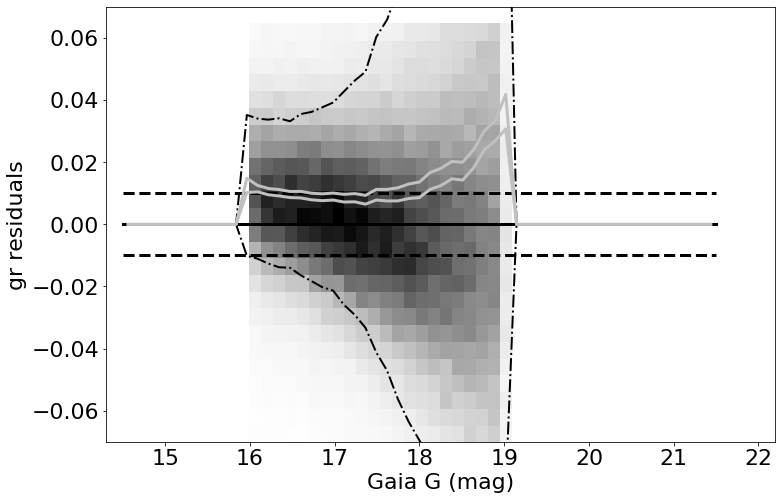

made plot colorResidGaiaColorsB_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.00246463737487794 std.dev: 0.002996155691755732
saved plot as: colorResidGaiaColorsB_ri_RA.png


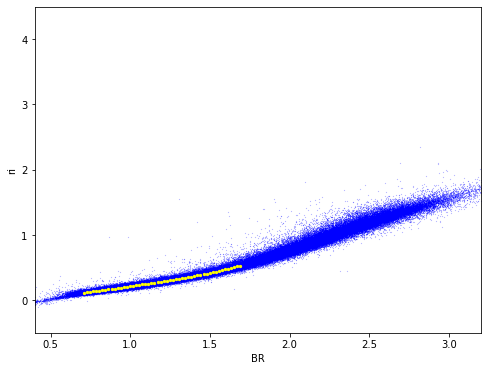

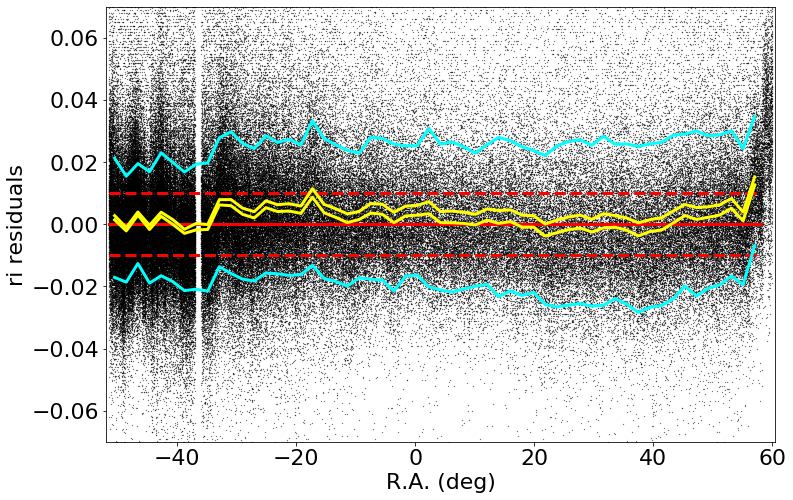

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002563636779783607 std.dev: 0.0030508522614896665
saved plot as: colorResidGaiaColorsB_ri_RA_Hess.png


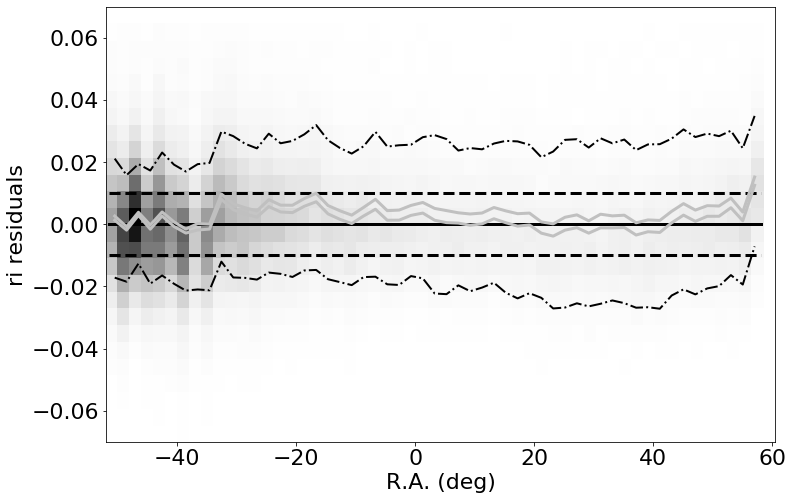

made plot colorResidGaiaColorsB_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0034760000228892113 std.dev: 0.003161840428203877
saved plot as: colorResidGaiaColorsB_ri_Dec.png


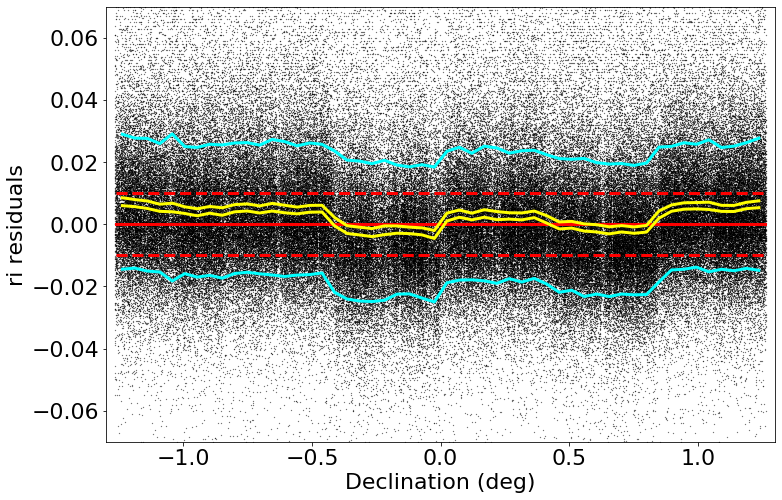

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0034558624267602978 std.dev: 0.0031867490869977298
saved plot as: colorResidGaiaColorsB_ri_Dec_Hess.png


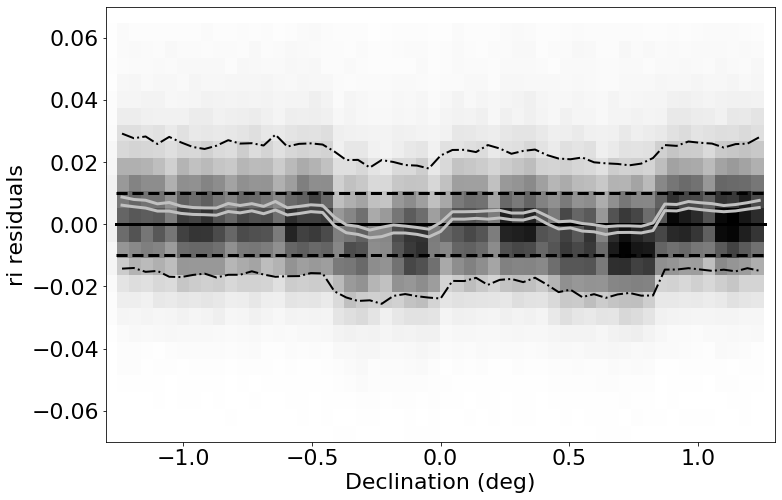

made plot colorResidGaiaColorsB_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0026842788696298803 std.dev: 0.08079765933446732
saved plot as: colorResidGaiaColorsB_ri_rmag.png


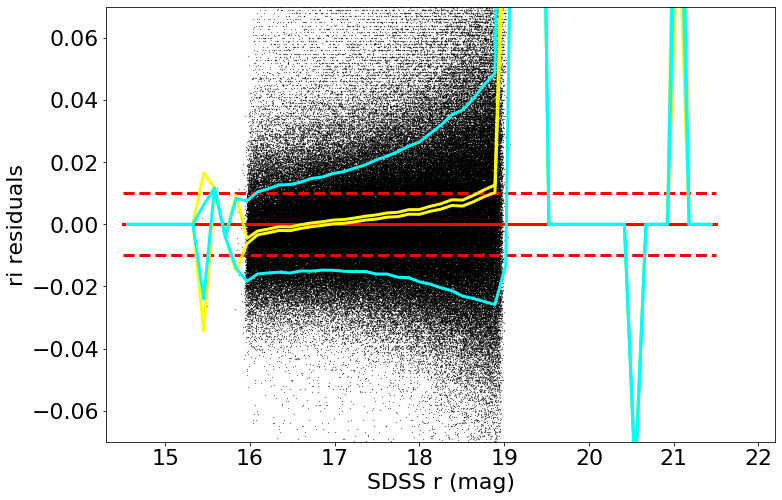

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0026842788696298803 std.dev: 0.08079765933446732
saved plot as: colorResidGaiaColorsB_ri_rmag_Hess.png


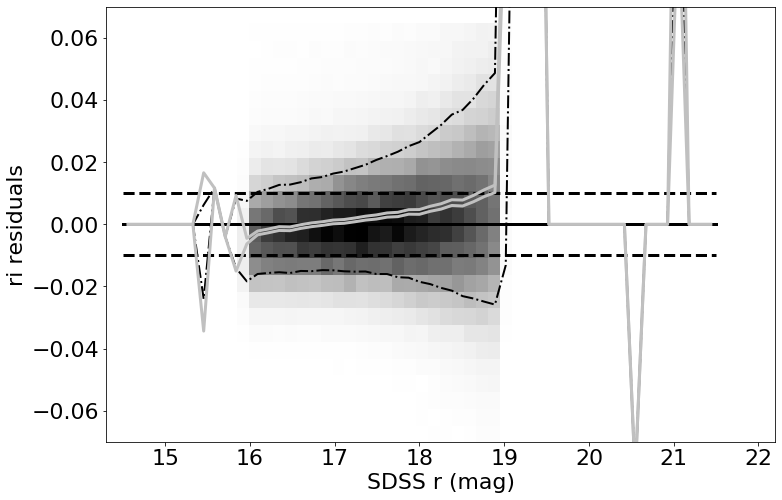

made plot colorResidGaiaColorsB_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002514898681637623 std.dev: 0.003964240882140641
saved plot as: colorResidGaiaColorsB_ri_Gmag.png


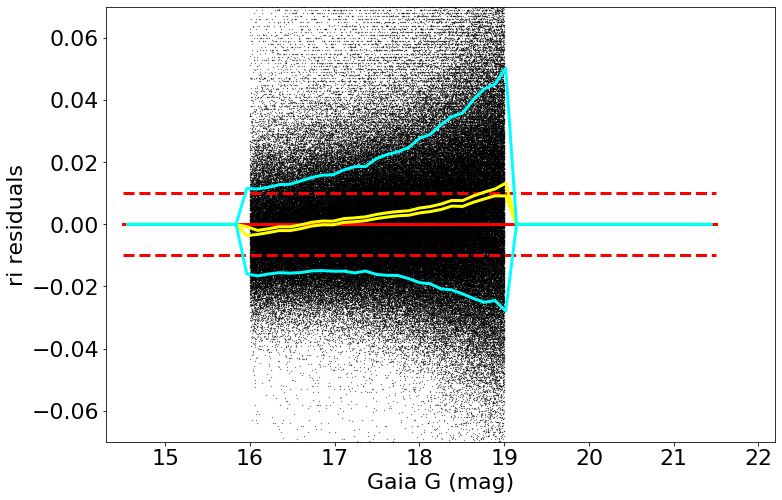

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002514898681637623 std.dev: 0.003964240882140641
saved plot as: colorResidGaiaColorsB_ri_Gmag_Hess.png


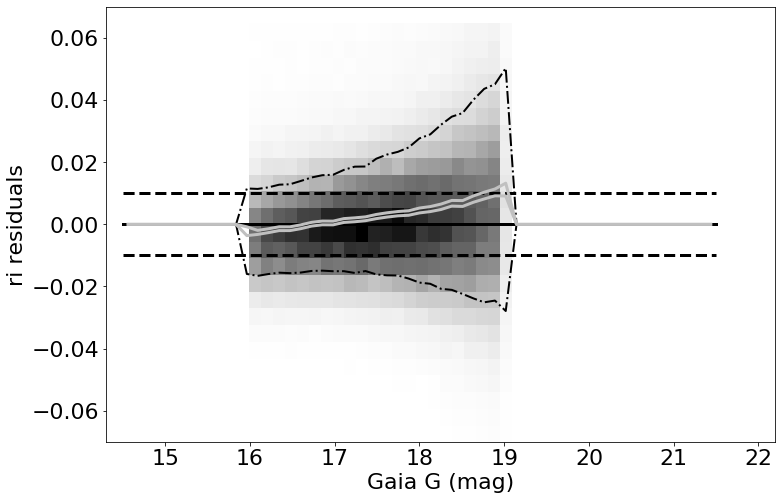

made plot colorResidGaiaColorsB_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0011439908981312405 std.dev: 0.007261801164620444
saved plot as: colorResidGaiaColorsB_rz_RA.png


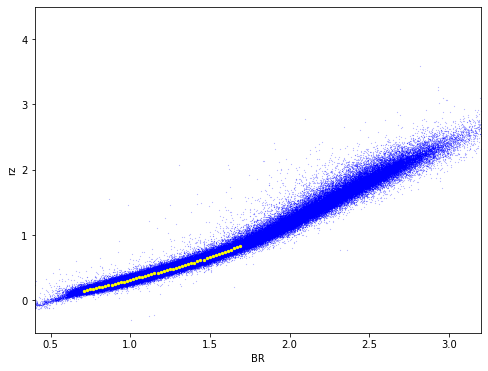

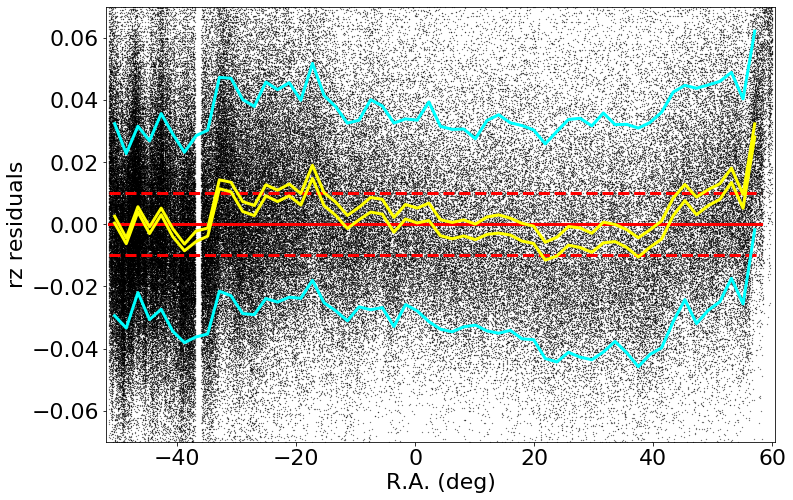

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0012431060791023851 std.dev: 0.007258485651324475
saved plot as: colorResidGaiaColorsB_rz_RA_Hess.png


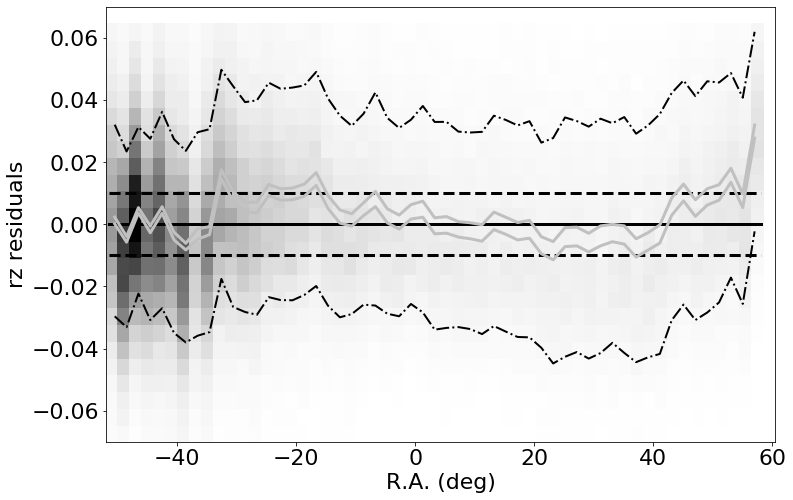

made plot colorResidGaiaColorsB_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003175690460204897 std.dev: 0.0031298441492516914
saved plot as: colorResidGaiaColorsB_rz_Dec.png


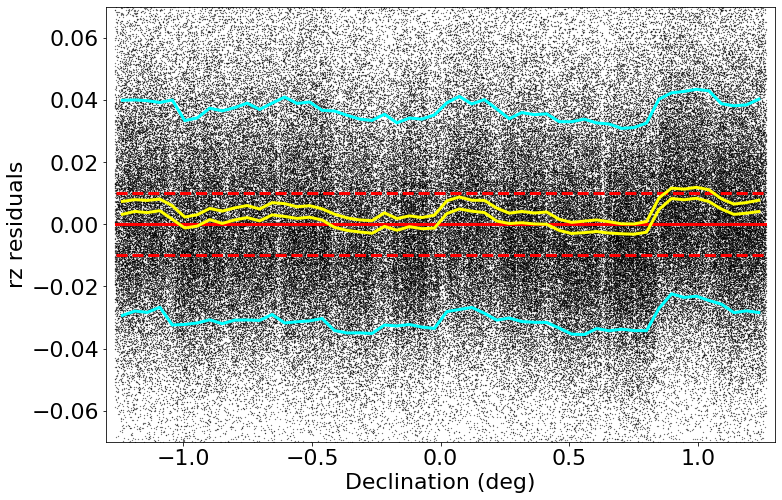

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003140780639649454 std.dev: 0.0031549248493672605
saved plot as: colorResidGaiaColorsB_rz_Dec_Hess.png


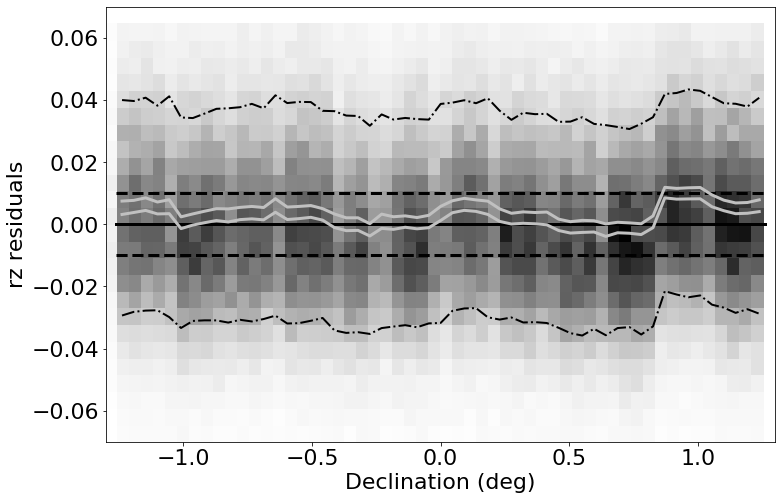

made plot colorResidGaiaColorsB_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0024559001922614676 std.dev: 0.06943093576004734
saved plot as: colorResidGaiaColorsB_rz_rmag.png


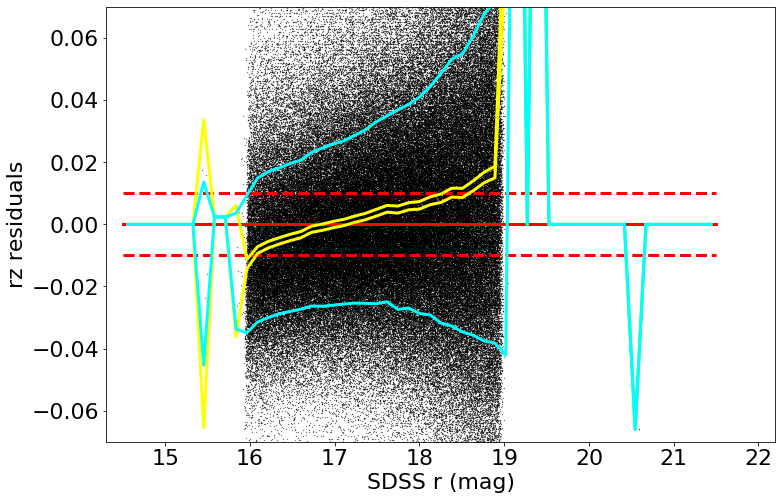

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0024559001922614676 std.dev: 0.06943093576004734
saved plot as: colorResidGaiaColorsB_rz_rmag_Hess.png


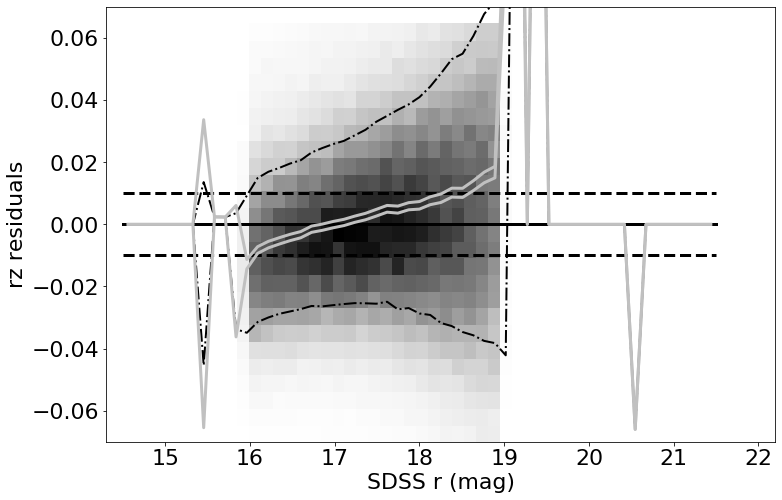

made plot colorResidGaiaColorsB_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0038016754150417276 std.dev: 0.007262221755491843
saved plot as: colorResidGaiaColorsB_rz_Gmag.png


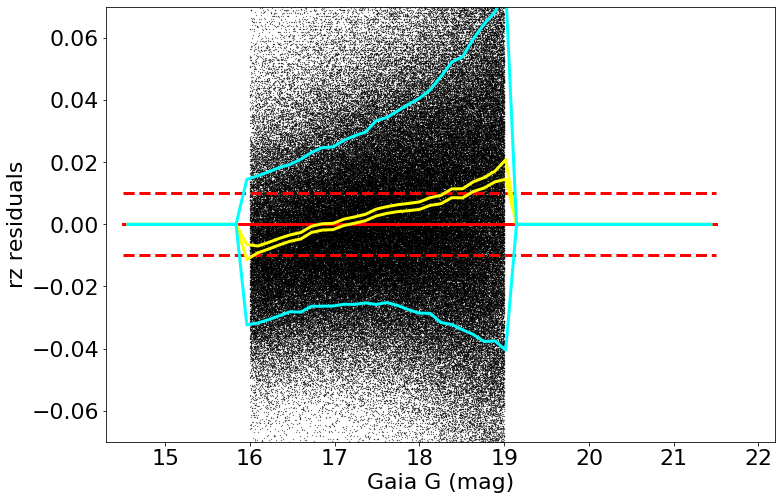

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0038016754150417276 std.dev: 0.007262221755491843
saved plot as: colorResidGaiaColorsB_rz_Gmag_Hess.png


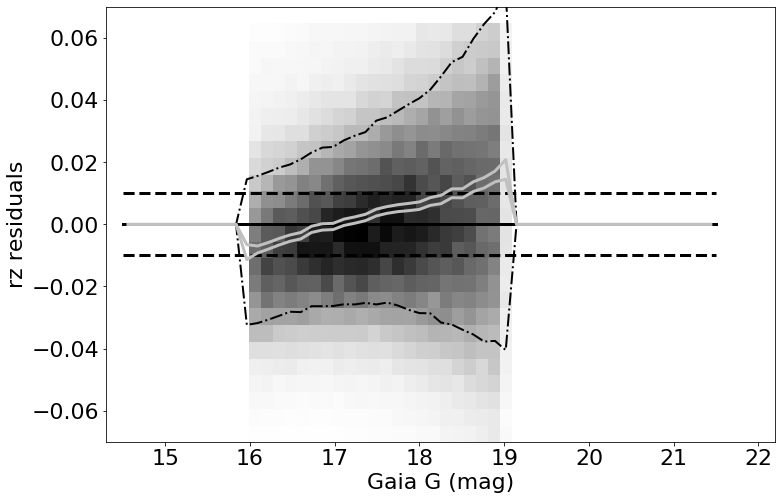

made plot colorResidGaiaColorsB_rz_Gmag_Hess.png
------------------------------------------------------------------


In [17]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsB_', "symbSize":0.05}
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesB, keywords)

In [18]:
matchesRecalib = matches[(matches['BR']>0.7)&(matches['BR']<1.7)]
matchesUR = matchesRecalib[(matchesRecalib['u_mMed_new']<20.0)]
print(np.size(matchesRecalib), np.size(matchesUR))

502670 165276


=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.018131309890746516 std.dev: 0.00758359951269376
saved plot as: colorResidGaiaColorsRecalib_gr_RA.png


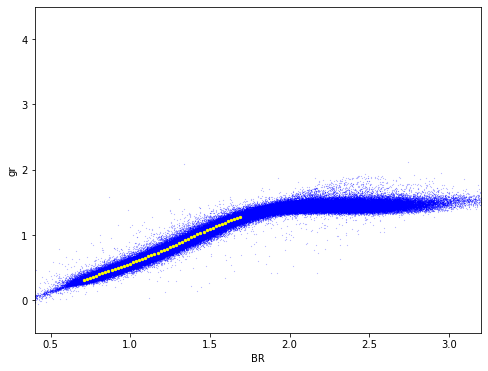

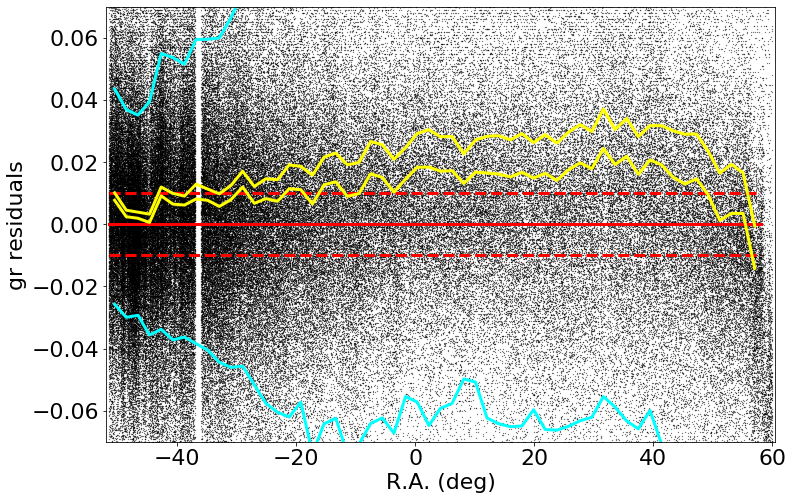

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.017911374664307422 std.dev: 0.007531600308106512
saved plot as: colorResidGaiaColorsRecalib_gr_RA_Hess.png


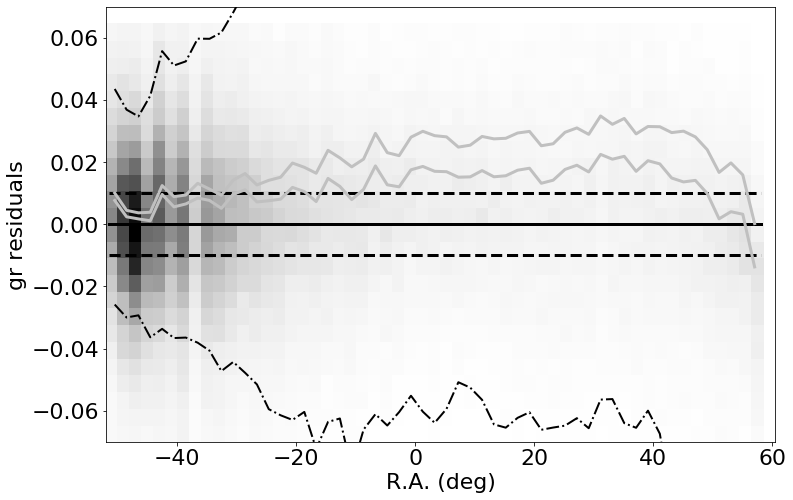

made plot colorResidGaiaColorsRecalib_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.01116805038452015 std.dev: 0.004142012305766747
saved plot as: colorResidGaiaColorsRecalib_gr_Dec.png


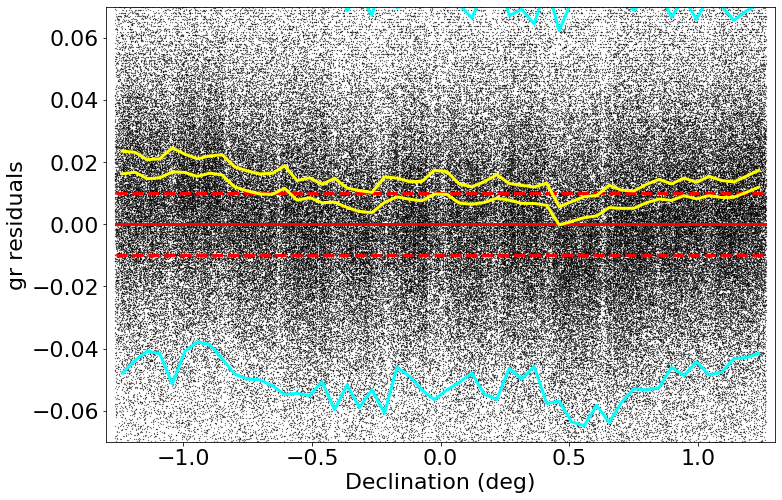

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.011083326721193026 std.dev: 0.004167268649649081
saved plot as: colorResidGaiaColorsRecalib_gr_Dec_Hess.png


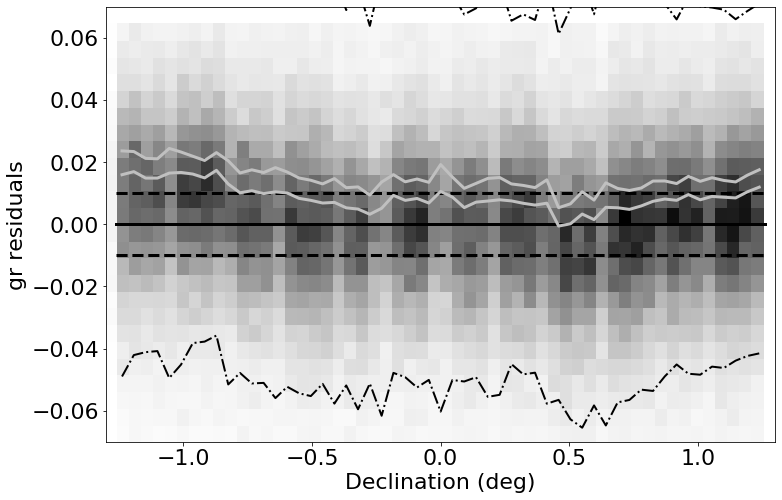

made plot colorResidGaiaColorsRecalib_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.009654394149779227 std.dev: 0.09726294822145566
saved plot as: colorResidGaiaColorsRecalib_gr_rmag.png


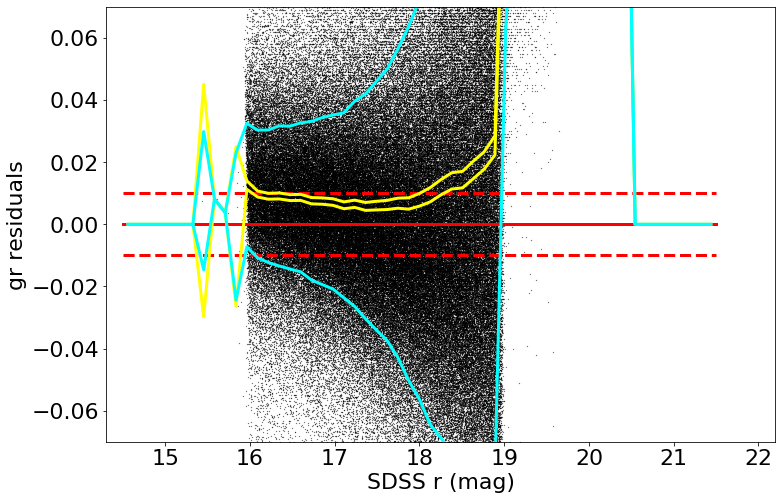

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.009654394149779227 std.dev: 0.09726294822145566
saved plot as: colorResidGaiaColorsRecalib_gr_rmag_Hess.png


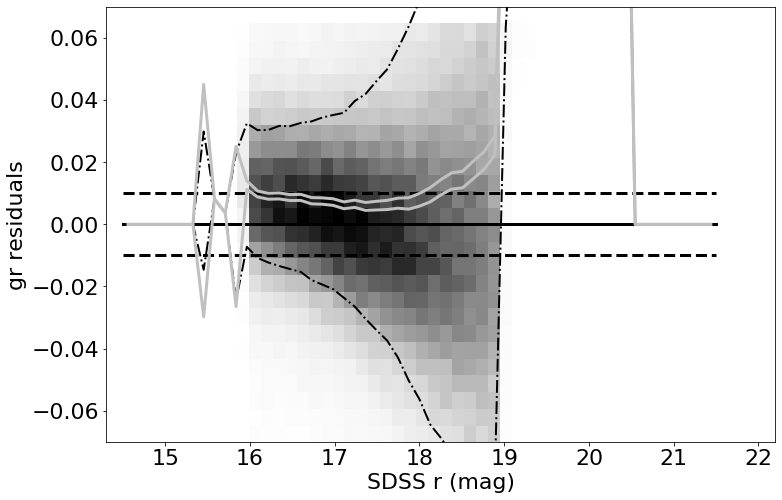

made plot colorResidGaiaColorsRecalib_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.010535808563231525 std.dev: 0.007269255571821778
saved plot as: colorResidGaiaColorsRecalib_gr_Gmag.png


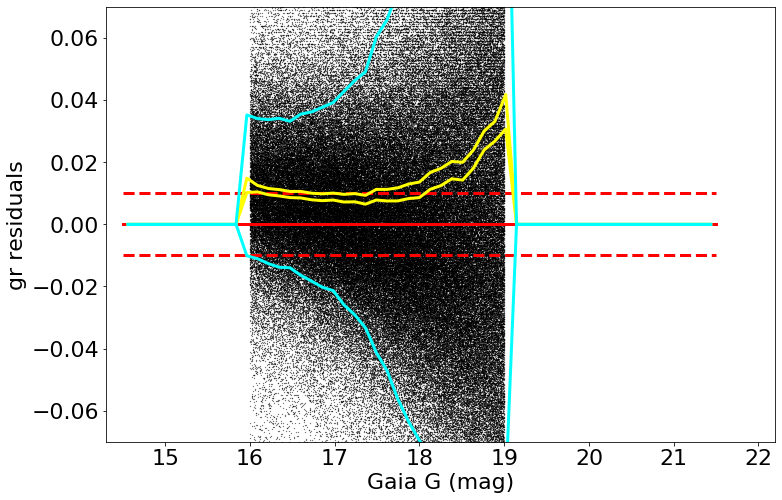

medianAll: 0.012028224182129676 std.dev.All: 0.06268105019188004
N= 297050 min= -0.29999999999999716 max= 0.29900000000000304
median: 0.010535808563231525 std.dev: 0.007269255571821778
saved plot as: colorResidGaiaColorsRecalib_gr_Gmag_Hess.png


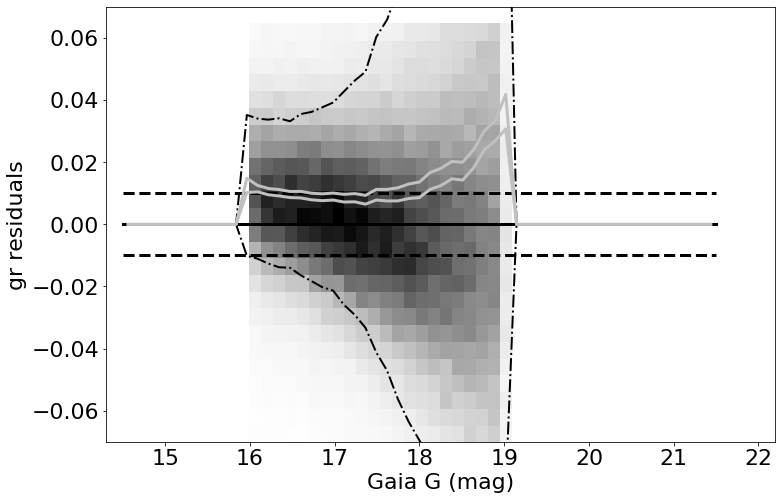

made plot colorResidGaiaColorsRecalib_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.00246463737487794 std.dev: 0.002996155691755732
saved plot as: colorResidGaiaColorsRecalib_ri_RA.png


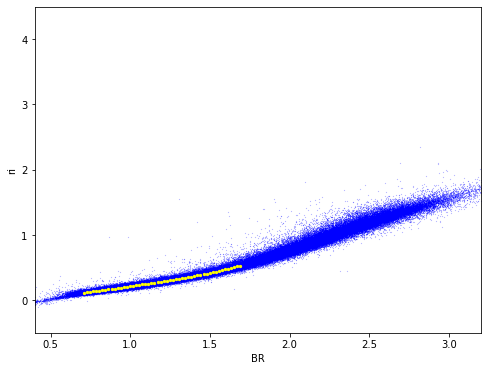

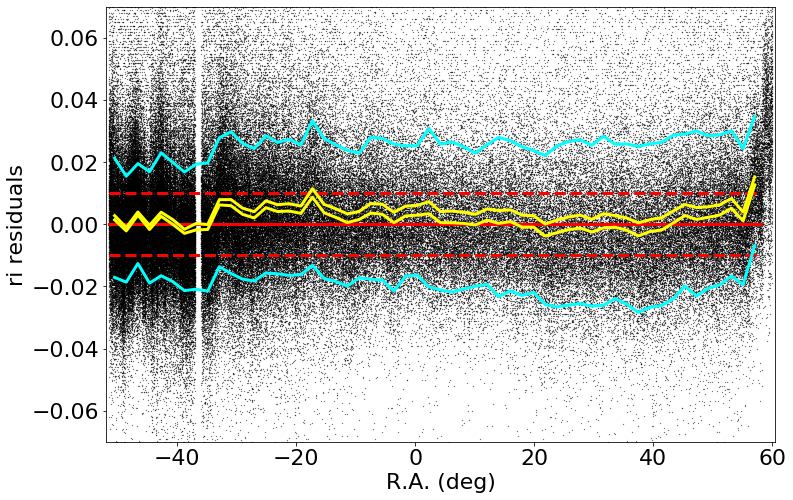

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002563636779783607 std.dev: 0.0030508522614896665
saved plot as: colorResidGaiaColorsRecalib_ri_RA_Hess.png


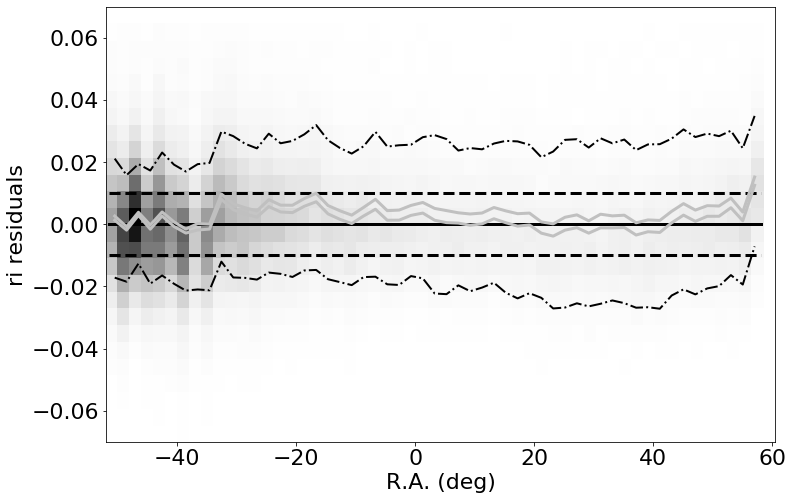

made plot colorResidGaiaColorsRecalib_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0034760000228892113 std.dev: 0.003161840428203877
saved plot as: colorResidGaiaColorsRecalib_ri_Dec.png


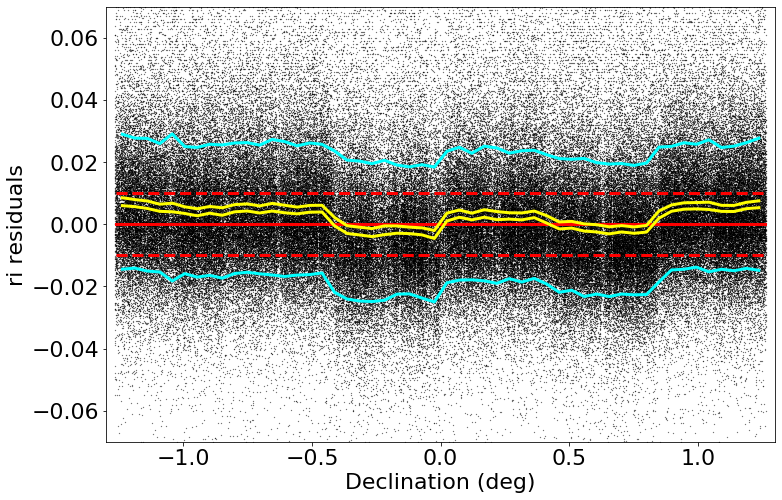

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0034558624267602978 std.dev: 0.0031867490869977298
saved plot as: colorResidGaiaColorsRecalib_ri_Dec_Hess.png


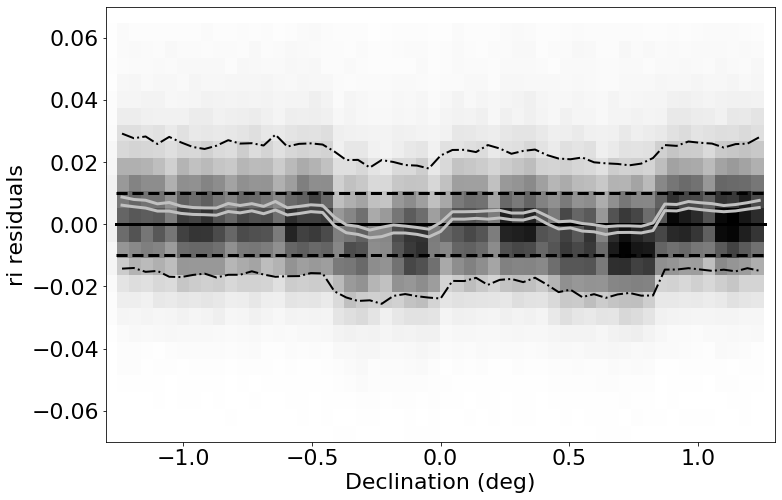

made plot colorResidGaiaColorsRecalib_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0026842788696298803 std.dev: 0.08079765933446732
saved plot as: colorResidGaiaColorsRecalib_ri_rmag.png


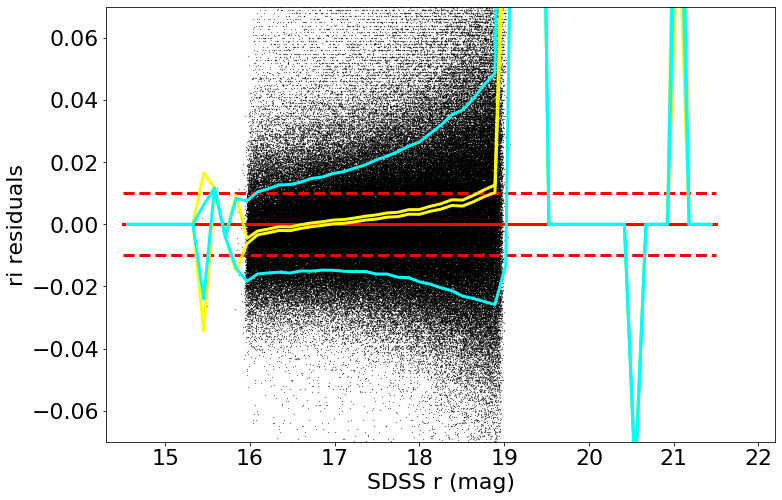

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.0026842788696298803 std.dev: 0.08079765933446732
saved plot as: colorResidGaiaColorsRecalib_ri_rmag_Hess.png


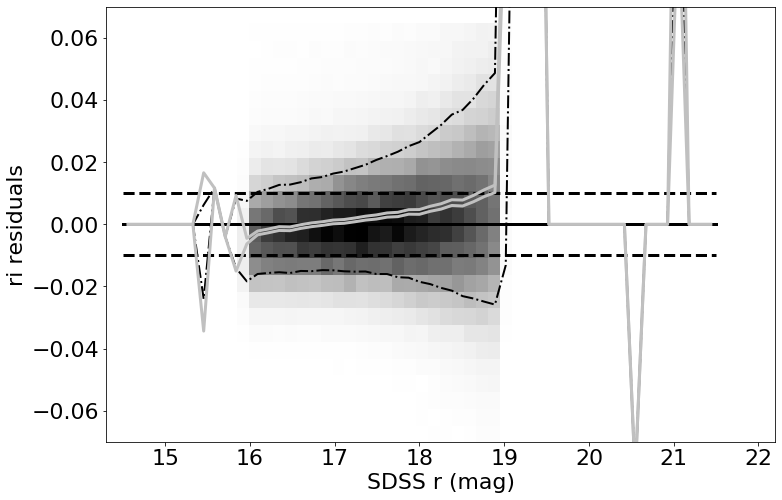

made plot colorResidGaiaColorsRecalib_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002514898681637623 std.dev: 0.003964240882140641
saved plot as: colorResidGaiaColorsRecalib_ri_Gmag.png


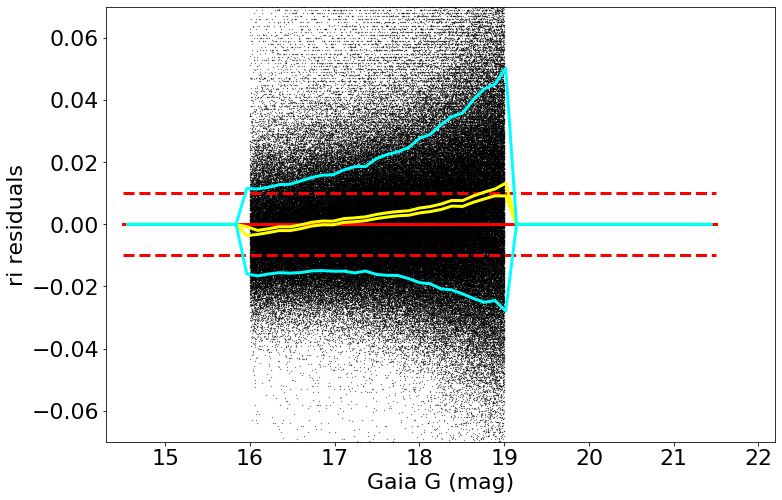

medianAll: 0.0028582725524915337 std.dev.All: 0.021511949618912007
N= 255040 min= -0.2989999999999995 max= 0.29999999999999893
median: 0.002514898681637623 std.dev: 0.003964240882140641
saved plot as: colorResidGaiaColorsRecalib_ri_Gmag_Hess.png


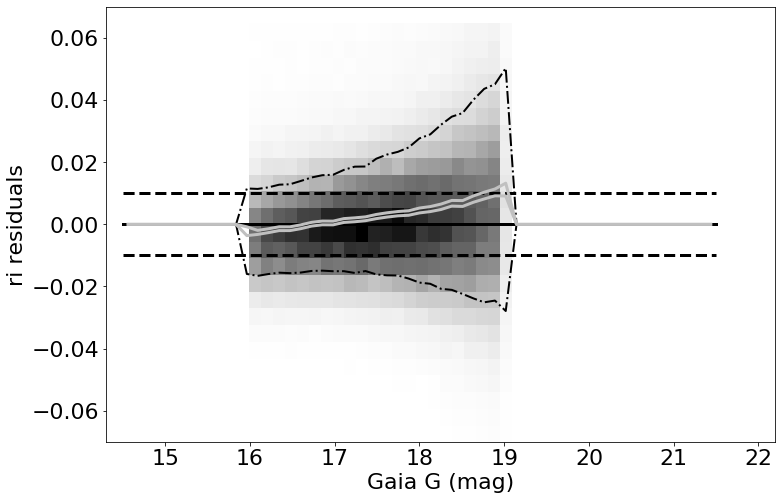

made plot colorResidGaiaColorsRecalib_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0011439908981312405 std.dev: 0.007261801164620444
saved plot as: colorResidGaiaColorsRecalib_rz_RA.png


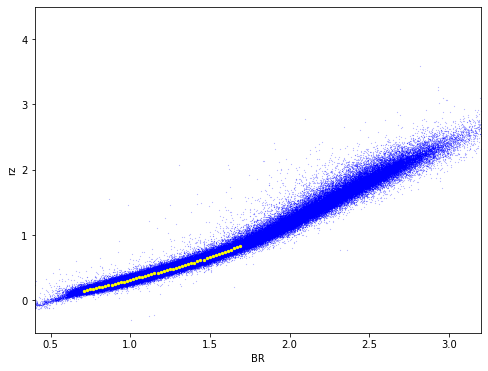

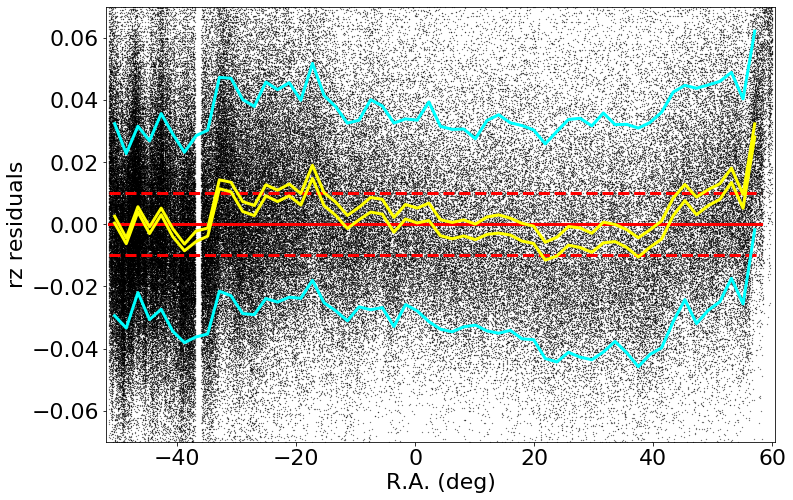

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0012431060791023851 std.dev: 0.007258485651324475
saved plot as: colorResidGaiaColorsRecalib_rz_RA_Hess.png


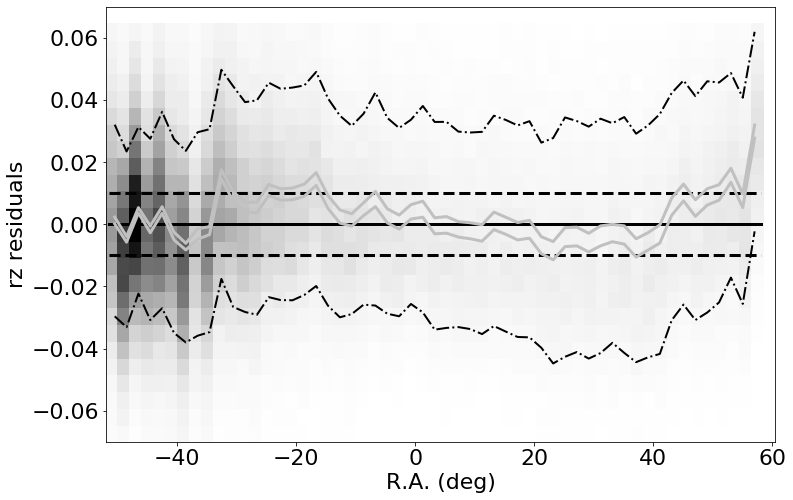

made plot colorResidGaiaColorsRecalib_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003175690460204897 std.dev: 0.0031298441492516914
saved plot as: colorResidGaiaColorsRecalib_rz_Dec.png


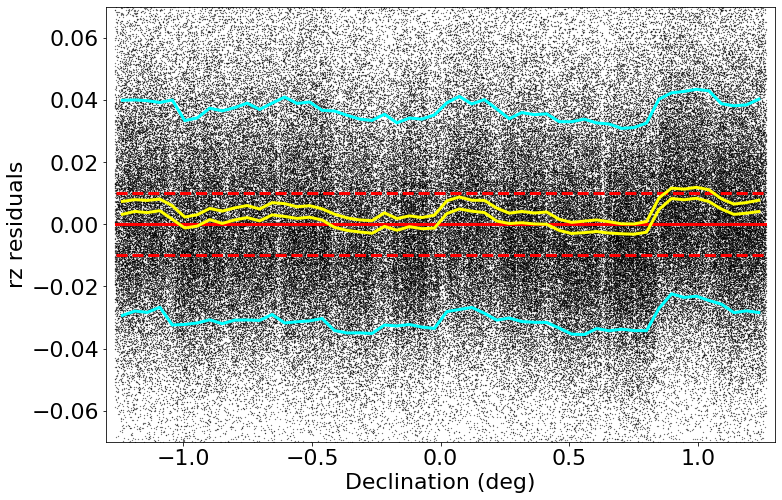

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003140780639649454 std.dev: 0.0031549248493672605
saved plot as: colorResidGaiaColorsRecalib_rz_Dec_Hess.png


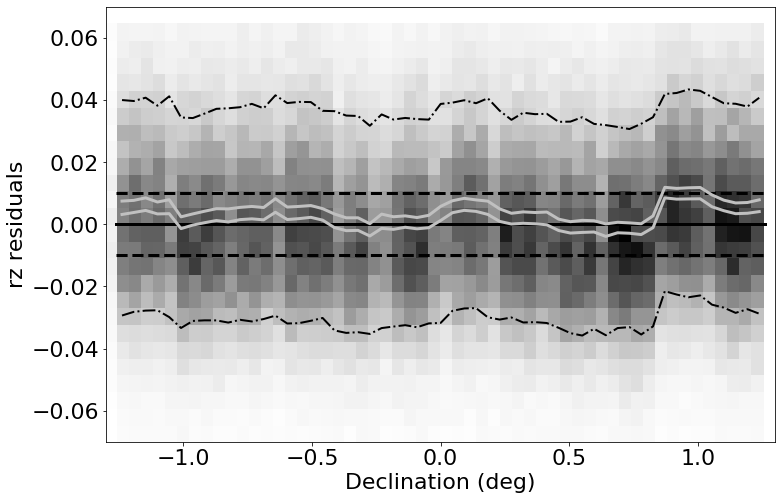

made plot colorResidGaiaColorsRecalib_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0024559001922614676 std.dev: 0.06943093576004734
saved plot as: colorResidGaiaColorsRecalib_rz_rmag.png


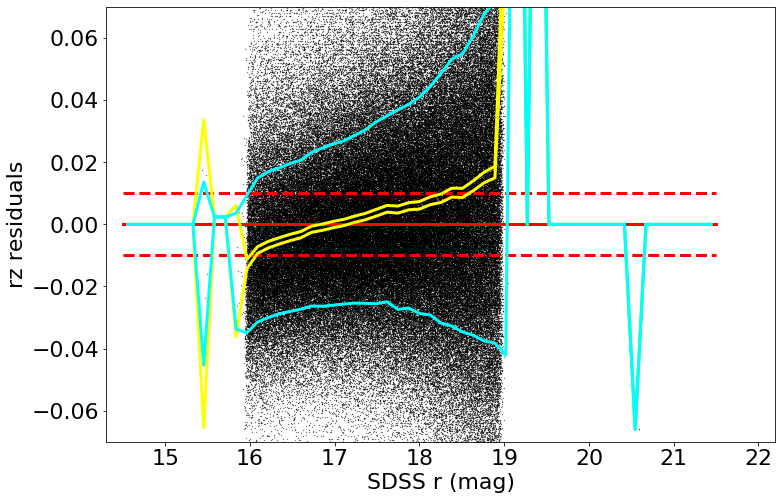

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0024559001922614676 std.dev: 0.06943093576004734
saved plot as: colorResidGaiaColorsRecalib_rz_rmag_Hess.png


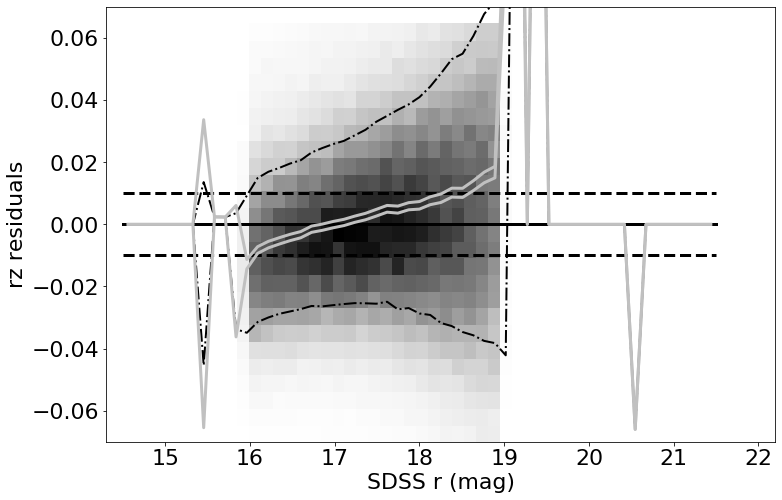

made plot colorResidGaiaColorsRecalib_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0038016754150417276 std.dev: 0.007262221755491843
saved plot as: colorResidGaiaColorsRecalib_rz_Gmag.png


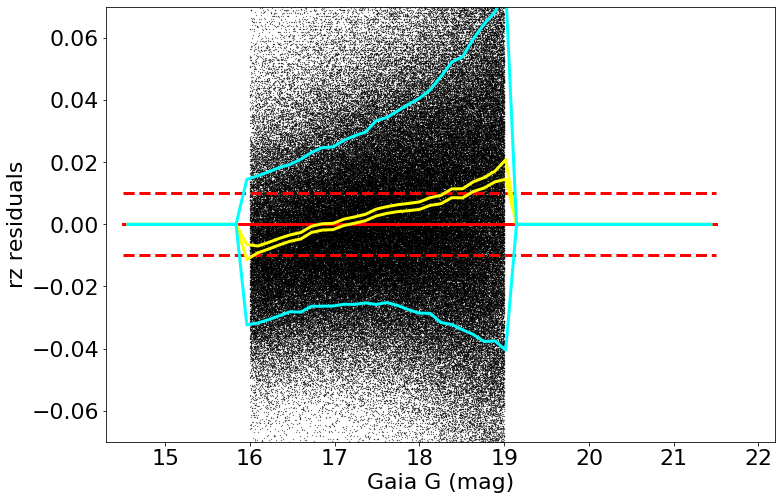

medianAll: 0.0032336441040045905 std.dev.All: 0.033962177663042326
N= 243458 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0038016754150417276 std.dev: 0.007262221755491843
saved plot as: colorResidGaiaColorsRecalib_rz_Gmag_Hess.png


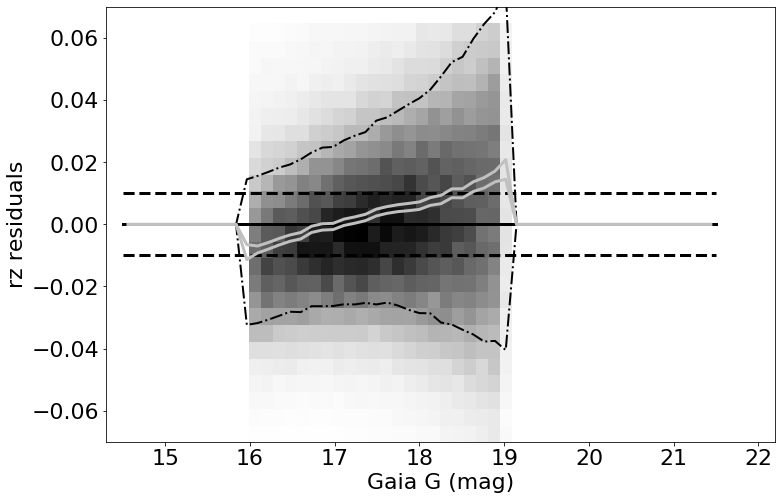

made plot colorResidGaiaColorsRecalib_rz_Gmag_Hess.png
------------------------------------------------------------------


In [19]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsRecalib_', "symbSize":0.05}
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesB, keywords)

In [20]:
d = matchesUR
xVec = d['BR'] 
yVec = d['ur']
# 
xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 40, 0)
d['colorresid'] = yVec - np.interp(xVec, xBin, medianBin)  
goodC = d[np.abs(d['colorresid'])<0.3]
# goodC['colorresid'] = goodC['colorresid'] - np.median(goodC['colorresid'])

medianAll: 0.005654479980468086 std.dev.All: 0.11901861925506771
N= 153999 min= -0.2999947509765619 max= 0.29997547912597655
median: 0.007313022613526177 std.dev: 0.020436149287761936
saved plot as: colorResidGaiaColorsB_urResiduals_Dec.png


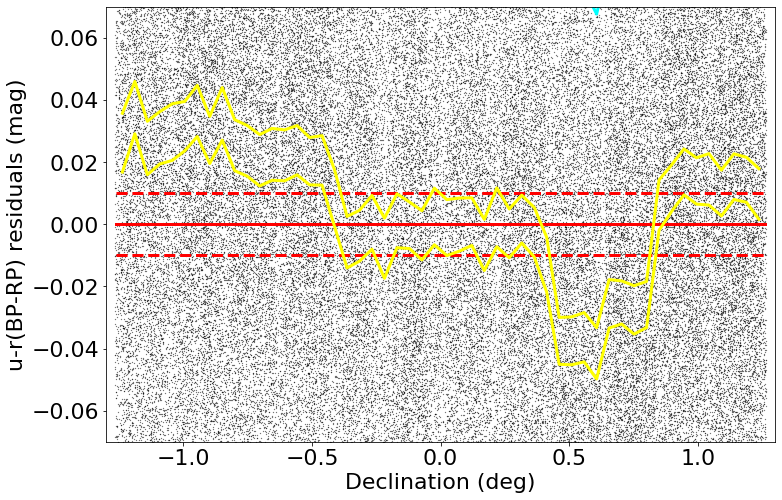

In [21]:
plotName = 'colorResidGaiaColorsB_urResiduals_Dec.png' 
Ylabel = 'u-r(BP-RP) residuals (mag)'
kwOC = {"Xstr":'dec', "Xmin":-1.3, "Xmax":1.3, "Xlabel":'Declination (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-1.26, "XmaxBin":1.26, "nBin":52, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":0.05}
zit.plotdelMag(goodC, kwOC)

medianAll: 0.005654479980468086 std.dev.All: 0.11901861925506771
N= 153999 min= -0.2999947509765619 max= 0.29997547912597655
median: 0.014281986236571953 std.dev: 0.03412214005452323
saved plot as: colorResidGaiaColorsB_urResiduals_RA.png


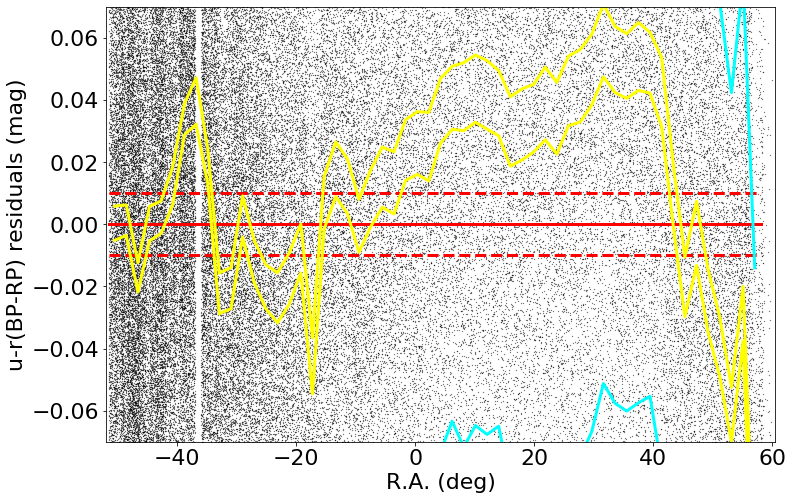

In [22]:
plotName = 'colorResidGaiaColorsB_urResiduals_RA.png' 
Ylabel = 'u-r(BP-RP) residuals (mag)'
kwOC = {"Xstr":'raW', "Xmin":-52, "Xmax":60.5, "Xlabel":'R.A. (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-51.5, "XmaxBin":58, "nBin":56, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":0.05}
zit.plotdelMag(goodC, kwOC)

In [23]:
xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['dec'], goodC['colorresid'], -1.26, 1.26, 52, 1)
np.savetxt('ZPcorrectionsDec_ur_v3.2_final.dat', (xBin, medianBin)) 

median: 0.007313022613526177 std.dev: 0.020436149287761936


In [24]:
xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['raW'], goodC['colorresid'], -51.5, 58, 56, 1)
# we cannot confirm the RA behavior with CFIS data: it's better to leave it as it is
medianBin = 0.0*medianBin
np.savetxt('ZPcorrectionsRA_ur_v3.2_final.dat', (xBin, medianBin)) 

median: 0.014281986236571953 std.dev: 0.03412214005452323


In [25]:
d = matchesRecalib  
xVec = d['BR'] 
for color in ('gr', 'ri', 'rz'):
    yVec = d[color]
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 40, 0)
    d['colorresid'] = yVec - np.interp(xVec, xBin, medianBin)  
    goodC = d[np.abs(d['colorresid'])<0.1]
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['dec'], goodC['colorresid'], -1.26, 1.26, 52, 1)
    fname = 'ZPcorrectionsDec_' + color + '_v3.2_final.dat'
    np.savetxt(fname, (xBin, medianBin)) 
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['raW'], goodC['colorresid'], -51.5, 58, 56, 1)
    fname = 'ZPcorrectionsRA_' + color + '_v3.2_final.dat'
    np.savetxt(fname, (xBin, medianBin)) 

median: -0.006419776916503694 std.dev: 0.0042388401787634925
median: -0.004918426513670887 std.dev: 0.004028089096369865
median: -0.0035184402465822245 std.dev: 0.003320680659917092
median: -0.006606328964233285 std.dev: 0.004289656814567534
median: -0.010694496154786806 std.dev: 0.0029990170331814004
median: -0.011874187469482461 std.dev: 0.00803460000000006


In [26]:
sdssOut = sdss[sdss['ra_new']<1000] 
print(np.size(sdssOut))

991472


In [27]:
decGrid2correct = sdssOut['dec_new']
# RA correction 
ra = sdssOut['ra_new'] 
raWGrid2correct = np.where(ra > 180, ra-360, ra) 

In [28]:
## apply color corrections 
for mtype in ('_mMed_new', '_mMean_new'):
    ## u band from u-r color
    color = 'ur'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v3.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v3.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    print('u-r std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    mstr = 'u' + mtype
    sdssOut[mstr] = sdssOut[mstr] - ZPcorrectionsRA - ZPcorrectionsDec 
    ## g band from g-r color
    color = 'gr'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v3.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v3.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    print('g-r std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    mstr = 'g' + mtype
    sdssOut[mstr] = sdssOut[mstr] - ZPcorrectionsRA - ZPcorrectionsDec 
    ## i band from r-i color
    color = 'ri'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v3.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v3.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    mstr = 'i' + mtype
    print('r-i std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    sdssOut[mstr] = sdssOut[mstr] + ZPcorrectionsRA + ZPcorrectionsDec 
    ## i band from r-z color
    color = 'rz'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v3.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v3.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    mstr = 'z' + mtype
    print('r-z std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    sdssOut[mstr] = sdssOut[mstr] + ZPcorrectionsRA + ZPcorrectionsDec 

u-r std RA/Dec: 0.0 0.020141899504132123
g-r std RA/Dec: 0.004001373095753368 0.004181215061857433
r-i std RA/Dec: 0.004096918147652335 0.0032356439431044963
r-z std RA/Dec: 0.007404976236445828 0.0028925171999158255
u-r std RA/Dec: 0.0 0.020141899504132123
g-r std RA/Dec: 0.004001373095753368 0.004181215061857433
r-i std RA/Dec: 0.004096918147652335 0.0032356439431044963
r-z std RA/Dec: 0.007404976236445828 0.0028925171999158255


In [29]:
SSCindexRoot = 'CALIBSTARS_'
outFile = ZIdataDir + "/" + "stripe82calibStars_v3.2_noheader_final.dat"
newSSC = open(outFile,'w')
df = sdssOut
Ngood = 0
for i in range(0, np.size(df)):
    Ngood += 1
    NoldCat = df['calib_fla_new'][i]
    strNo = f'{Ngood:07}'
    SSCindex = SSCindexRoot + strNo 
    SSCrow = zit.getSSCentry(df, i)
    zit.SSCentryToOutFileRow(SSCrow, SSCindex, newSSC) 
newSSC.close()
print(Ngood, 'rows in file', outFile)

991472 rows in file /Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data/stripe82calibStars_v3.2_noheader_final.dat


<a id='dataReading'></a>

### Test v3.3

In [31]:
# Karun's new catalog from 2020, after Gmag-based gray and BP-RP color corrections 
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v3.3.dat"
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

991472

In [32]:
sdssOld_coords = SkyCoord(ra = sdssOld['ra']*u.degree, dec= sdssOld['dec']*u.degree) 
sdssNew_coords = SkyCoord(ra = sdssNew['ra']*u.degree, dec= sdssNew['dec']*u.degree) 
# this is matching sdssNew to sdssOld, so that indices are into sdssNew catalog
# makes sense in this case since the sdssOld catalog is (a little bit) bigger 
# than sdssNew (1006849 vs 1005470)
idx, d2d, d3d = sdssNew_coords.match_to_catalog_sky(sdssOld_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
new_old = hstack([sdssNew, sdssOld[idx]], table_names = ['new', 'old'])
new_old['sep_2d_arcsec'] = d2d.arcsec
# good matches between the old and new catalogs
MAX_DISTANCE_ARCSEC = 0.5
sdss = new_old[(new_old['sep_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]
print(np.size(sdss))

991472


In [33]:
sdss_coords = SkyCoord(ra = sdss['ra_old']*u.degree, dec= sdss['dec_old']*u.degree) 
gaia_coords = SkyCoord(ra = gaia['raG']*u.degree, dec= gaia['decG']*u.degree) 

# this is matching gaia to sdss, so that indices are into sdss catalog
# makes sense in this case since the sdss catalog is bigger than gaia
idxG, d2dG, d3dG = gaia_coords.match_to_catalog_sky(sdss_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
gaia_sdss = hstack([gaia, sdss[idxG]], table_names = ['gaia', 'sdss'])
gaia_sdss['sepSG_2d_arcsec'] = d2dG.arcsec
derivedColumns(gaia_sdss)

In [34]:
MAX_DISTANCE_ARCSEC = 0.5
matches = gaia_sdss[(gaia_sdss['sepSG_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]

=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.014591493988037607 std.dev: 0.014805485113132072
saved plot as: colorResidGaiaColors_ur_RA.png


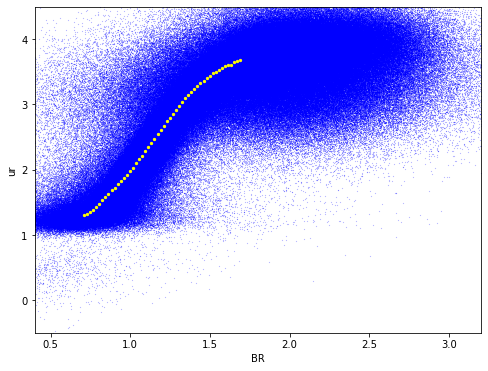

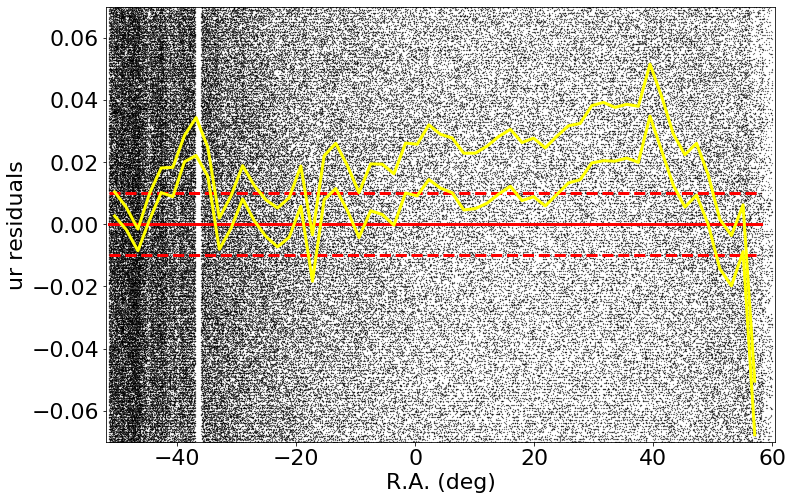

medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.015272676086424575 std.dev: 0.01484773001940086
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


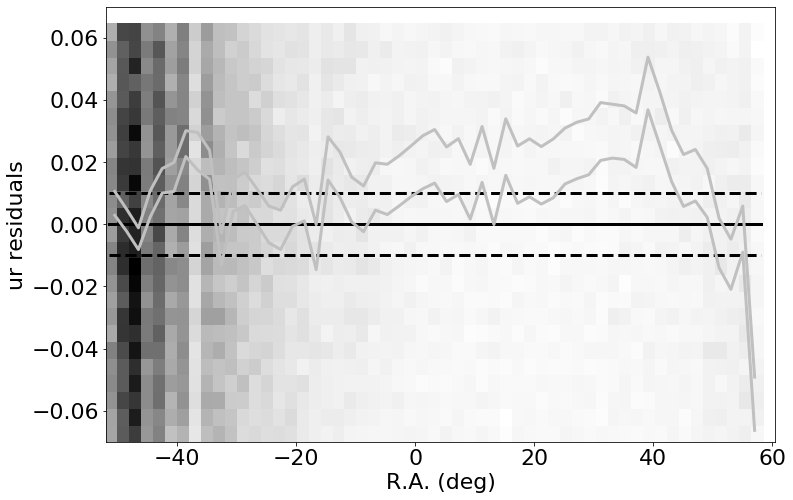

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009873585510252525 std.dev: 0.0024443160814632556
saved plot as: colorResidGaiaColors_ur_Dec.png


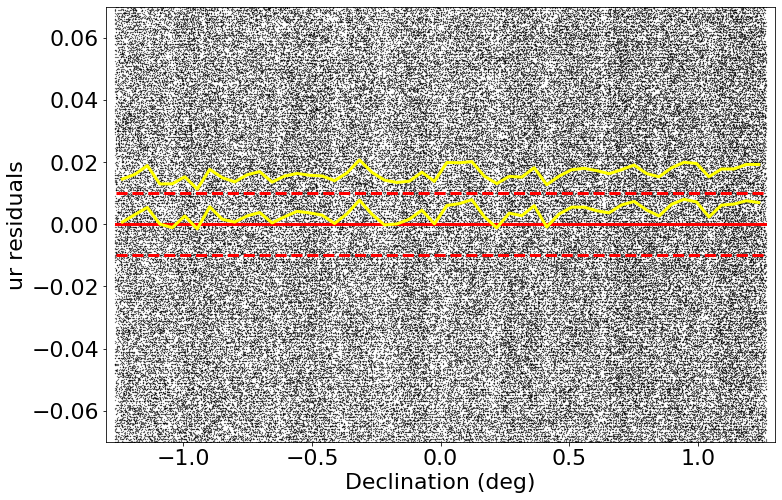

medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.01021072998046968 std.dev: 0.0031242603169094785
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


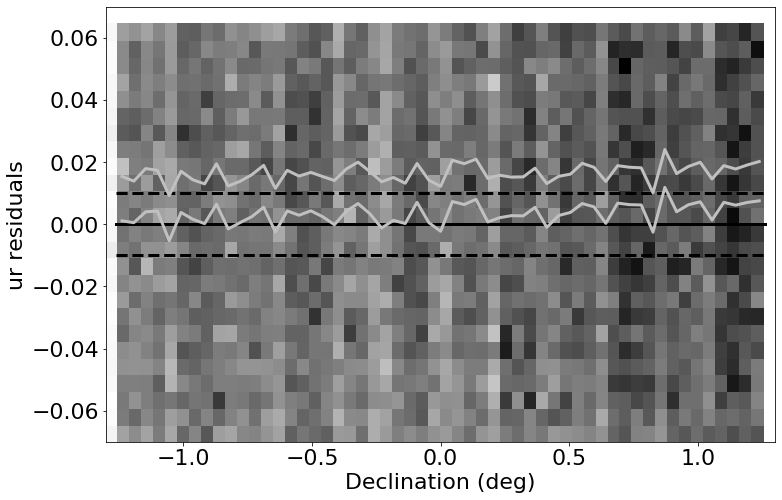

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0009007980346655842 std.dev: 0.05619201129476848
saved plot as: colorResidGaiaColors_ur_rmag.png


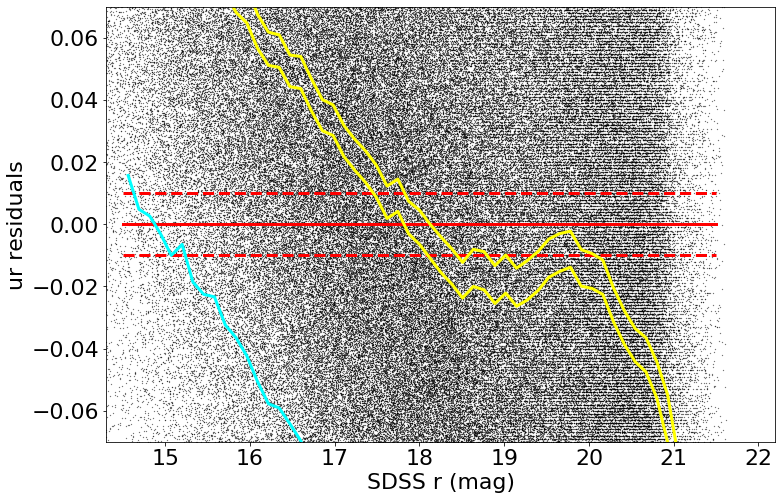

medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0009007980346655842 std.dev: 0.05619201129476848
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


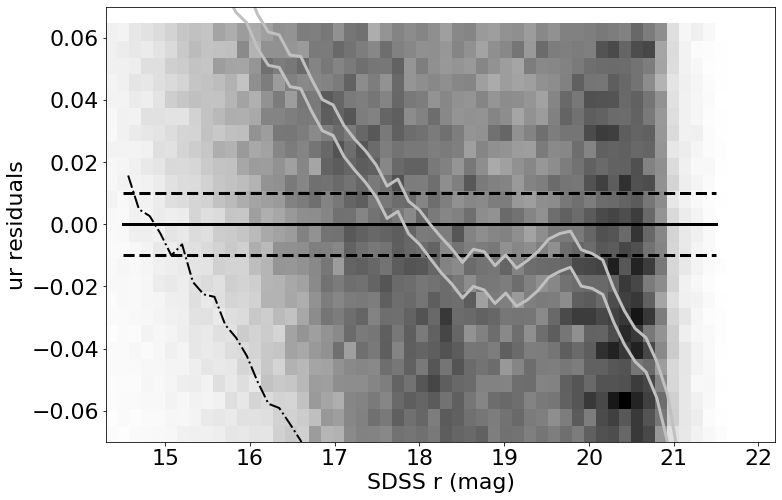

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.013157026672362848 std.dev: 0.05022067410685196
saved plot as: colorResidGaiaColors_ur_Gmag.png


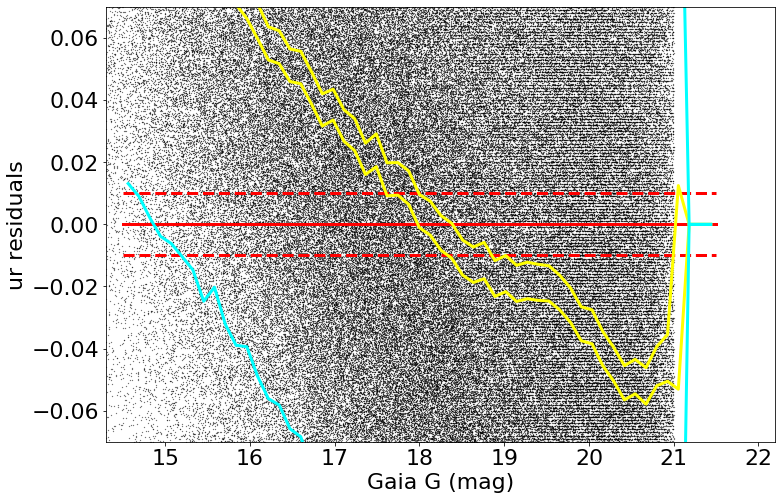

medianAll: 0.010066751098632087 std.dev.All: 0.16855002908935876
N= 522713 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.013157026672362848 std.dev: 0.05022067410685196
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


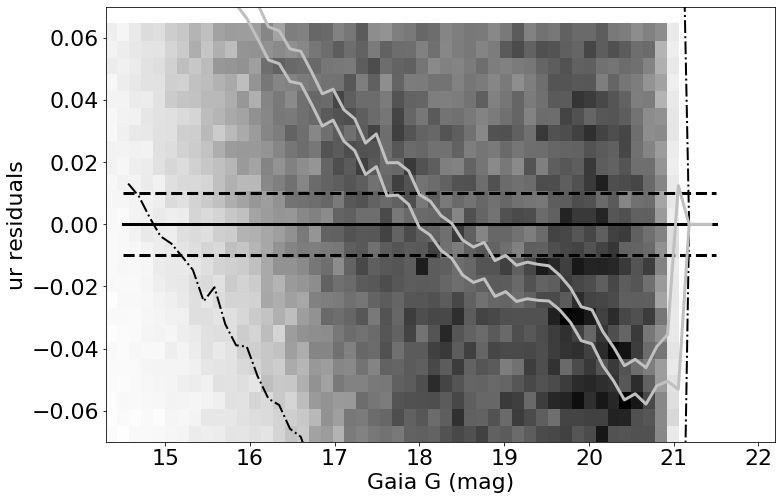

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.02254199542999348 std.dev: 0.009024906787393707
saved plot as: colorResidGaiaColors_gr_RA.png


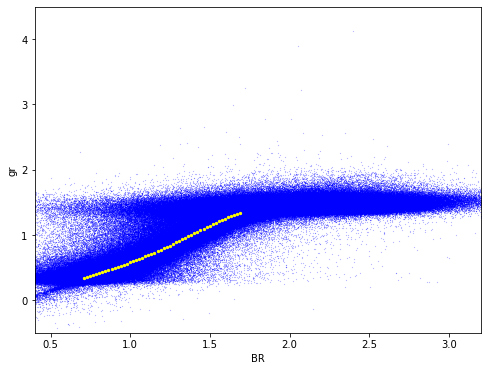

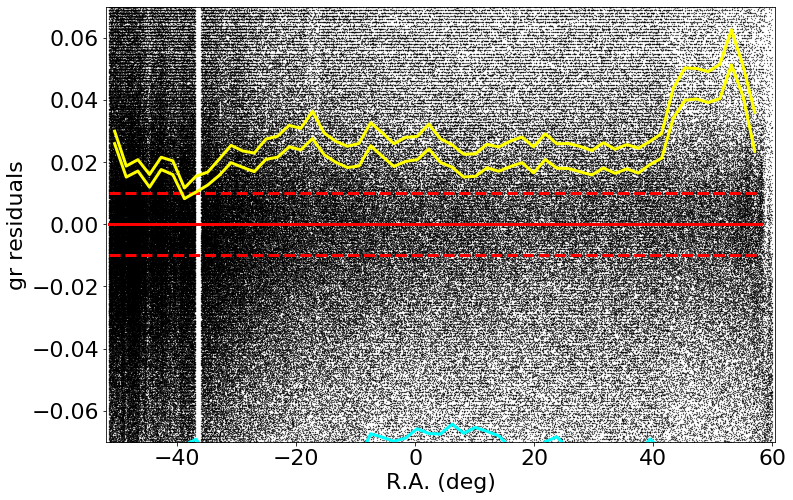

medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.02298778686523406 std.dev: 0.009014470111331257
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


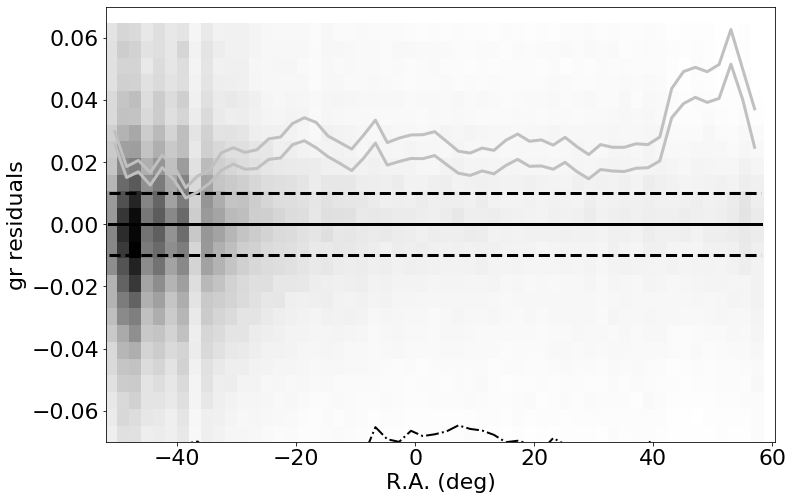

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.021618050003052225 std.dev: 0.002905766197488314
saved plot as: colorResidGaiaColors_gr_Dec.png


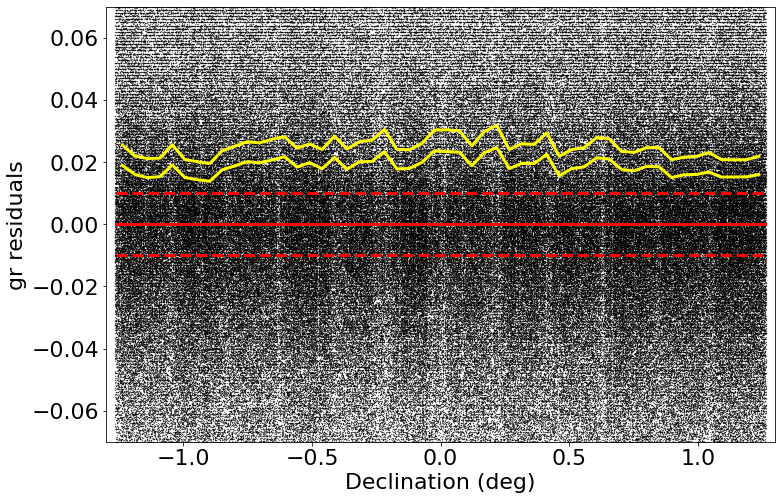

medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.021999999999998465 std.dev: 0.0030666086728231463
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


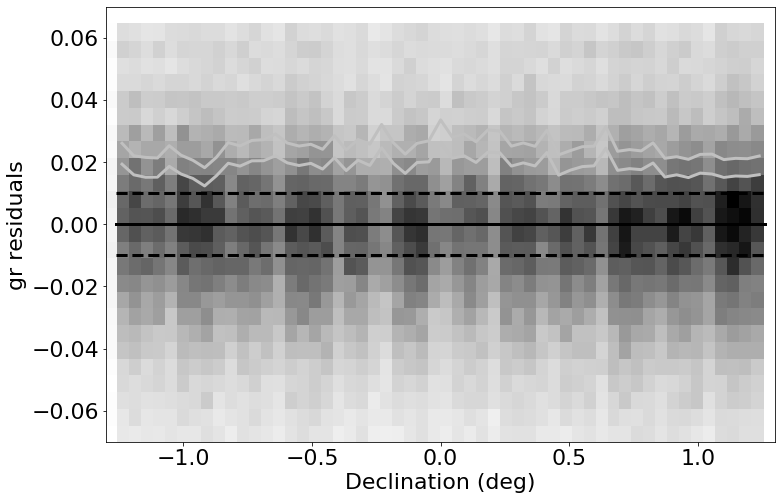

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.004999999999999005 std.dev: 0.04622973383010147
saved plot as: colorResidGaiaColors_gr_rmag.png


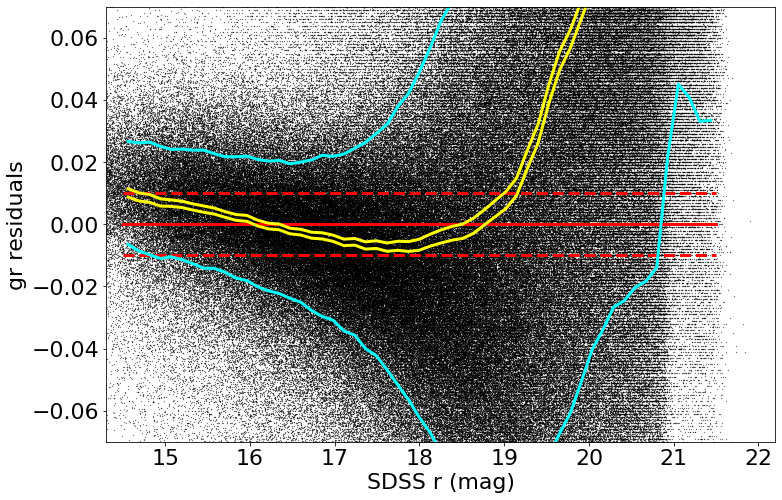

medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.004999999999999005 std.dev: 0.04622973383010147
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


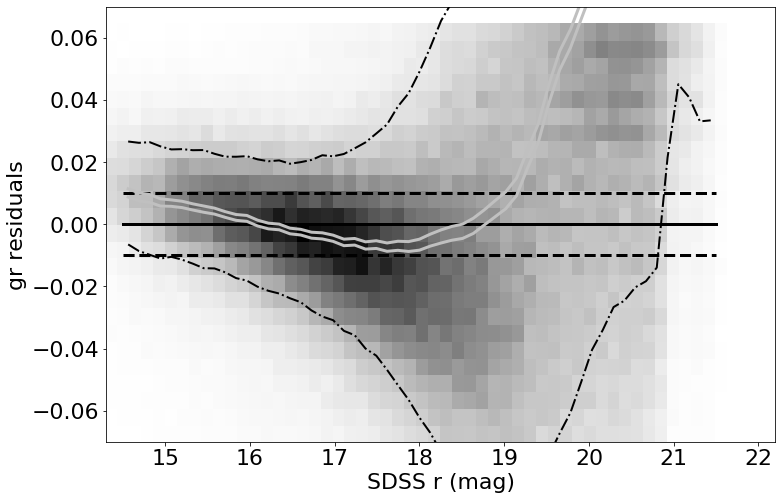

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.005636405372620418 std.dev: 0.03533489690070099
saved plot as: colorResidGaiaColors_gr_Gmag.png


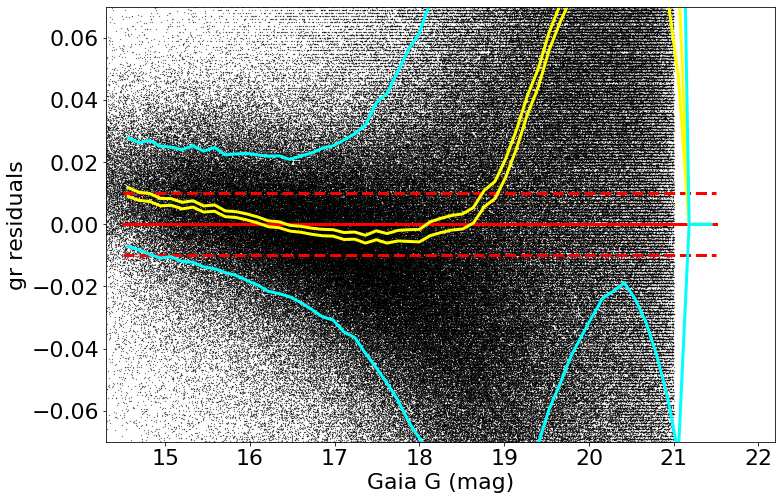

medianAll: 0.021445344543458977 std.dev.All: 0.10028859259643719
N= 768654 min= -0.2999619522094714 max= 0.29999999999999716
median: 0.005636405372620418 std.dev: 0.03533489690070099
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


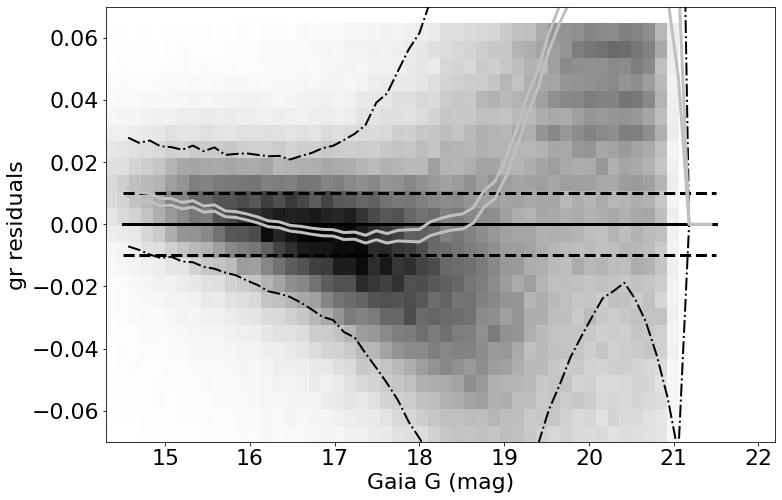

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0002082031250020544 std.dev: 0.0014918811063408274
saved plot as: colorResidGaiaColors_ri_RA.png


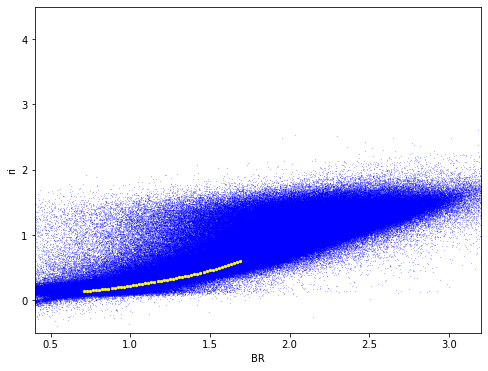

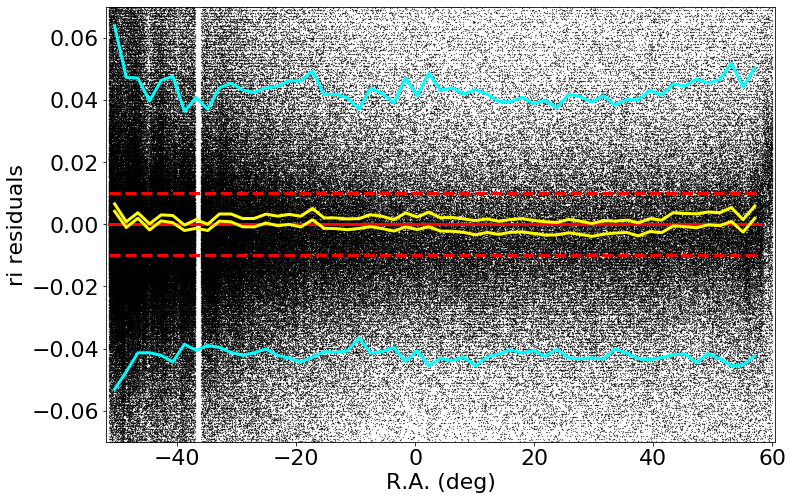

medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.00022507705688482038 std.dev: 0.0015525199619783575
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


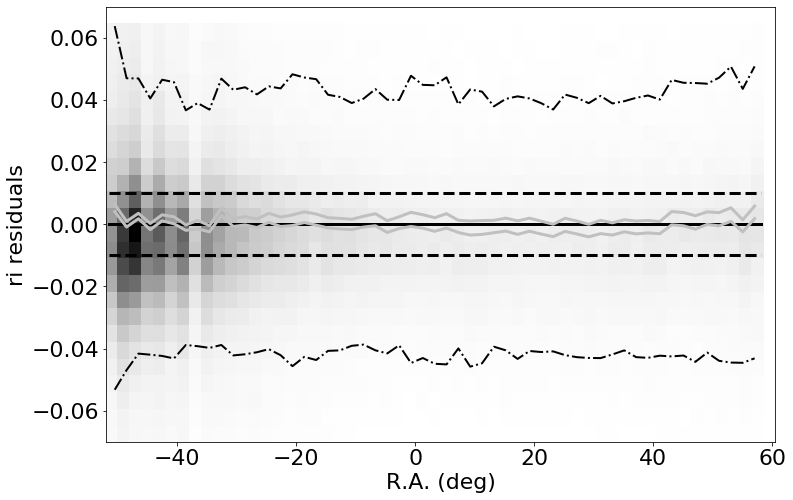

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0010000000000012221 std.dev: 0.0006045469718667676
saved plot as: colorResidGaiaColors_ri_Dec.png


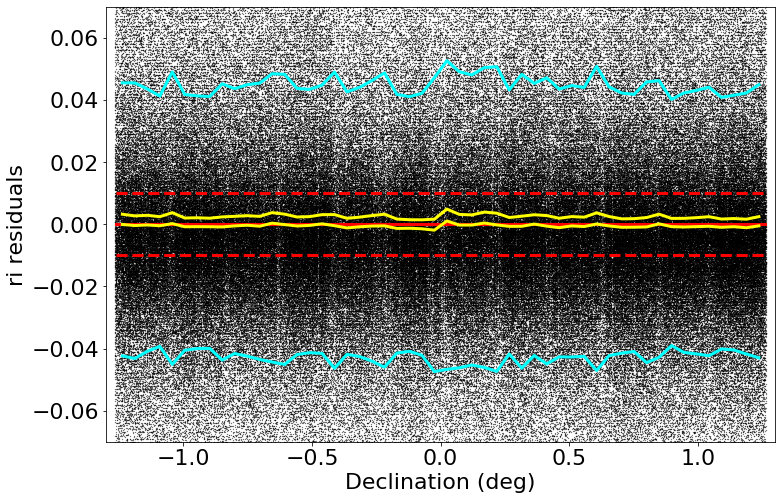

medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0010000000000012221 std.dev: 0.0005589480870856296
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


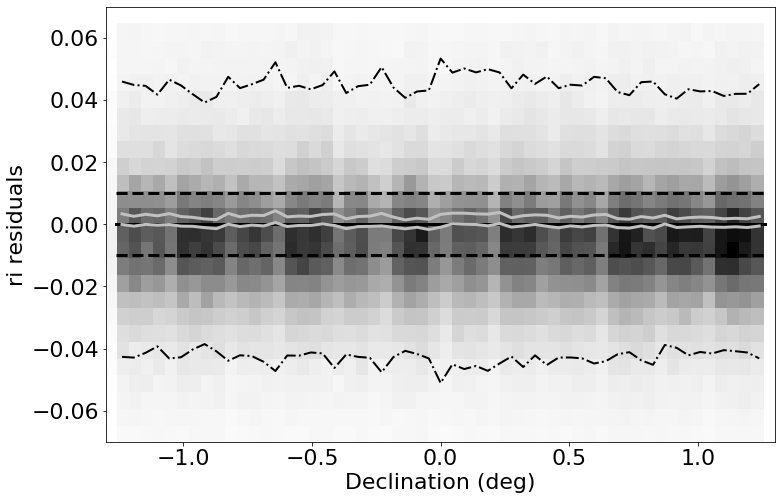

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0031073638916001567 std.dev: 0.05144713536774649
saved plot as: colorResidGaiaColors_ri_rmag.png


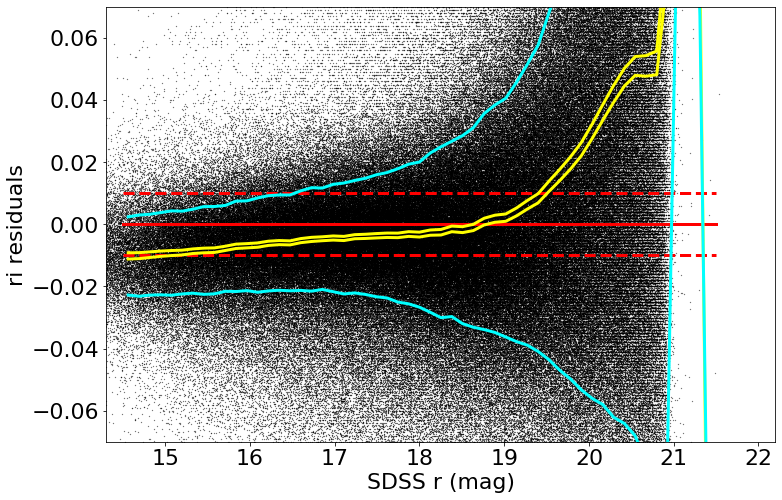

medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0031073638916001567 std.dev: 0.05144713536774649
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


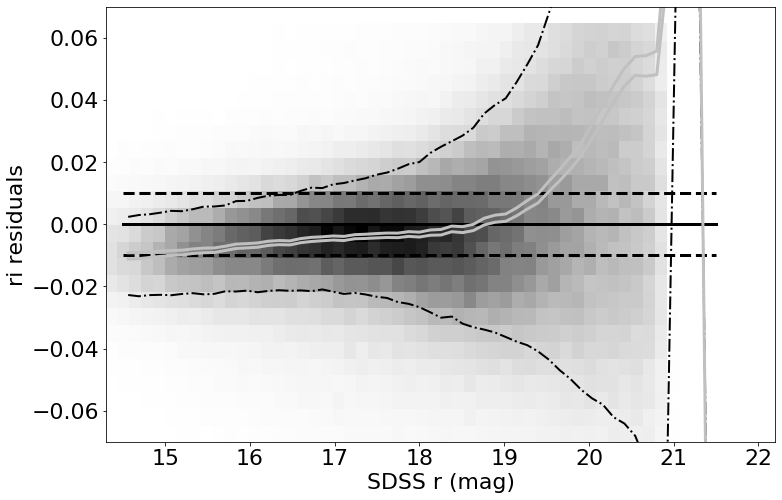

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0031342113494882834 std.dev: 0.018105282719996244
saved plot as: colorResidGaiaColors_ri_Gmag.png


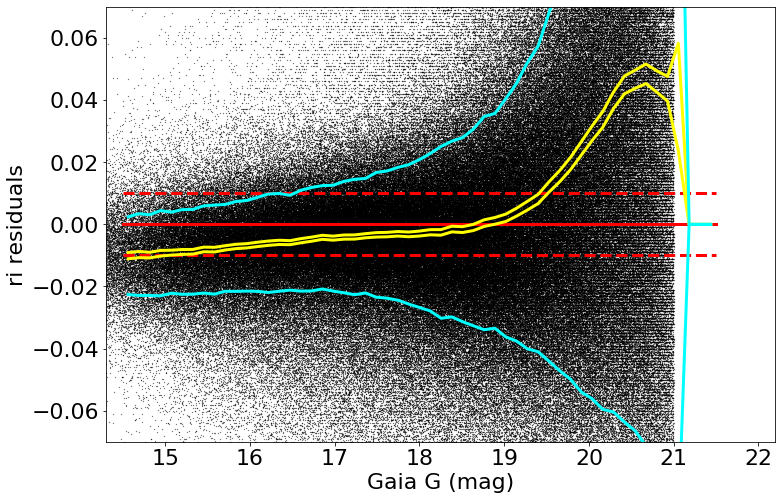

medianAll: 0.0009999999999994458 std.dev.All: 0.04372451148147752
N= 597171 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0031342113494882834 std.dev: 0.018105282719996244
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


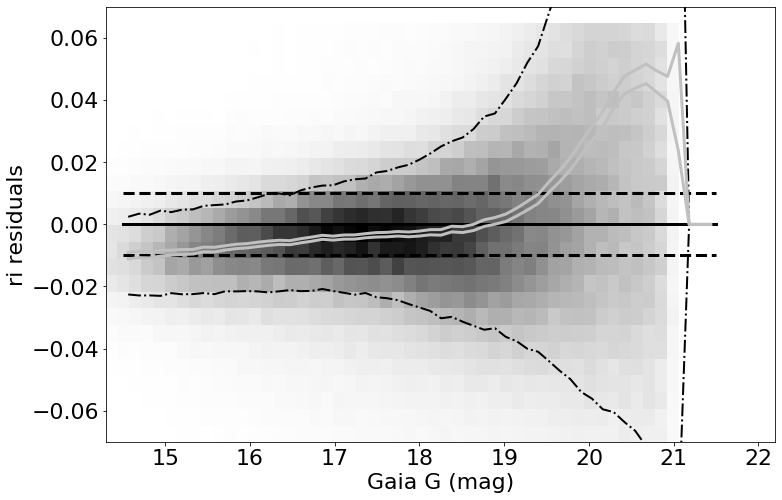

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.003504598236084275 std.dev: 0.0024117927211808605
saved plot as: colorResidGaiaColors_rz_RA.png


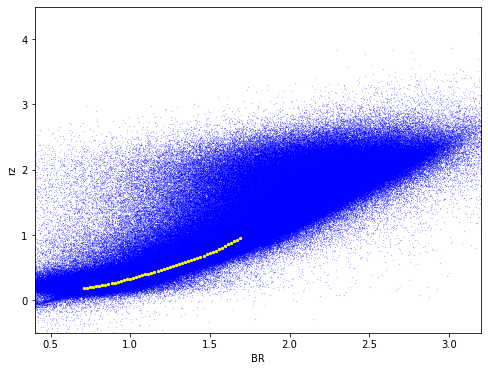

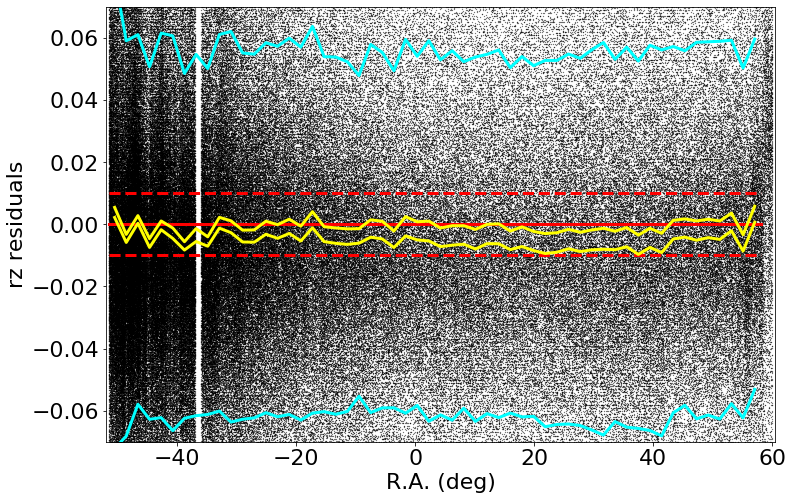

medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.0035119873046864925 std.dev: 0.0024902679113471904
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


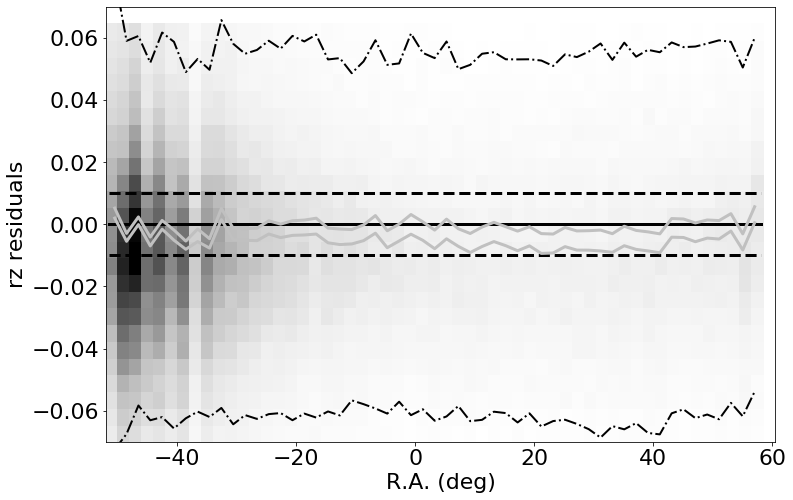

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.00213626708984245 std.dev: 0.0007793653237461705
saved plot as: colorResidGaiaColors_rz_Dec.png


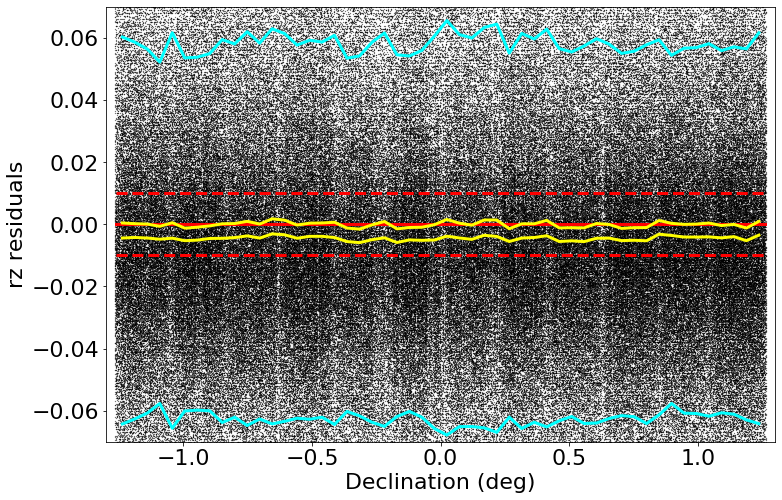

medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.0022766174316390386 std.dev: 0.00087508835006494
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


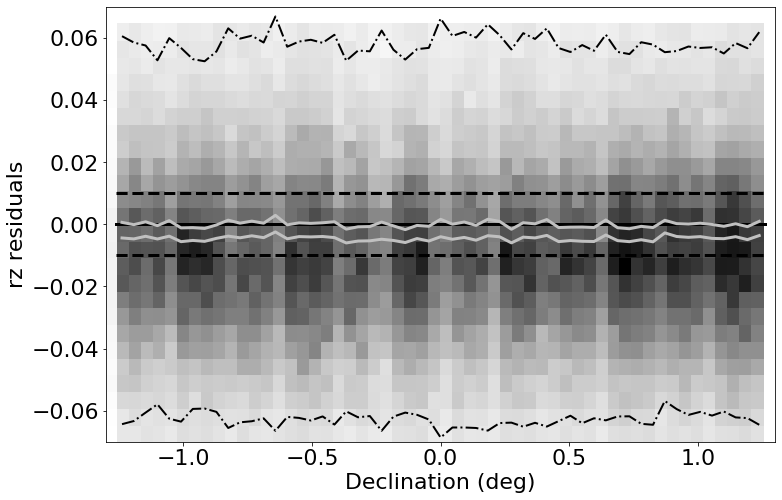

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.0065145622253414415 std.dev: 0.0579235890874717
saved plot as: colorResidGaiaColors_rz_rmag.png


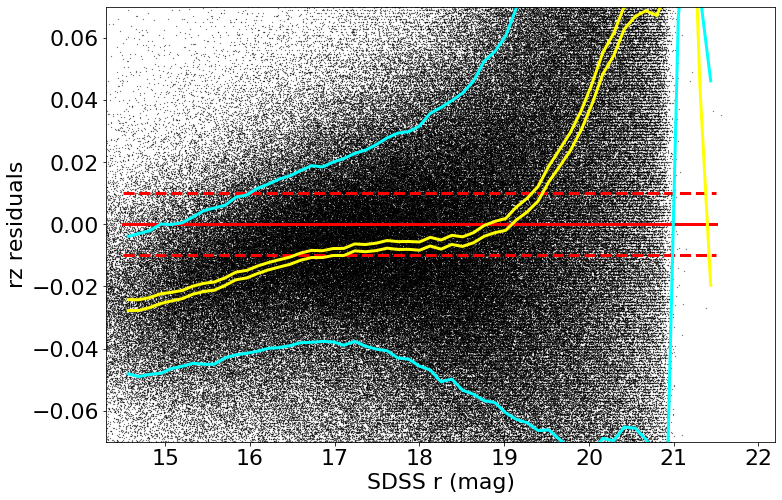

medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.0065145622253414415 std.dev: 0.0579235890874717
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


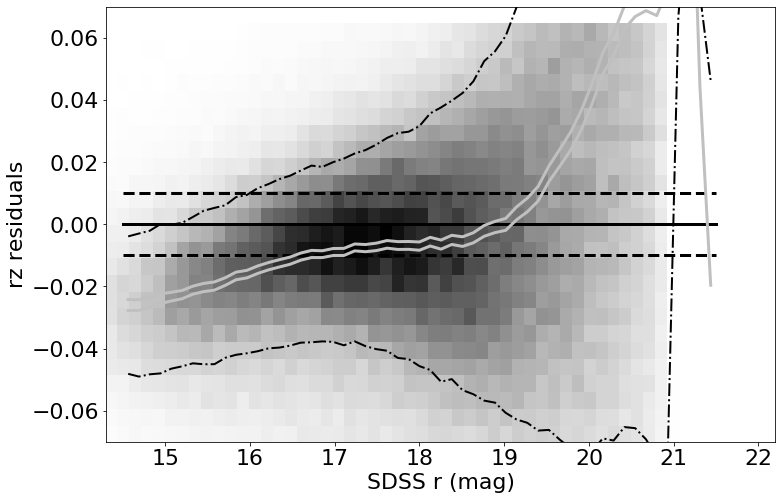

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.006536029052734926 std.dev: 0.028384345752849302
saved plot as: colorResidGaiaColors_rz_Gmag.png


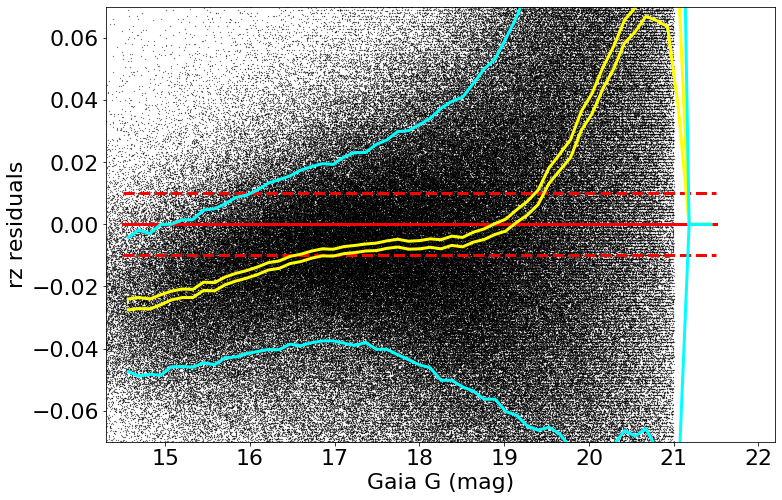

medianAll: -0.002278643798825808 std.dev.All: 0.06047897420425556
N= 548739 min= -0.29999999999999893 max= 0.29999999999999893
median: -0.006536029052734926 std.dev: 0.028384345752849302
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


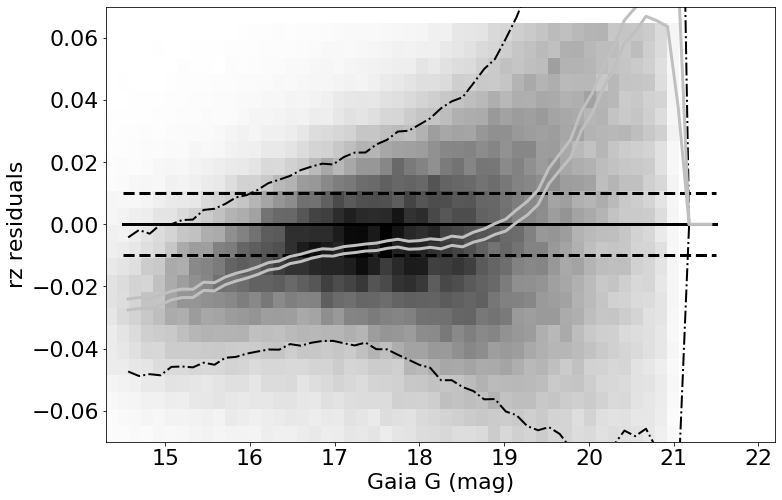

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [35]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColors_', "symbSize":0.05}
for color in ('ur', 'gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matches, keywords)

In [36]:
matchesB = matches[(matches['Gmag']>16)&(matches['Gmag']<19)]
matchesRecalib = matchesB[(matchesB['BR']>0.7)&(matchesB['BR']<1.7)]
matchesRecalibUR = matchesRecalib[(matchesRecalib['u_mMed_new']<20.0)]
print(np.size(matches), np.size(matches), np.size(matchesRecalib), np.size(matchesRecalibUR))

885408 885408 212935 108866


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: 0.009719722747803805 std.dev: 0.031766291154377645
saved plot as: colorResidGaiaColors_ur_RA.png


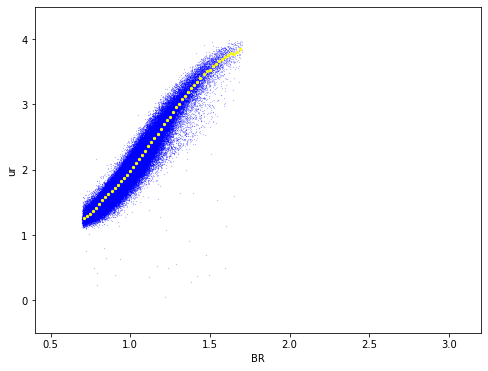

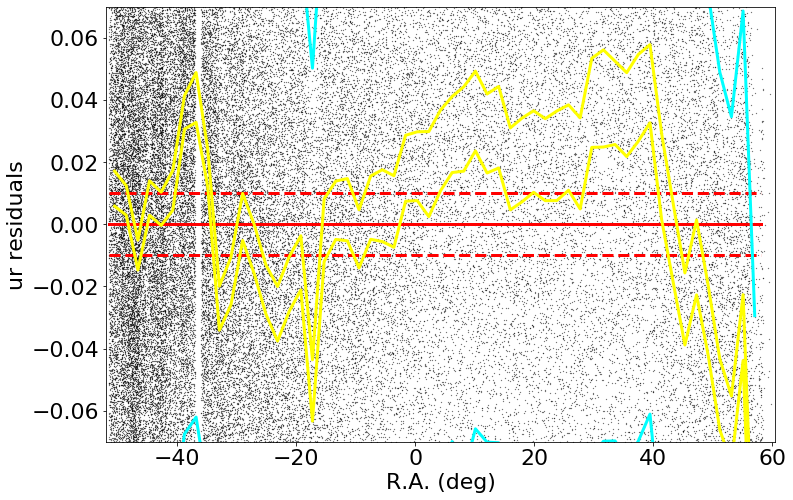

medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: 0.011466067504884991 std.dev: 0.03174758214366307
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


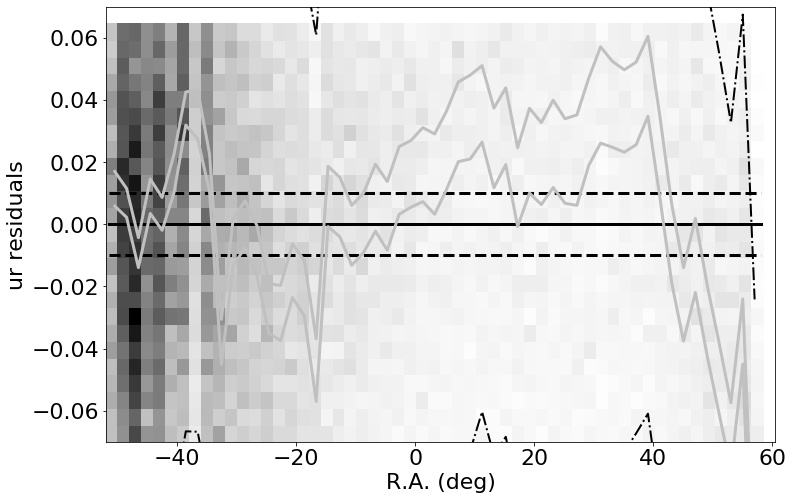

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: 0.0007056892395030379 std.dev: 0.005005573763429216
saved plot as: colorResidGaiaColors_ur_Dec.png


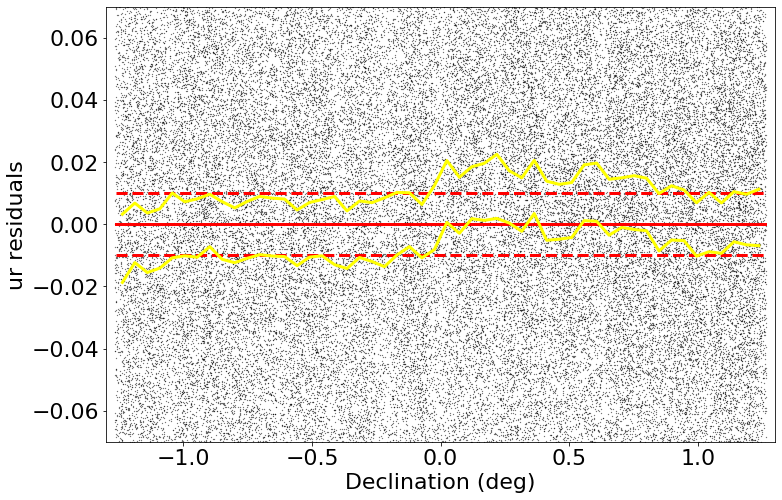

medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: 0.0010204093933118275 std.dev: 0.005409182949698387
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


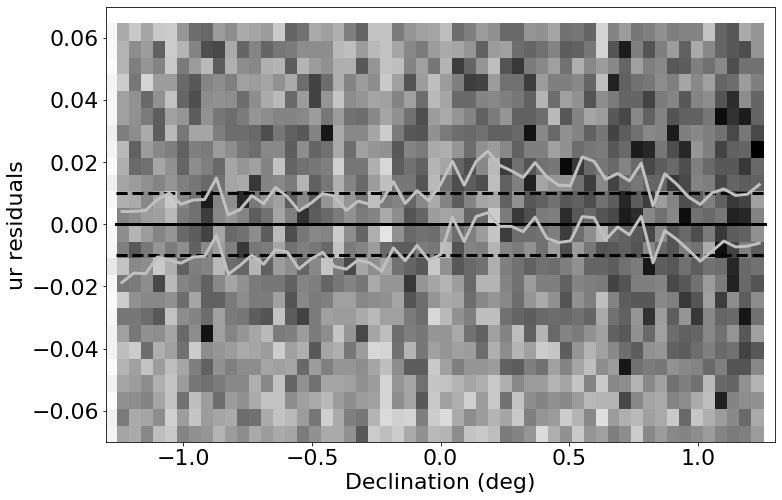

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: -0.007291869735715717 std.dev: 0.056467394334229364
saved plot as: colorResidGaiaColors_ur_rmag.png


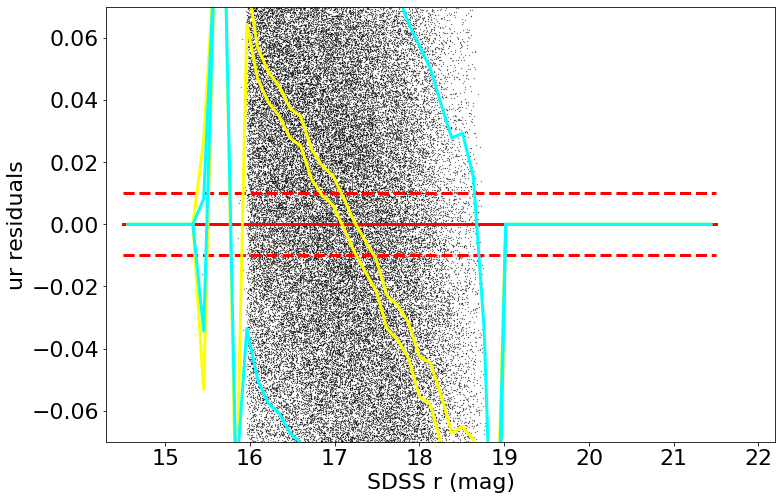

medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: -0.007291869735715717 std.dev: 0.056467394334229364
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


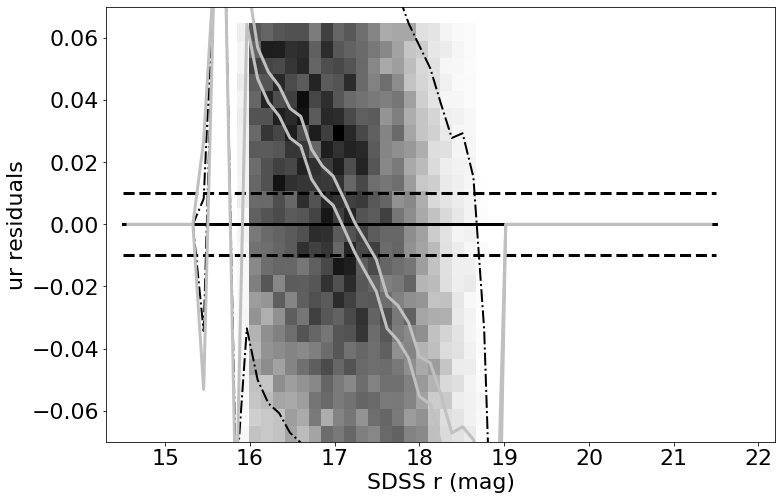

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: -0.01118778533935183 std.dev: 0.05156072622597722
saved plot as: colorResidGaiaColors_ur_Gmag.png


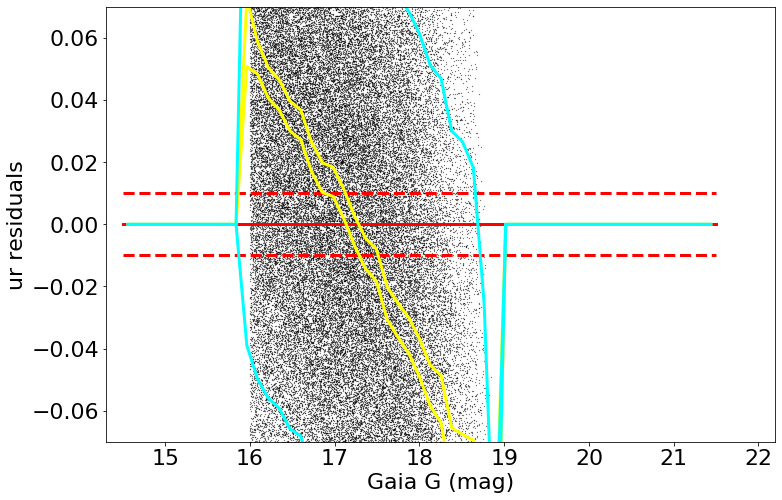

medianAll: 0.0021118438720686417 std.dev.All: 0.10840381347656386
N= 104745 min= -0.29998649291992274 max= 0.2999350280761717
median: -0.01118778533935183 std.dev: 0.05156072622597722
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


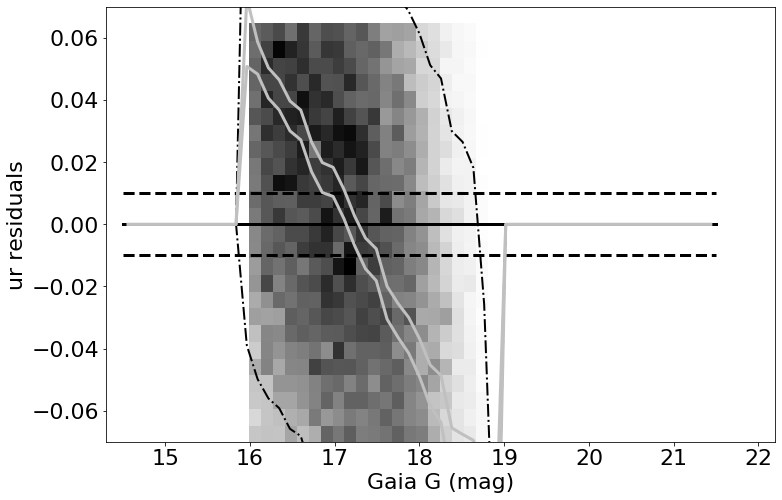

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------


In [37]:
keywords["Ystr"] = 'ur'
doOneColorGaiaBR(matchesRecalibUR, keywords)

=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: 0.0008436378479017015 std.dev: 0.001513810228820754
saved plot as: colorResidGaiaColors_gr_RA.png


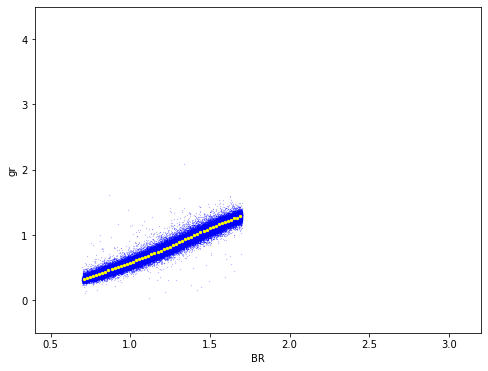

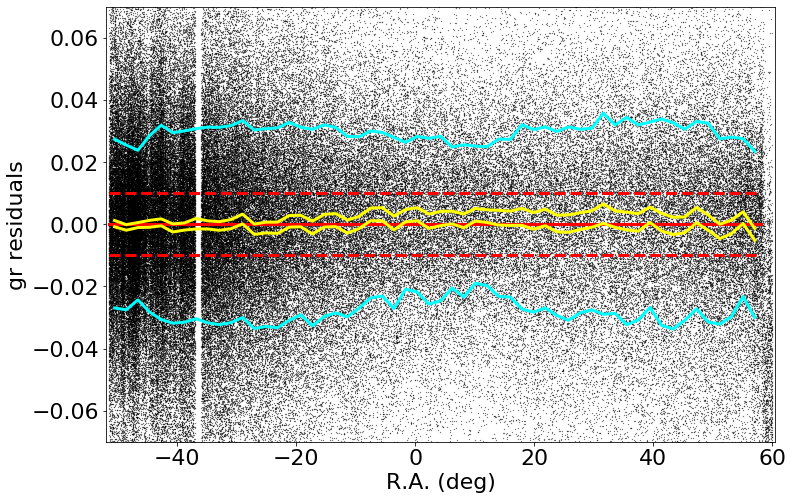

medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: 0.0007931884765619568 std.dev: 0.0015750431219096024
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


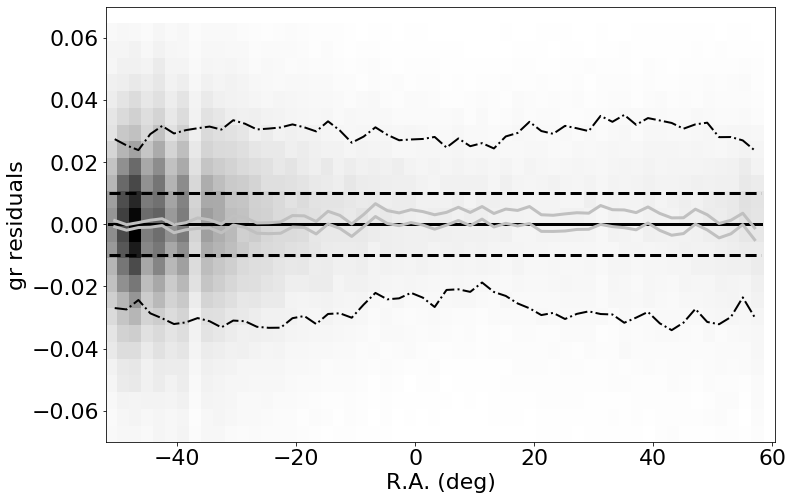

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: 0.0001322185516349217 std.dev: 0.000671623390530593
saved plot as: colorResidGaiaColors_gr_Dec.png


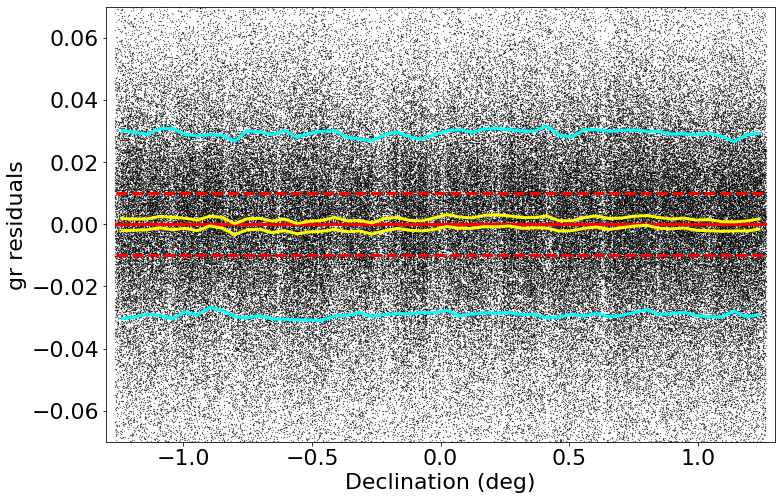

medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: 9.061813354635517e-05 std.dev: 0.0007993151907746031
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


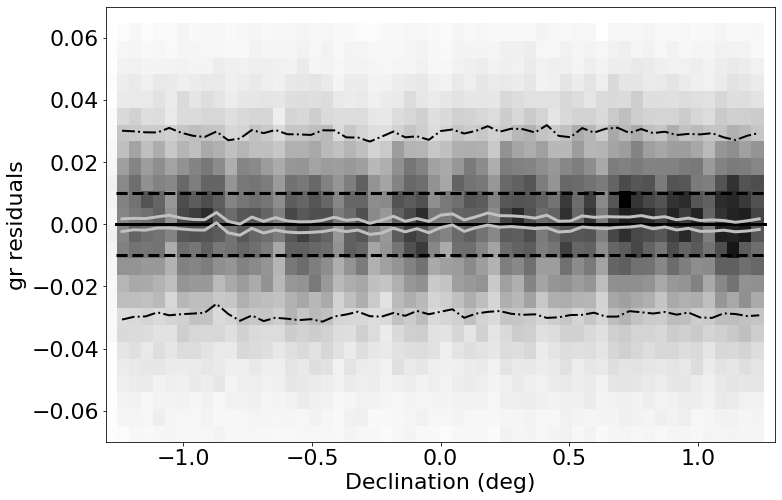

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: 0.0010884124755847907 std.dev: 0.061194371426541556
saved plot as: colorResidGaiaColors_gr_rmag.png


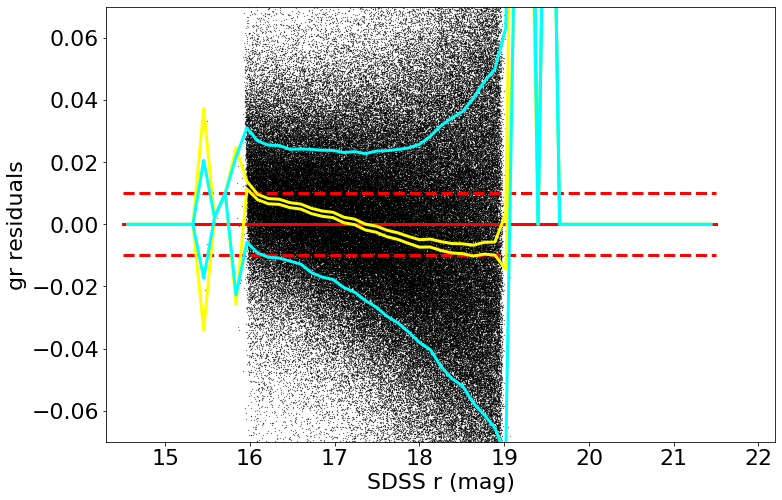

medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: 0.0010884124755847907 std.dev: 0.061194371426541556
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


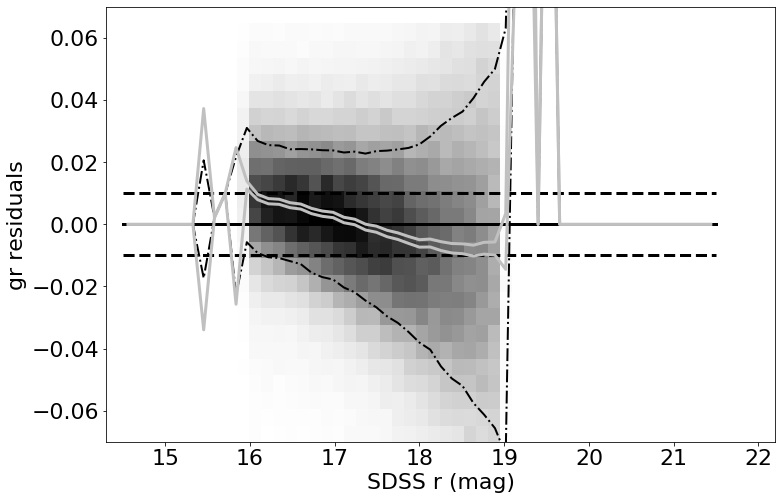

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: -0.0008779861450232129 std.dev: 0.006090270187738172
saved plot as: colorResidGaiaColors_gr_Gmag.png


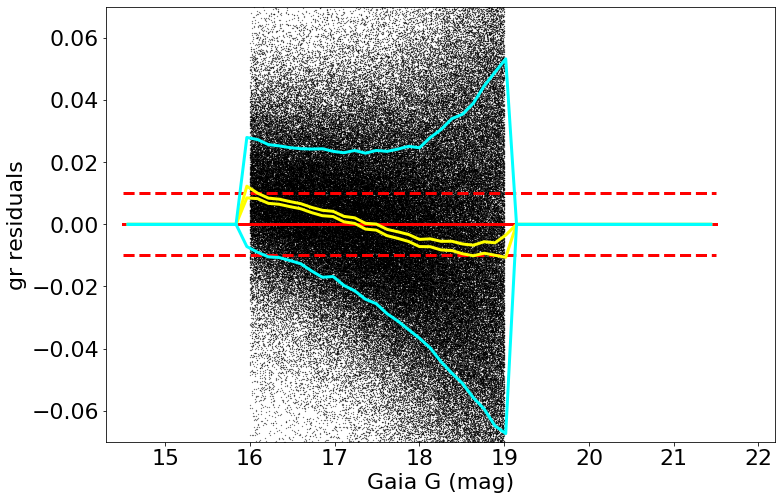

medianAll: 9.475173950174165e-05 std.dev.All: 0.029264894190212908
N= 212792 min= -0.29079507751464506 max= 0.29992460327148673
median: -0.0008779861450232129 std.dev: 0.006090270187738172
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


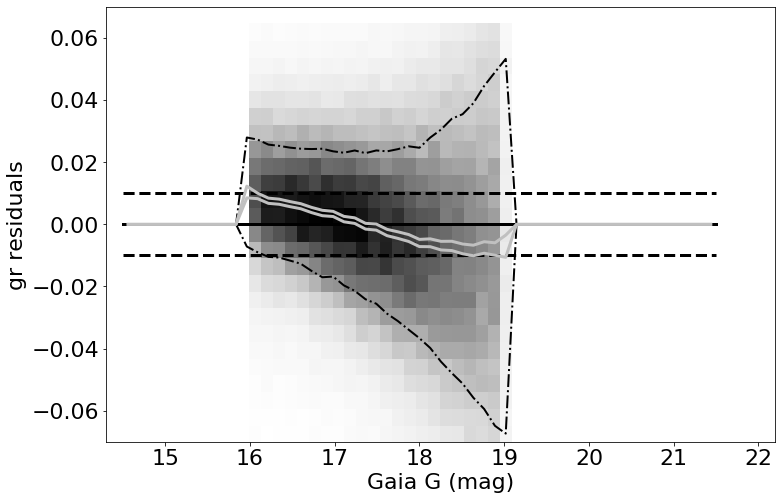

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: 0.0013627372741703767 std.dev: 0.001939980460462993
saved plot as: colorResidGaiaColors_ri_RA.png


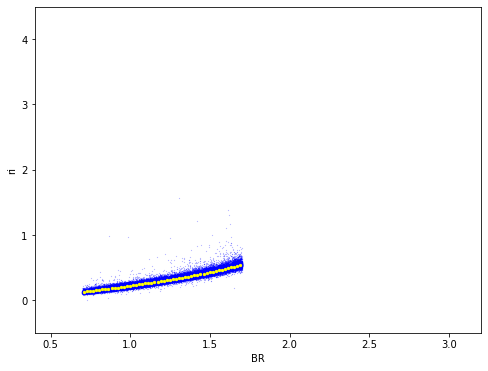

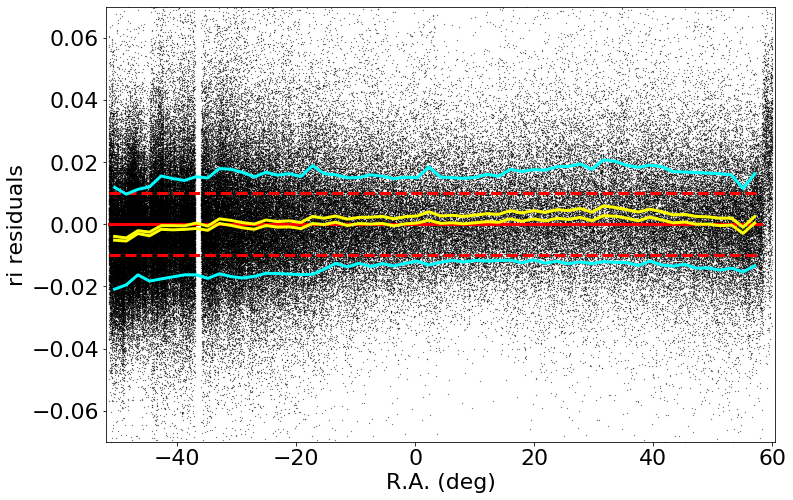

medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: 0.0014891571044954865 std.dev: 0.001961621920158294
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


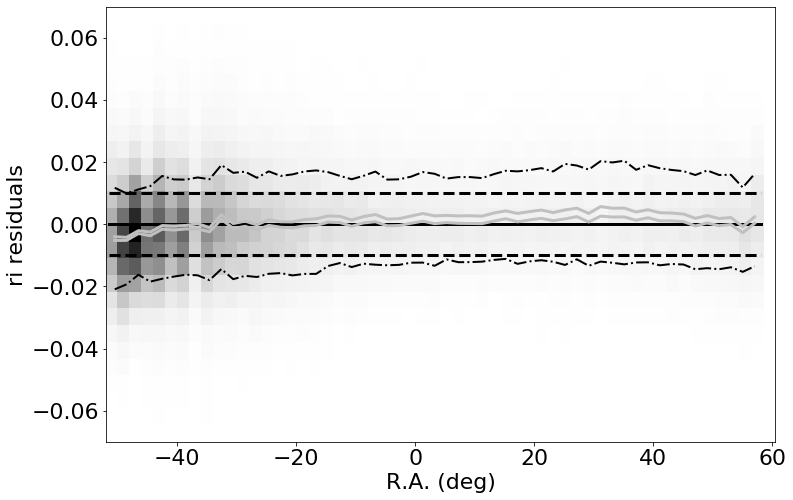

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: -6.932601928726773e-05 std.dev: 0.0005892620512273083
saved plot as: colorResidGaiaColors_ri_Dec.png


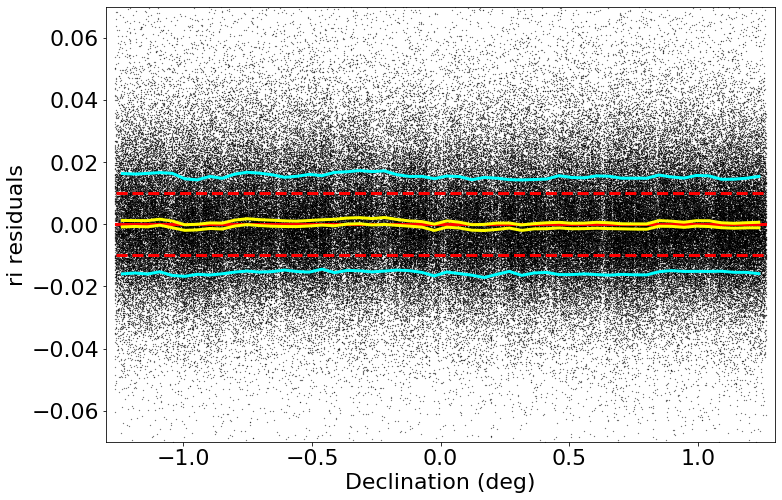

medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: -0.00012379837036177732 std.dev: 0.000673578574162273
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


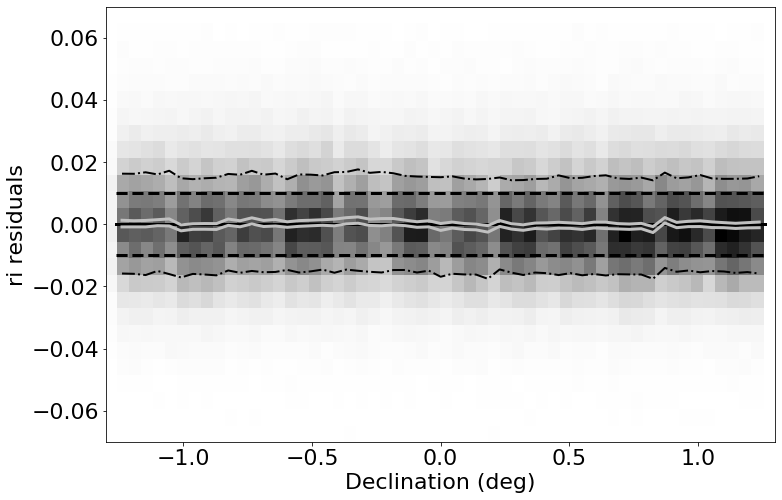

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: 0.00012664566040054837 std.dev: 0.05029398322856493
saved plot as: colorResidGaiaColors_ri_rmag.png


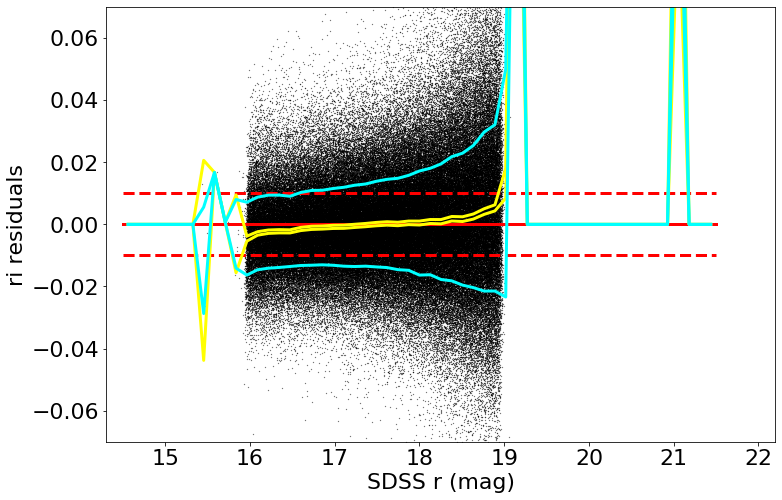

medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: 0.00012664566040054837 std.dev: 0.05029398322856493
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


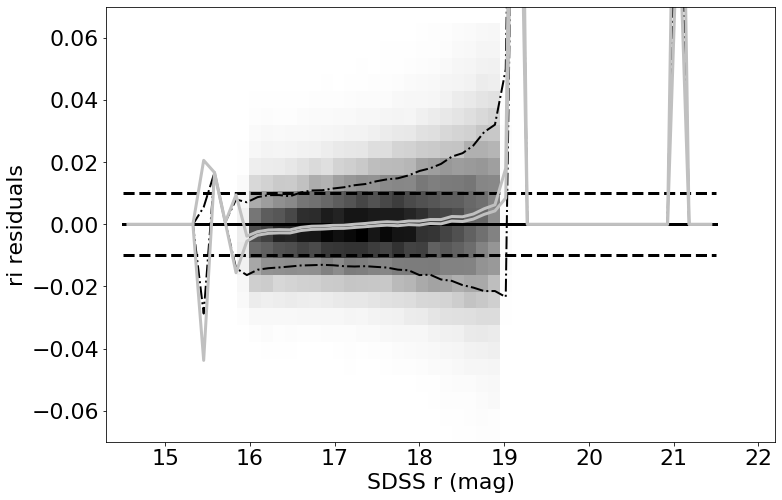

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: 4.140777587771649e-05 std.dev: 0.002156928991684585
saved plot as: colorResidGaiaColors_ri_Gmag.png


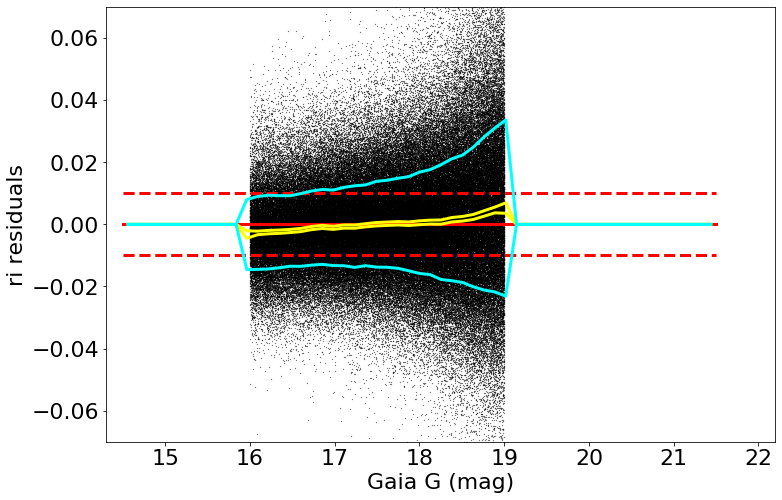

medianAll: -9.444580078034337e-05 std.dev.All: 0.0155668171880737
N= 212858 min= -0.15286122131347601 max= 0.29467585906982363
median: 4.140777587771649e-05 std.dev: 0.002156928991684585
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


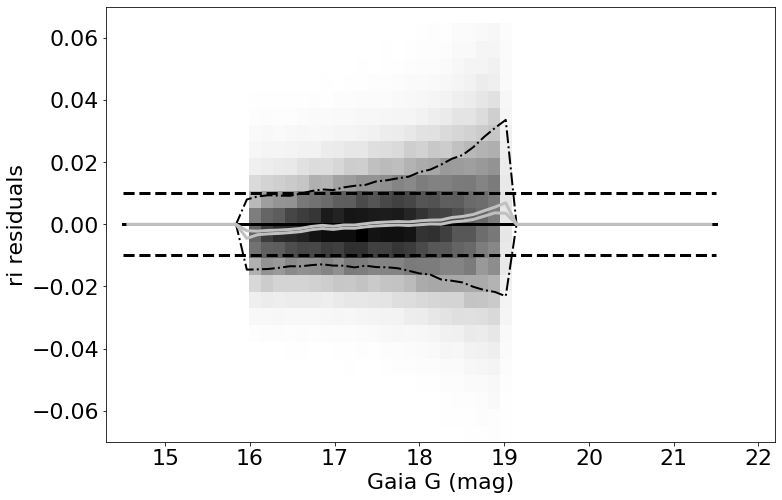

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 0.002354774475096938 std.dev: 0.002903494450501709
saved plot as: colorResidGaiaColors_rz_RA.png


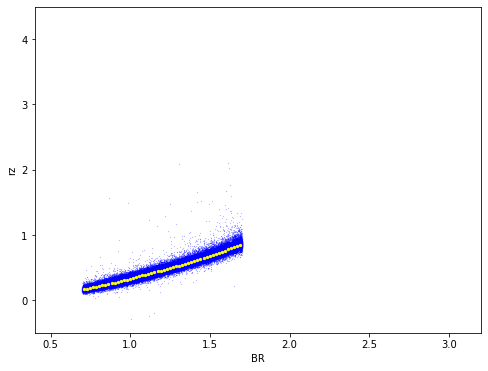

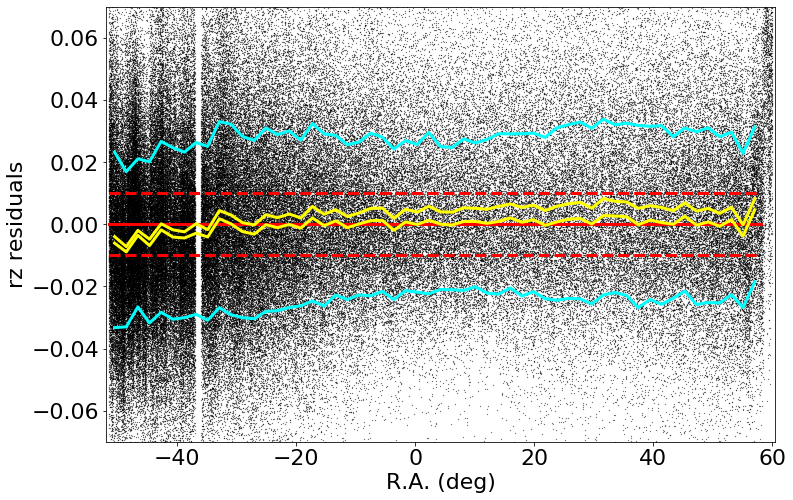

medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 0.0025918212890635173 std.dev: 0.0029450768681091757
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


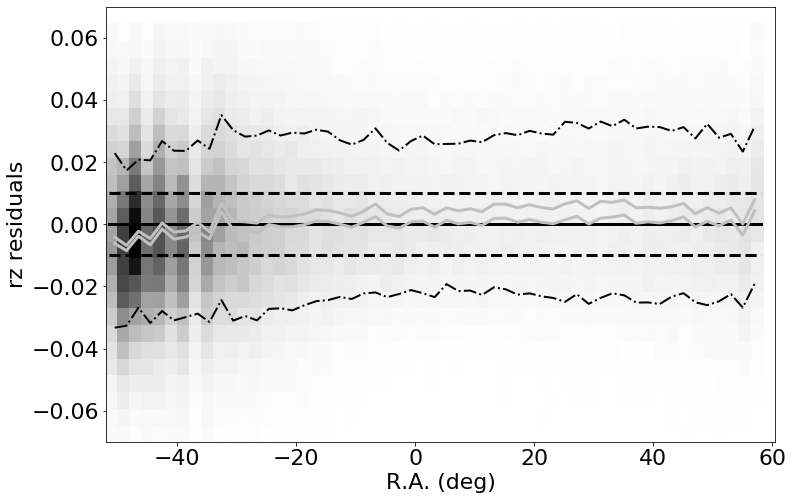

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 1.3836669922023814e-05 std.dev: 0.0015386647151816443
saved plot as: colorResidGaiaColors_rz_Dec.png


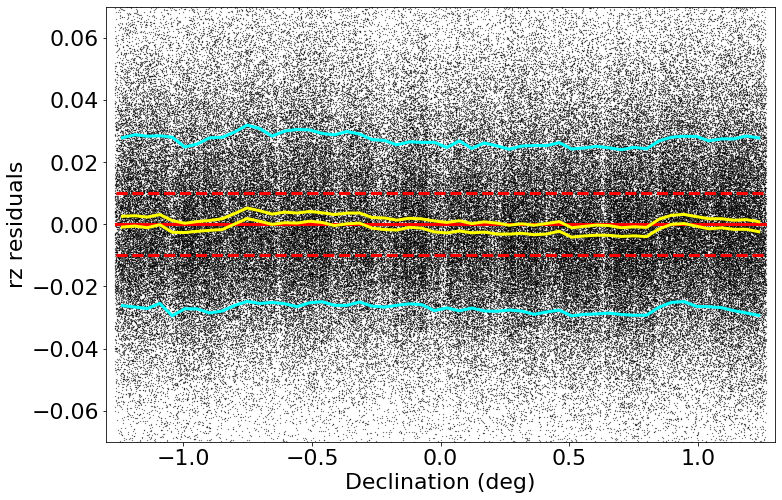

medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 9.491996765220723e-05 std.dev: 0.0016289378438967088
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


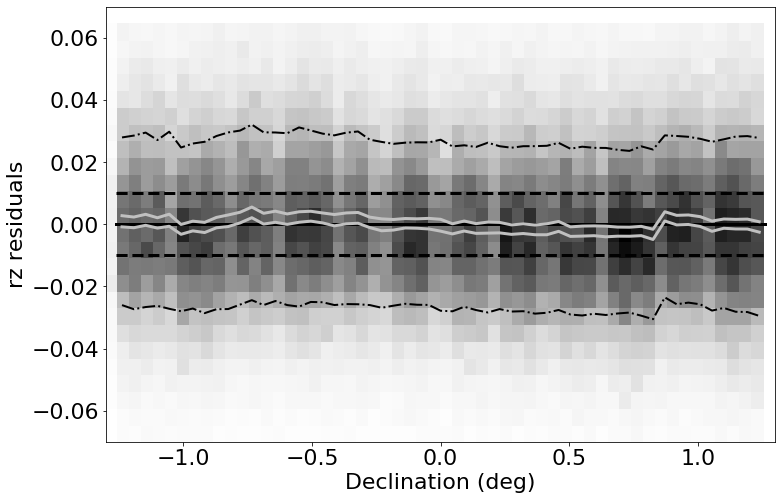

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 0.0009269836425782607 std.dev: 0.008833342672419952
saved plot as: colorResidGaiaColors_rz_rmag.png


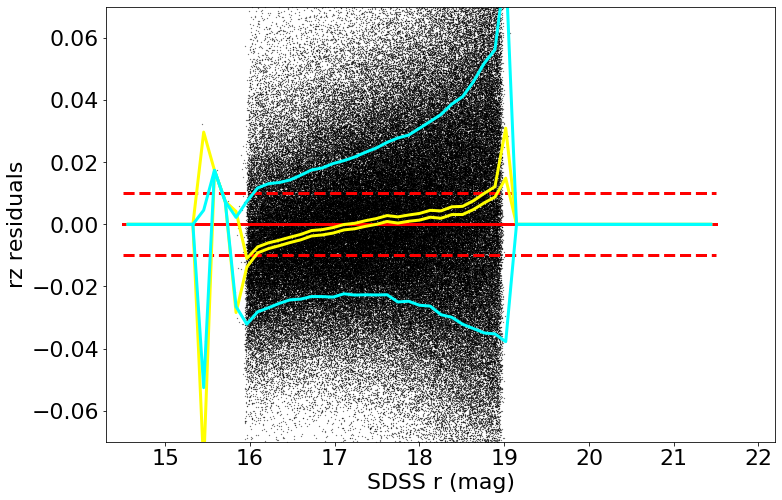

medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 0.0009269836425782607 std.dev: 0.008833342672419952
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


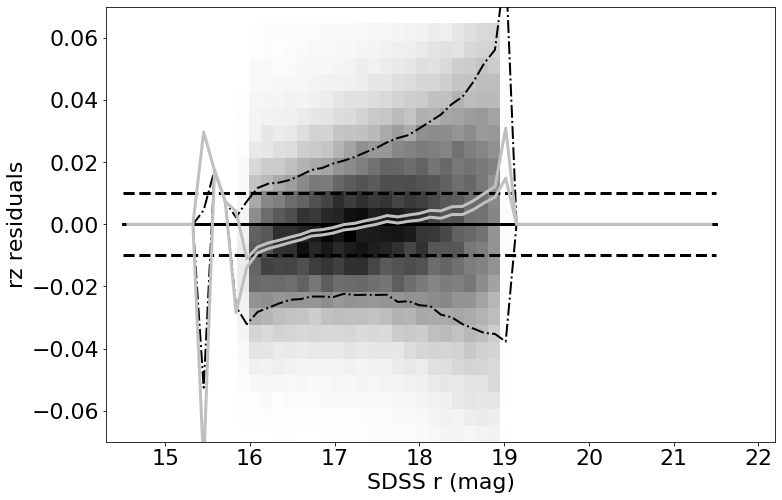

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 0.0006967803955079122 std.dev: 0.005255776433877744
saved plot as: colorResidGaiaColors_rz_Gmag.png


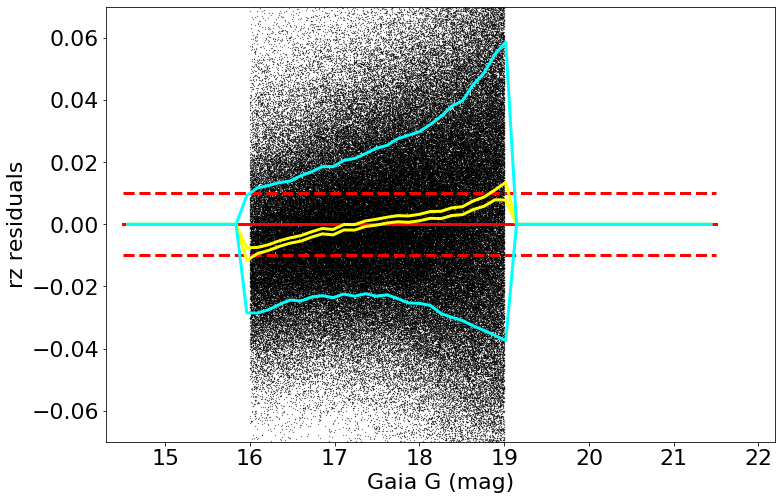

medianAll: 3.753662109723388e-06 std.dev.All: 0.027162419192505553
N= 212769 min= -0.2949640762329101 max= 0.29765556030273566
median: 0.0006967803955079122 std.dev: 0.005255776433877744
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


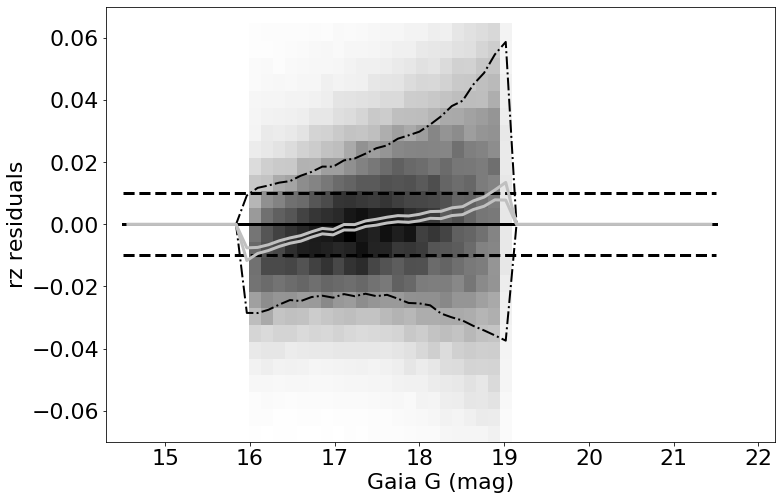

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [38]:
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesRecalib, keywords)

<a id='dataReading'></a>

### Correct v3.3 for offsets in the ugiz bands:
#### ugriz (subtract from v3.3):  -0.004, +0.013, 0.000, -0.011, -0.018

In [39]:
ZIdataDir = "/Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data"
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v3.3.dat"
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

991472

In [40]:
sdssOut = sdssNew[sdssNew['ra']<1000] 
print(np.size(sdssOut))

991472


In [41]:
## apply offset corrections 
offset = {}
offset['u'] = -0.004
offset['g'] = 0.013
offset['r'] = 0.000
offset['i'] = -0.011
offset['z'] = -0.018
for mtype in ('_mMed', '_mMean'):
    for band in ('u', 'g', 'r', 'i', 'z'):
        mstr = band + mtype
        sdssOut[mstr] = sdssOut[mstr] - offset[band]

In [42]:
SSCindexRoot = 'CALIBSTARS_'
outFile = ZIdataDir + "/" + "stripe82calibStars_v3.4_noheader_final.dat"
newSSC = open(outFile,'w')
df = sdssOut
Ngood = 0
for i in range(0, np.size(df)):
    Ngood += 1
    NoldCat = df['calib_fla'][i]
    strNo = f'{Ngood:07}'
    SSCindex = SSCindexRoot + strNo 
    SSCrow = zit.getSSCentry(df, i, aux='')
    zit.SSCentryToOutFileRow(SSCrow, SSCindex, newSSC) 
newSSC.close()
print(Ngood, 'rows in file', outFile)

991472 rows in file /Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data/stripe82calibStars_v3.4_noheader_final.dat


In [43]:
# execute this in /Data dir
# cat header_v3.4.txt stripe82calibStars_v3.4_noheader_final.dat > stripe82calibStars_v3.4.dat